

# M-Adam: An Effective Variation of the Adam Optimization Algorithm

#### Vincenzo Di Gennaro  
Department of Computer Science, City, University of London
#### Eduardo Alonso  
Artificial Intelligence Research Centre (CitAI), City, University of London


### Summary:

We introduce M-Adam (Maximized-Adaptive Moment Estimation), a variation of the popular Adam optimization algorithm. The method is easy to implement, computationally efficient and well suited for problems with large data and parameters space. The method is particularly appropriate when small initial learning rates are optimal. Empirical results demonstrate that the M-Adam algorithm works well in practice and, most of the time, compares favorably to Adam, RMSprop and other stochastic optimization methods. An advantage is that the same intuition/methodology could be used to enhance other optimization algorithms.

### M-Adam Algorithm

Adam is a stochastic optimization algorithm that successfully combines Stochastic Gradient Descent with momentum (using the exponential moving average of the gradients) with RMSprop, by using the squared gradients to scale the learning rate and, at the same time, taking advantage of momentum. 

The main idea of M-Adam is that we can add a “super” momentum when we have a situation where the newly calculated gradients are in the same direction as the current gradients momentum and have also a bigger absolute size. Therefore, we have the advantage created by the momentum which is “jumping” through local minima areas in the loss functions and, at the same time, add acceleration when the newly calculated gradients are in the same direction of the momentum and their absolute size is bigger. In this way, we avoid unnecessary “slowdowns” from the accumulated exponential moving averages of the gradients. 

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns; sns.set()
from scipy.io import loadmat  
from datetime import datetime, date, time
%matplotlib inline

#### Useful functions to be used later for the tasks

In [2]:
import time
from IPython.display import display, clear_output
from scipy.special import expit
from scipy.stats import truncnorm
from util_func import *
from sklearn.metrics import mean_squared_error

#### M-adam: optimization algorithm

### Implementation

In [67]:

class NN_madam():
    
    def __init__(self, size_h_layer, l_rate, l_decay=None, initialization='he', 
                 activation_h='ReLU', activation_o= 'sigmoid', l2_reg=None,
                 dropout = (None, (0,0.25)), bias=1, 
                 optimizer=('momentum',{'beta1':0.9, 'beta2':0.999}),
                plots=True, print_=True):
        """
        X has to have shape (#samples, #features)
        y has to have shape (#samples, 1)
        """
        
        self.size_h_layer = size_h_layer 
        self.activation_h = activation_h
        self.activation_o = activation_o
        self.l_rate = l_rate
        self.l_decay = l_decay
        self.initialization = initialization
        self.l2_reg = l2_reg
        self.dropout = dropout
        self.bias = bias
        self.optimizer = optimizer
        self.print_ = print_
        self.plots = plots
        
        if self.activation_h == 'ReLU': 
            self.activation_function = ReLU
            self.derivative_func = ReLU_derivation
        if self.activation_h == 'LeakyReLU': 
            self.activation_function = LeakyReLU
            self.derivative_func = LReLU_deriv
        if self.activation_h == 'sigmoid': 
            self.activation_function = sigmoid    
            self.derivative_func = sigmoid_der
        
        self.initialize_params()
        
        if self.optimizer[0]=='momentum':
            self.initialize_v()
        if self.optimizer[0]=='RMSprop':
            self.initialize_s()
        if self.optimizer[0]=='adam':
            self.initialize_v()
            self.initialize_s()
        if self.optimizer[0]=='madam':
            self.initialize_v()
            self.initialize_s()
            
        if self.l_decay:
            self.initial_l_rate = self.l_rate
    
    
    #--------------------------------------------------------------------------------------
    def initialize_params(self):
        bias_node = 1 if self.bias else 0
        self.Ws = {}
        self.Bs = {}
        for l in range(1,len(self.size_h_layer)):            
            if self.bias:
                if self.initialization == 'truncnorm':
                    rad = 1 / np.sqrt(self.size_h_layer[l])
                    N = truncated_normal(mean=0, sd=1, low=-rad, upp=rad)
                    self.Ws['W_'+str(l)] = N.rvs((self.size_h_layer[l], self.size_h_layer[l-1]))
                    self.Bs['b_'+str(l)] = N.rvs((self.size_h_layer[l],1))
                if self.initialization == 'he':
                    self.Ws['W_'+str(l)] = np.random.randn(self.size_h_layer[l], self.size_h_layer[l-1]) * np.sqrt(2/self.size_h_layer[l-1])
                    self.Bs['b_'+str(l)] = np.random.randn(self.size_h_layer[l],1) * np.sqrt(2/self.size_h_layer[l-1])
            
            else:
                if self.initialization == 'truncnorm':
                    rad = 1 / np.sqrt(self.size_h_layer[l])
                    N = truncated_normal(mean=0, sd=1, low=-rad, upp=rad)
                    self.Ws['W_'+str(l)] = N.rvs((self.size_h_layer[l], 
                                           self.size_h_layer[l-1]))
                if self.initialization == 'he':
                    self.Ws['W_'+str(l)] = np.random.randn(self.size_h_layer[l], self.size_h_layer[l-1]) * np.sqrt(6/self.size_h_layer[l-1])
                    
    #--------------------------------------------------------------------------------------            
    def initialize_v(self):
        L = len(self.Ws)
        self.v = {}
        for l in range(L):
            self.v['vdW_'+str(l+1)] = np.zeros(self.Ws['W_'+str(l+1)].shape)
            if self.bias:
                self.v['vdB_'+str(l+1)] = np.zeros(self.Bs['b_'+str(l+1)].shape)
    #--------------------------------------------------------------------------------------
    def initialize_s(self):
        L = len(self.Ws)
        self.s = {}
        for l in range(L):
            self.s['sdW_'+str(l+1)] = np.zeros(self.Ws['W_'+str(l+1)].shape)
            if self.bias:
                self.s['sdB_'+str(l+1)] = np.zeros(self.Bs['b_'+str(l+1)].shape)
            
            
            
    #--------------------------------------------------------------------------------------   
    def fwd_prop(self, input_vect, dropout_on=1):
        self.z = {}
        self.a = {}
        self.d = {}
        
        if self.bias: adjust_bias = 1
        else: adjust_bias = 0
            
        for l in range(1,len(self.size_h_layer)):
            
            if l == 1: # input layer 
                    
                self.z['z_'+str(l)] = self.Ws['W_'+str(l)].dot(input_vect.T) + self.Bs['b_'+str(l)]*adjust_bias 
                self.a['a_'+str(l)] = self.activation_function(self.z['z_'+str(l)] )    
                if self.dropout[0] and dropout_on:
                    d = np.random.rand(*self.a['a_'+str(l)].shape)
                    self.d['d_'+str(l)] = 1 * (d > self.dropout[1][l])
                    self.a['a_'+str(l)] *= self.d['d_'+str(l)]
                    self.a['a_'+str(l)] /= (1-self.dropout[1][l])
                    
            elif (l > 1) and (l < len(self.size_h_layer)-1): 
                self.z['z_'+str(l)] = self.Ws['W_'+str(l)].dot(self.a['a_'+str(l-1)]) + self.Bs['b_'+str(l)]*adjust_bias 
                self.a['a_'+str(l)] = self.activation_function(self.z['z_'+str(l)])
                if self.dropout[0] and dropout_on:
                    d = np.random.rand(*self.a['a_'+str(l)].shape)
                    self.d['d_'+str(l)] = 1 * (d > self.dropout[1][l])
                    self.a['a_'+str(l)] *= self.d['d_'+str(l)]
                    self.a['a_'+str(l)] /= (1-self.dropout[1][l])
                    
            elif l == len(self.size_h_layer)-1: 
                if self.activation_o == 'sigmoid':                    
                    self.z['z_'+str(l)] = self.Ws['W_'+str(l)].dot(self.a['a_'+str(l-1)]) + self.Bs['b_'+str(l)]*adjust_bias 
                    self.a['a_'+str(l)] = sigmoid(self.z['z_'+str(l)])
                if self.activation_o == 'softmax':
                    self.z['z_'+str(l)] = self.Ws['W_'+str(l)].dot(self.a['a_'+str(l-1)]) + self.Bs['b_'+str(l)]*adjust_bias 
                    self.a['a_'+str(l)] = softmax(self.z['z_'+str(l)])
                if self.activation_o == 'linear':
                    self.z['z_'+str(l)] = self.Ws['W_'+str(l)].dot(self.a['a_'+str(l-1)]) + self.Bs['b_'+str(l)]*adjust_bias 
                    self.a['a_'+str(l)] = self.z['z_'+str(l)]
                    
        return self.a['a_'+str(l)]
        
        
        
    #--------------------------------------------------------------------------------------
    def J_cost(self, y, output):
        m = y.shape[0]
        if self.activation_o == 'sigmoid':
            y_enc = y.T
        elif self.activation_o == 'softmax':
            #y.shape = (#samples, class)
            y_enc = encode_labels(y, self.size_h_layer[-1])
        elif self.activation_o == 'linear':
            y_enc = y.T
        if self.l2_reg:
            reg = 0
            for k in self.Ws.keys():
                reg = reg + np.sum(np.square(self.Ws[k]))*self.l2_reg/(2*m)               
        else: reg = 0
            
        if self.activation_o == 'sigmoid':
            cost_ = -(1/m) * (y_enc * (np.log(output)) + (1.0 - y_enc) * np.log(1.0 - output)) #+ reg
        if self.activation_o == 'softmax':
            cost_ = -(1/m) * (y_enc * (np.log(output))) #+ reg
        if self.activation_o == 'linear':
            cost_ = 0.5 * (1/m) * np.square(y_enc - output) #+ reg
        
        cost = np.sum(cost_)   
                           
        return cost
    
    
    
    #--------------------------------------------------------------------------------------
    def optimize_grads(self, layer):
        l = layer
        if self.optimizer[0]=='momentum':
            beta1 = self.optimizer[1]['beta1']
            self.v['vdW_'+str(l)] = beta1 * self.v['vdW_'+str(l)] + (1-beta1)*self.dW['dw_'+str(l)]
            if self.bias:
                self.v['vdB_'+str(l)] = beta1*self.v['vdB_'+str(l)] + (1-beta1)*self.dB['db_'+str(l)]
        
        if self.optimizer[0]=='RMSprop':
            beta2 = self.optimizer[1]['beta2']            
            self.s['sdW_'+str(l)] = beta2*self.s['sdW_'+str(l)] + (1-beta2)*np.square(self.dW['dw_'+str(l)])
            if self.bias:
                self.s['sdB_'+str(l)] = beta2*self.s['sdB_'+str(l)] + (1-beta2)*np.square(self.dB['db_'+str(l)])
                
                
        if self.optimizer[0]=='adam':
            beta1 = self.optimizer[1]['beta1']
            beta2 = self.optimizer[1]['beta2']
            self.v['vdW_'+str(l)] = beta1*self.v['vdW_'+str(l)] + (1-beta1)*self.dW['dw_'+str(l)]
            self.s['sdW_'+str(l)] = beta2*self.s['sdW_'+str(l)] + (1-beta2)*np.square(self.dW['dw_'+str(l)])
            #self.v['vdW_'+str(l)] /= (1-np.power(beta1,self.t))
            #self.s['sdW_'+str(l)] /= (1-np.power(beta2,self.t))            
            
            if self.bias:
                self.v['vdB_'+str(l)] = beta1*self.v['vdB_'+str(l)] + (1-beta1)*self.dB['db_'+str(l)]
                self.s['sdB_'+str(l)] = beta2*self.s['sdB_'+str(l)] + (1-beta2)*np.square(self.dB['db_'+str(l)])
        
        if self.optimizer[0]=='madam':
            beta1 = self.optimizer[1]['beta1']
            beta2 = self.optimizer[1]['beta2']
            self.v['vdW_'+str(l)] = (beta1*self.v['vdW_'+str(l)] + (1-beta1)*self.dW['dw_'+str(l)])
            self.s['sdW_'+str(l)] = beta2*self.s['sdW_'+str(l)] + (1-beta2)*np.square(self.dW['dw_'+str(l)])
            #self.v['vdW_'+str(l)] /= (1-np.power(beta1,self.t))
            #self.s['sdW_'+str(l)] /= (1-np.power(beta2,self.t)) 
            if self.bias:
                self.v['vdB_'+str(l)] = beta1*self.v['vdB_'+str(l)] + (1-beta1)*self.dB['db_'+str(l)]
                self.s['sdB_'+str(l)] = beta2*self.s['sdB_'+str(l)] + (1-beta2)*np.square(self.dB['db_'+str(l)])
         
        
                
    #--------------------------------------------------------------------------------------            
    def back_prop(self, input_vect, y):
       
        assert(y.shape[1]==1)
        
        m = input_vect.shape[0]
        
        self.sigmas = {}
        self.dZ = {}
        self.dW = {}
        self.dB = {}
        
        if self.size_h_layer[-1]>1:
            y = encode_labels(y,self.size_h_layer[-1]) 
        else: y = y.T
            
        # last layer
        output = self.fwd_prop(input_vect)        
        l = len(self.size_h_layer)-1  
        
        
        #last layer error
        self.sigmas['sigma_'+str(l)] = output - y
        if self.l2_reg:
            add_reg = self.l2_reg/m * self.Ws['W_'+str(l)]
        else: add_reg = 0
            
        #last weights grads
        self.dW['dw_'+str(l)] = (1 / m) * np.dot(self.sigmas['sigma_'+str(l)], self.a['a_'+str(l-1)].T) + add_reg            
        
        if self.bias:
            self.dB['db_'+str(l)] = (1 / m) * np.sum(self.sigmas['sigma_'+str(l)], axis=1, keepdims=True) 
            
        if self.optimizer[0] != None:
            self.optimize_grads(layer=l)
        
                
        # hidden layer back prop
        for l in reversed(range(1, len(self.size_h_layer)-1)): #reverse loop through layer excluding the 1st
            if self.dropout[0]:
                drop_adj = self.Ws['W_'+str(l+1)].T.dot(self.sigmas['sigma_'+str(l+1)]) * self.d['d_'+str(l)]
                #inverted dropout adjustments
                drop_adj /= (1-self.dropout[1][l])
                self.sigmas['sigma_'+str(l)] = drop_adj * self.derivative_func(self.z['z_'+str(l)])
            else:
                self.sigmas['sigma_'+str(l)] = self.Ws['W_'+str(l+1)].T.dot(self.sigmas['sigma_'+str(l+1)]) * self.derivative_func(self.z['z_'+str(l)])                        
            if self.l2_reg:
                add_reg = self.l2_reg/m * self.Ws['W_'+str(l)]
            else: add_reg = 0 
            #gradients
            if l == 1:                
                self.dW['dw_'+str(l)] = (1 / m) * np.dot(self.sigmas['sigma_'+str(l)], input_vect) + add_reg
            else:
                self.dW['dw_'+str(l)] = (1 / m) * np.dot(self.sigmas['sigma_'+str(l)], self.a['a_'+str(l-1)].T) + add_reg 
            
            if self.bias:
                self.dB['db_'+str(l)] = (1 / m) * np.sum(self.sigmas['sigma_'+str(l)], axis=1, keepdims=True)
                
            if self.optimizer[0] != None:
                self.optimize_grads(layer=l)
            
            
            
    #--------------------------------------------------------------------------------------    
    def updates(self):
        for l in range(1,len(self.Ws)+1):
            if self.optimizer[0] == 'momentum':
                self.Ws['W_'+str(l)] -= self.l_rate * self.v['vdW_'+str(l)]#/(1-self.optimizer[1]['beta1']**t)
                self.Bs['b_'+str(l)] -= self.l_rate * self.v['vdB_'+str(l)]#/(1-self.optimizer[1]['beta1']**t)
            if self.optimizer[0] == 'RMSprop':
                self.Ws['W_'+str(l)] -= self.l_rate * self.dW['dw_'+str(l)] / (np.sqrt(self.s['sdW_'+str(l)]) + 1e-07)#/(1-self.optimizer[1]['beta2']**t))
                self.Bs['b_'+str(l)] -= self.l_rate * self.dB['db_'+str(l)] / (np.sqrt(self.s['sdB_'+str(l)]) + 1e-07)#/(1-self.optimizer[1]['beta2']**t))
            if self.optimizer[0] == 'adam':              
                self.Ws['W_'+str(l)] -= self.l_rate * self.v['vdW_'+str(l)] / (np.sqrt(self.s['sdW_'+str(l)]) + 1e-07)# /(1-self.optimizer[1]['beta1']**t)
                self.Bs['b_'+str(l)] -= self.l_rate * self.v['vdB_'+str(l)] / (np.sqrt(self.s['sdB_'+str(l)]) + 1e-07)# /(1-self.optimizer[1]['beta1']**t)
    
    #----------------------------------------------------#
    #--------------- M-Adam Adjustments -----------------#
    #----------------------------------------------------#
    
            if self.optimizer[0] == 'madam':
                # madam momentum adjustment for the update of the weights
                mask = (np.sign(self.dW['dw_'+str(l)])==np.sign(self.v['vdW_'+str(l)])) & \
                       (np.abs(self.dW['dw_'+str(l)]) > np.abs(self.v['vdW_'+str(l)]))
                    
                max_grads = np.where(mask==False,self.v['vdW_'+str(l)],self.dW['dw_'+str(l)])                    
                
                self.Ws['W_'+str(l)] -= self.l_rate * max_grads / (np.sqrt(self.s['sdW_'+str(l)]) + 1e-07)
                self.Bs['b_'+str(l)] -= self.l_rate * self.dB['db_'+str(l)] / (np.sqrt(self.s['sdB_'+str(l)]) + 1e-07)              
                
            else:
                self.Ws['W_'+str(l)] -= self.l_rate * self.dW['dw_'+str(l)] 
                self.Bs['b_'+str(l)] -= self.l_rate * self.dB['db_'+str(l)]
                
                
    
    #--------------------------------------------------------------------------------------
    def predict(self,X):
        pred = self.fwd_prop(X, dropout_on=0)
        if self.activation_o=='softmax':
            pred = np.argmax(pred, axis=0).reshape(-1,1)
        if self.activation_o=='sigmoid':
            pred = np.where(pred>0.5,1,0).reshape(-1,1)
        if self.activation_o=='linear':
            pred = pred.reshape(-1,1)
        else:
            pred = pred
        return pred
    
    
    
    #--------------------------------------------------------------------------------------
    def train_nn(self, X_train, y_train, epochs=10, nr_shuffles=1, batch_size=32, cval=None, early_stopping=(None, {'epochs':20}), grads_stopping= False):
            
        for r in range(nr_shuffles):    
            self.t = 1.0
            m = X_train.shape[0]
            assert(y_train.shape[1]==1)
            assert(X_train.shape[0] == y_train.shape[0])

            if cval!=None:   
                #reshuffle training set
                data = np.hstack([X_train, y_train])
                np.random.shuffle(data)

                val_data = np.round(cval*m,0).astype(int)
                X_val = data[:val_data,:-1]
                y_val = data[:val_data,-1].reshape(-1,1).astype(int)

                X_train_ = data[val_data:,:-1]
                y_train_ = data[val_data:,-1].reshape(-1,1).astype(int)

            else:
                X_train_ = X_train.copy()
                y_train_ = y_train.copy()

            validation_accuracy = []
            training_accuracy = []
            validation_cost = []
            self.training_cost = []
            self.tr_batch_cost = []
            self.val_batch_cost = []
            self.gradient_sizes = []

            #initial cost and accuracy
            train_output = self.fwd_prop(input_vect=X_train_)
            initial_cost = np.round(self.J_cost(y=y_train_, output=train_output),4)

            if self.activation_o == 'softmax':
                initial_acc = np.round((np.argmax(train_output, axis=0).reshape(-1,1)==y_train_).mean(),4)
            elif self.activation_o =='sigmoid':
                initial_acc = (np.where(train_output>0.5,1,0) == y_train_.reshape(1,-1)).mean()
            elif self.activation_o =='linear':
                initial_acc = np.sqrt(np.square(train_output - y_train_.reshape(1,-1))).sum()/y_train_.mean()
            else:
                pass
            if self.print_!=None:
                print('initial_cost: ',initial_cost, ' initial_acc: ',initial_acc)

            # epochs run
            for e in range(epochs):
                m = X_train_.shape[0]
                data = np.hstack([X_train_, y_train_])
                np.random.shuffle(data)
                X_train_ = data[:,:-1]
                y_train_ = data[:,-1].reshape(-1,1).astype(int)

                if batch_size!= None:
                    n_batches = m // batch_size
                else:
                    n_batches = 1 
                    batch_size = m
                batches = np.array_split(np.arange(m), n_batches)


                for i, b in enumerate(batches):
                    X_ = X_train_[b,:] 
                    y_ = y_train_[b,:]  
                    self.back_prop(input_vect=X_, y=y_)
                    self.updates()
                    self.t +=1
                    wait = "progress: " + str(np.round(np.round(i/len(batches),2)*100,0))+'%'
                    print (wait, end="\r")
                    
                    if i%25==0:
                        train_output = self.fwd_prop(input_vect=X_, dropout_on=0)
                        self.train_cost = np.round(self.J_cost(y=y_, output=train_output),4)
                        self.tr_batch_cost.append(self.train_cost)
                        if cval!= None:
                            val_samples = np.random.choice(X_val.shape[0],np.minimum(batch_size,X_val.shape[0]))
                            val_output = self.fwd_prop(input_vect=X_val[val_samples], dropout_on=0)
                            val_cost = np.round(self.J_cost(y=y_val[val_samples], output=val_output),4)
                            self.val_batch_cost.append(val_cost)

                if batch_size==None or batch_size==m:
                    train_output = self.fwd_prop(input_vect=X_, dropout_on=0)
                    self.train_cost = np.round(self.J_cost(y=y_, output=train_output),6)
                    self.tr_batch_cost.append(train_cost)
                    if cval!= None:
                        val_samples = np.random.choice(X_val.shape[0],np.minimum(batch_size,X_val.shape[0]))
                        val_output = self.fwd_prop(input_vect=X_val[val_samples], dropout_on=0)
                        val_cost = np.round(self.J_cost(y=y_val[val_samples], output=val_output),4)
                        self.val_batch_cost.append(val_cost)


                # update learning rate with decay
                if self.l_decay:
                    self.l_rate = self.initial_l_rate * self.l_decay**e

                # calculating improvements at the end of each epoch
                train_output = self.fwd_prop(input_vect=X_train_, dropout_on=0)
                if self.activation_o == 'softmax':    
                    train_acc = np.round((np.argmax(train_output, axis=0).reshape(-1,1)==y_train_).mean(),4)
                elif self.activation_o == 'sigmoid':
                    train_acc = np.round((np.where(train_output>0.5,1,0) == y_train_.T).mean(),4)
                elif self.activation_o =='linear':
                    train_acc = np.sqrt(np.square(train_output - y_train_.reshape(1,-1))).mean()/y_train_.mean()
                training_accuracy.append(train_acc)

                if cval: 
                    val_output = self.fwd_prop(input_vect=X_val, dropout_on=0) # switch off the dropout in validation test    
                if cval:    
                    if self.activation_o == 'softmax':
                        val_acc = np.round((np.argmax(val_output, axis=0).reshape(-1,1)==y_val).mean(),4)   
                    elif self.activation_o == 'sigmoid':
                        val_acc = np.round((np.where(val_output>0.5,1,0) == y_val.T).mean(),4)
                    elif self.activation_o == 'linear':
                        val_acc = np.sqrt(np.square(val_output - y_val.reshape(1,-1))).sum()/y_val.mean()
                else: val_cost = 0; val_acc = 0
                validation_accuracy.append(val_acc)  

                self.train_cost = np.round(np.array(self.tr_batch_cost)[-n_batches:].mean(),6)
                self.training_cost.append(self.train_cost)
                if cval!= None:
                    val_cost = np.round(np.array(self.val_batch_cost)[-n_batches:].mean(),4)
                    validation_cost.append(val_cost)

                # checking average gradients sizes during training
                grads_ = 0
                for d in self.dW:
                    grads_ += np.abs(self.dW[d]).sum()/np.array(self.dW[d].shape).prod()
                self.gradient_sizes.append(grads_)

                if self.print_!=None:                
                    print('epoch_'+str(e),' --> cost_train: ', self.train_cost,'train_acc: ', train_acc, ' -- cost_val: ', val_cost,' val_acc: ', val_acc, ' ==> grads: ', np.round(grads_,5))


                #early stopping conditions
                if early_stopping[0] and e > early_stopping[1]['epochs']:
                    epochs_chk = early_stopping[1]['epochs']
                    cost_regr = np.vstack([np.ones(epochs_chk),np.arange(epochs_chk)]).T
                    try:
                        coeff_tr = np.linalg.inv(cost_regr.T@cost_regr)@cost_regr.T@np.array(training_cost[-epochs_chk:]).reshape(-1,1)
                        if early_stopping[0] == 'hard':
                            coeff_test = np.linalg.inv(cost_regr.T@cost_regr)@cost_regr.T@np.array(validation_cost[-epochs_chk:]).reshape(-1,1)
                        else: coeff_test = (0,-1)
                        print('training_cost_slope: ',coeff_tr[1], ' --- val_cost_slope: ', coeff_test[1])
                        if coeff_tr[1]> -1e-5 or coeff_test[1]> -1e-5:
                            break                    
                    except:pass  

                if grads_stopping:
                    if np.array(self.gradient_sizes)[-5:].mean() < 1e-4:
                        break
            
            # before the reshuffle reset the initial rate to the latest one used
            self.initial_l_rate = self.l_rate
                
            
            if self.plots:
                plt.figure(figsize=(14,4))
                plt.subplot(1,2,1)
                plt.plot(self.tr_batch_cost)
                plt.plot(self.val_batch_cost,alpha=0.5)
                plt.legend(['training_cost', 'validation_cost'])
                plt.subplot(1,2,2)
                plt.plot(training_accuracy)
                plt.plot(validation_accuracy,alpha=0.5)
                plt.legend(['training_accuracy', 'validation_accuracy'])
                plt.show()
                if cval: 
                    plt.figure(figsize=(14,4))
                    if self.activation_o == 'softmax':
                        plot_conf_matrix(true_y=y_val, pred=np.argmax(val_output, axis=0))     
                    elif self.activation_o == 'sigmoid':
                        plot_conf_matrix(true_y=y_val.reshape(val_output.shape), pred=np.where(val_output>0.5,1,0))


        

## Experiments 

- We empirically show that the M-Adam algorithm outperforms Adam when used to update the parameters of a Fully Connected Neural Network. The experiments were run on the following well-known datasets: MNIST (train set, 60k samples), CIFAR10 (test set, 10k samples) and SVHN (test set, 26032 samples).

- As we will see below, M-Adam managed to converge faster most of the times. We excluded dropout from the experiments to reduce noise and to an objective comparison between the two optimization algorithms. Nonetheless, similar results have been obtained when dropout was added.  

### MNIST dataset

In [4]:
from keras.datasets import mnist

Using TensorFlow backend.


In [5]:
from sklearn.preprocessing import StandardScaler

# flatten the dimension of the sample to feed into the nn
X__ = mnist.load_data()[0][0].reshape(-1,784)
y__ = mnist.load_data()[0][1].reshape(-1,1)

# let's scale the dataset
sc = StandardScaler()
X__ = sc.fit_transform(X__)

print('nro_classes: ',len(np.unique(y__)))
print('shape X: ', X__.shape)

/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


nro_classes:  10
shape X:  (60000, 784)


/anaconda3/lib/python3.6/site-packages/sklearn/utils/validation.py:595: DataConversionWarning: Data with input dtype uint8 was converted to float64 by StandardScaler.
  warnings.warn(msg, DataConversionWarning)


### M-Adam testing on MNIST

#### Network Structure:

- 2 layers of 256 neurons each
- activation: ReLU
- initialization: truncnorm
- learning rate: 1e-4
- l_rate decay: 0.95
- optimizer: M-Adam {beta1=0.9, beta2=0.999)}
- epochs: 5
- batch_size; 128


initial_cost:  2.621  initial_acc:  0.1025
epoch_0  --> cost_train:  0.165837 train_acc:  0.9755  -- cost_val:  0  val_acc:  0  ==> grads:  0.00325
epoch_1  --> cost_train:  0.108224 train_acc:  0.9864  -- cost_val:  0  val_acc:  0  ==> grads:  0.00457
epoch_2  --> cost_train:  0.083121 train_acc:  0.9921  -- cost_val:  0  val_acc:  0  ==> grads:  0.00371
epoch_3  --> cost_train:  0.068449 train_acc:  0.9953  -- cost_val:  0  val_acc:  0  ==> grads:  0.00261
epoch_4  --> cost_train:  0.058042 train_acc:  0.9966  -- cost_val:  0  val_acc:  0  ==> grads:  0.00142


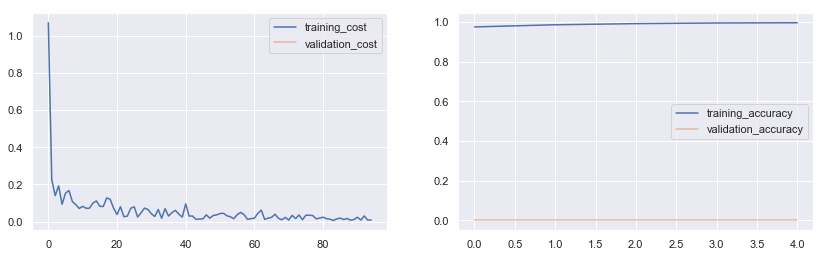

initial_cost:  2.6007  initial_acc:  0.0885
epoch_0  --> cost_train:  0.143358 train_acc:  0.9751  -- cost_val:  0  val_acc:  0  ==> grads:  0.00811
epoch_1  --> cost_train:  0.094016 train_acc:  0.9854  -- cost_val:  0  val_acc:  0  ==> grads:  0.00263
epoch_2  --> cost_train:  0.073551 train_acc:  0.9916  -- cost_val:  0  val_acc:  0  ==> grads:  0.00391
epoch_3  --> cost_train:  0.06027 train_acc:  0.9939  -- cost_val:  0  val_acc:  0  ==> grads:  0.00165
epoch_4  --> cost_train:  0.051618 train_acc:  0.9969  -- cost_val:  0  val_acc:  0  ==> grads:  0.00366


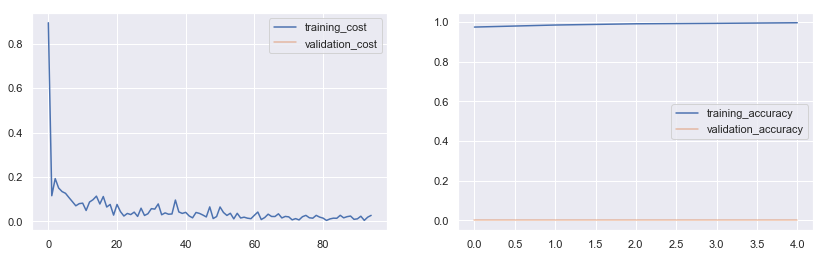

initial_cost:  2.5778  initial_acc:  0.0925
epoch_0  --> cost_train:  0.145068 train_acc:  0.9757  -- cost_val:  0  val_acc:  0  ==> grads:  0.00397
epoch_1  --> cost_train:  0.099729 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.0037
epoch_2  --> cost_train:  0.080607 train_acc:  0.9912  -- cost_val:  0  val_acc:  0  ==> grads:  0.00297
epoch_3  --> cost_train:  0.066178 train_acc:  0.9944  -- cost_val:  0  val_acc:  0  ==> grads:  0.00282
epoch_4  --> cost_train:  0.056202 train_acc:  0.9968  -- cost_val:  0  val_acc:  0  ==> grads:  0.00133


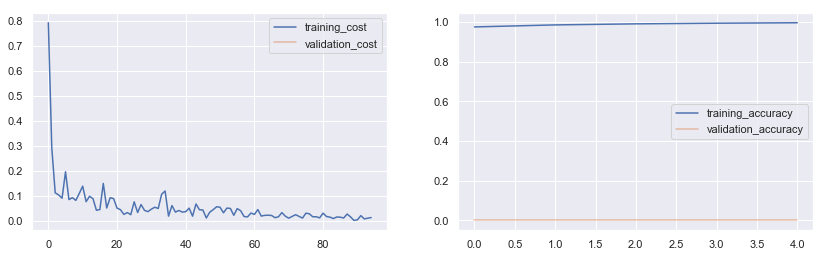

initial_cost:  2.5089  initial_acc:  0.0891
epoch_0  --> cost_train:  0.154184 train_acc:  0.9748  -- cost_val:  0  val_acc:  0  ==> grads:  0.00395
epoch_1  --> cost_train:  0.108534 train_acc:  0.9855  -- cost_val:  0  val_acc:  0  ==> grads:  0.0018
epoch_2  --> cost_train:  0.084926 train_acc:  0.9905  -- cost_val:  0  val_acc:  0  ==> grads:  0.00411
epoch_3  --> cost_train:  0.069866 train_acc:  0.9947  -- cost_val:  0  val_acc:  0  ==> grads:  0.00393
epoch_4  --> cost_train:  0.058637 train_acc:  0.997  -- cost_val:  0  val_acc:  0  ==> grads:  0.00211


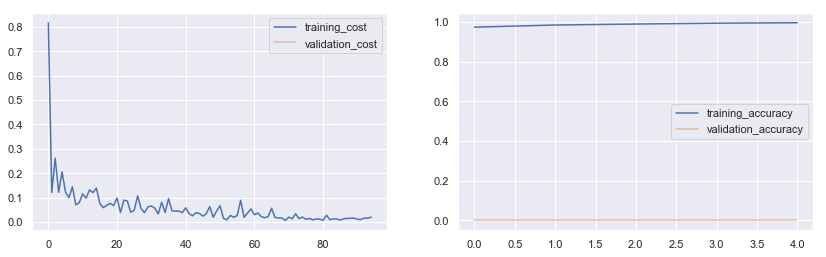

initial_cost:  2.6735  initial_acc:  0.0514
epoch_0  --> cost_train:  0.182805 train_acc:  0.9735  -- cost_val:  0  val_acc:  0  ==> grads:  0.01548
epoch_1  --> cost_train:  0.119079 train_acc:  0.9867  -- cost_val:  0  val_acc:  0  ==> grads:  0.00168
epoch_2  --> cost_train:  0.092639 train_acc:  0.9919  -- cost_val:  0  val_acc:  0  ==> grads:  0.00299
epoch_3  --> cost_train:  0.075972 train_acc:  0.9946  -- cost_val:  0  val_acc:  0  ==> grads:  0.00347
epoch_4  --> cost_train:  0.064996 train_acc:  0.9971  -- cost_val:  0  val_acc:  0  ==> grads:  0.00311


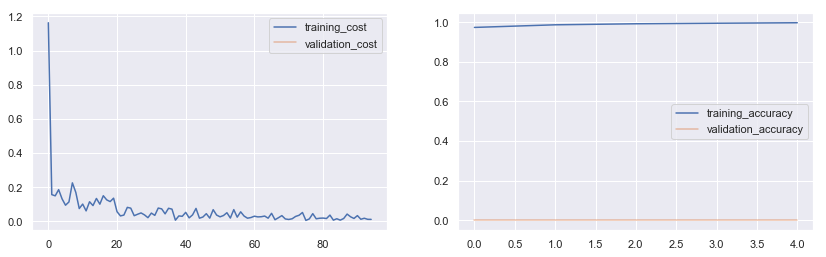

initial_cost:  2.5115  initial_acc:  0.09
epoch_0  --> cost_train:  0.153453 train_acc:  0.9754  -- cost_val:  0  val_acc:  0  ==> grads:  0.00702
epoch_1  --> cost_train:  0.102753 train_acc:  0.9858  -- cost_val:  0  val_acc:  0  ==> grads:  0.00504
epoch_2  --> cost_train:  0.080007 train_acc:  0.9918  -- cost_val:  0  val_acc:  0  ==> grads:  0.00305
epoch_3  --> cost_train:  0.066186 train_acc:  0.9952  -- cost_val:  0  val_acc:  0  ==> grads:  0.00172
epoch_4  --> cost_train:  0.056194 train_acc:  0.9966  -- cost_val:  0  val_acc:  0  ==> grads:  0.00141


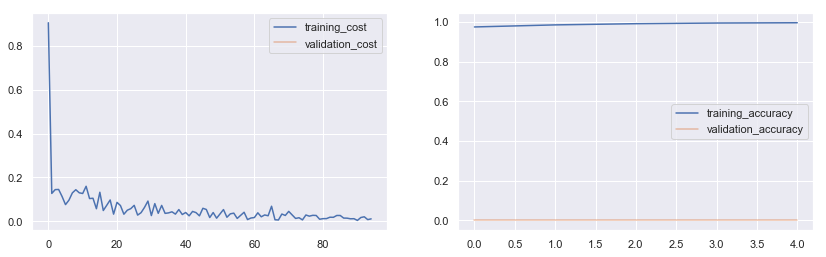

initial_cost:  2.6385  initial_acc:  0.089
epoch_0  --> cost_train:  0.150542 train_acc:  0.9747  -- cost_val:  0  val_acc:  0  ==> grads:  0.00724
epoch_1  --> cost_train:  0.1092 train_acc:  0.9864  -- cost_val:  0  val_acc:  0  ==> grads:  0.00198
epoch_2  --> cost_train:  0.084811 train_acc:  0.9912  -- cost_val:  0  val_acc:  0  ==> grads:  0.00205
epoch_3  --> cost_train:  0.069832 train_acc:  0.9943  -- cost_val:  0  val_acc:  0  ==> grads:  0.00274
epoch_4  --> cost_train:  0.058965 train_acc:  0.9961  -- cost_val:  0  val_acc:  0  ==> grads:  0.00228


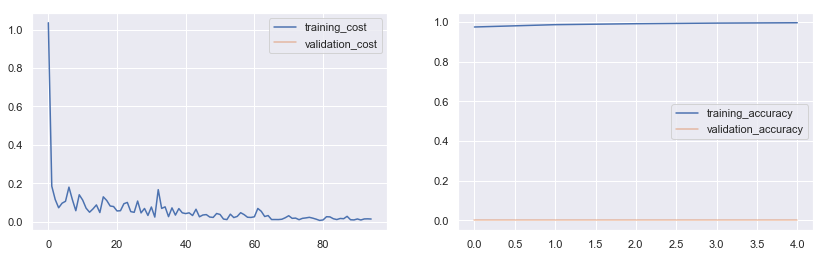

initial_cost:  2.5142  initial_acc:  0.1441
epoch_0  --> cost_train:  0.158326 train_acc:  0.9764  -- cost_val:  0  val_acc:  0  ==> grads:  0.00743
epoch_1  --> cost_train:  0.110334 train_acc:  0.9864  -- cost_val:  0  val_acc:  0  ==> grads:  0.00457
epoch_2  --> cost_train:  0.083912 train_acc:  0.9916  -- cost_val:  0  val_acc:  0  ==> grads:  0.0039
epoch_3  --> cost_train:  0.068974 train_acc:  0.995  -- cost_val:  0  val_acc:  0  ==> grads:  0.00171
epoch_4  --> cost_train:  0.058447 train_acc:  0.9967  -- cost_val:  0  val_acc:  0  ==> grads:  0.00225


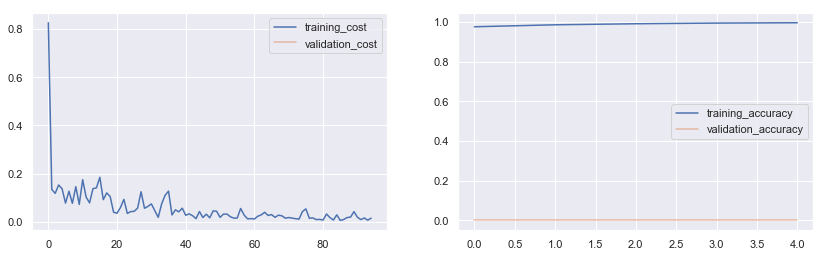

initial_cost:  2.5147  initial_acc:  0.1183
epoch_0  --> cost_train:  0.1398 train_acc:  0.975  -- cost_val:  0  val_acc:  0  ==> grads:  0.00456
epoch_1  --> cost_train:  0.096832 train_acc:  0.9869  -- cost_val:  0  val_acc:  0  ==> grads:  0.00325
epoch_2  --> cost_train:  0.07736 train_acc:  0.9911  -- cost_val:  0  val_acc:  0  ==> grads:  0.00394
epoch_3  --> cost_train:  0.063557 train_acc:  0.9943  -- cost_val:  0  val_acc:  0  ==> grads:  0.00064
epoch_4  --> cost_train:  0.053725 train_acc:  0.9969  -- cost_val:  0  val_acc:  0  ==> grads:  0.0021


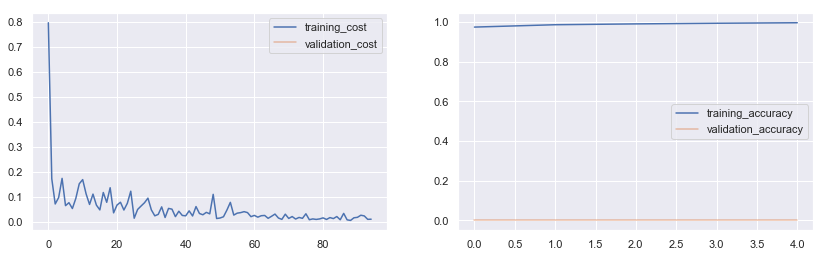

initial_cost:  2.5029  initial_acc:  0.0752
epoch_0  --> cost_train:  0.150405 train_acc:  0.976  -- cost_val:  0  val_acc:  0  ==> grads:  0.00527
epoch_1  --> cost_train:  0.103237 train_acc:  0.9854  -- cost_val:  0  val_acc:  0  ==> grads:  0.00338
epoch_2  --> cost_train:  0.078258 train_acc:  0.9914  -- cost_val:  0  val_acc:  0  ==> grads:  0.00381
epoch_3  --> cost_train:  0.064091 train_acc:  0.9943  -- cost_val:  0  val_acc:  0  ==> grads:  0.00306
epoch_4  --> cost_train:  0.055139 train_acc:  0.9958  -- cost_val:  0  val_acc:  0  ==> grads:  0.00336


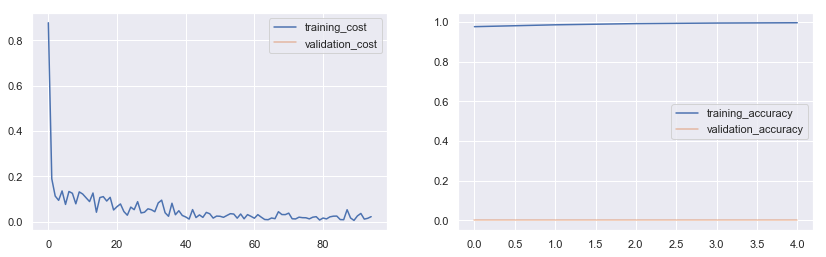

initial_cost:  2.4337  initial_acc:  0.1221
epoch_0  --> cost_train:  0.145637 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.00652
epoch_1  --> cost_train:  0.1022 train_acc:  0.9857  -- cost_val:  0  val_acc:  0  ==> grads:  0.00335
epoch_2  --> cost_train:  0.080479 train_acc:  0.9911  -- cost_val:  0  val_acc:  0  ==> grads:  0.00276
epoch_3  --> cost_train:  0.066313 train_acc:  0.9936  -- cost_val:  0  val_acc:  0  ==> grads:  0.00224
epoch_4  --> cost_train:  0.056854 train_acc:  0.9968  -- cost_val:  0  val_acc:  0  ==> grads:  0.00131


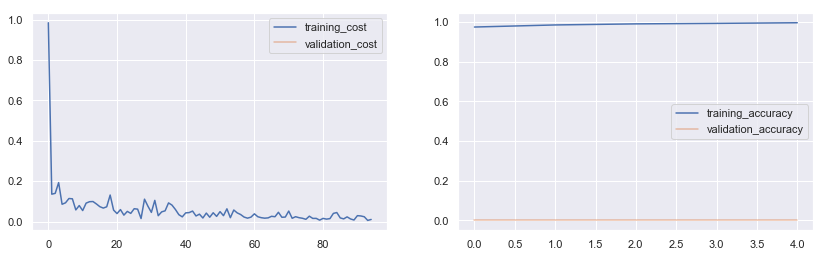

initial_cost:  2.5328  initial_acc:  0.0813
epoch_0  --> cost_train:  0.151358 train_acc:  0.9758  -- cost_val:  0  val_acc:  0  ==> grads:  0.0059
epoch_1  --> cost_train:  0.103326 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00489
epoch_2  --> cost_train:  0.079018 train_acc:  0.9917  -- cost_val:  0  val_acc:  0  ==> grads:  0.00232
epoch_3  --> cost_train:  0.064897 train_acc:  0.9946  -- cost_val:  0  val_acc:  0  ==> grads:  0.00427
epoch_4  --> cost_train:  0.054879 train_acc:  0.9966  -- cost_val:  0  val_acc:  0  ==> grads:  0.00181


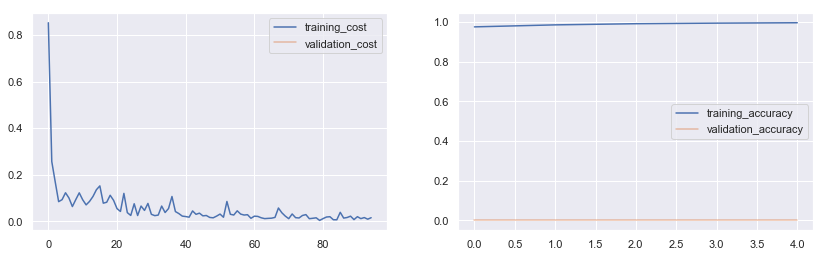

initial_cost:  2.6181  initial_acc:  0.057
epoch_0  --> cost_train:  0.173621 train_acc:  0.9746  -- cost_val:  0  val_acc:  0  ==> grads:  0.00224
epoch_1  --> cost_train:  0.118616 train_acc:  0.9849  -- cost_val:  0  val_acc:  0  ==> grads:  0.00418
epoch_2  --> cost_train:  0.088354 train_acc:  0.9911  -- cost_val:  0  val_acc:  0  ==> grads:  0.00277
epoch_3  --> cost_train:  0.072018 train_acc:  0.9945  -- cost_val:  0  val_acc:  0  ==> grads:  0.00253
epoch_4  --> cost_train:  0.061981 train_acc:  0.996  -- cost_val:  0  val_acc:  0  ==> grads:  0.00219


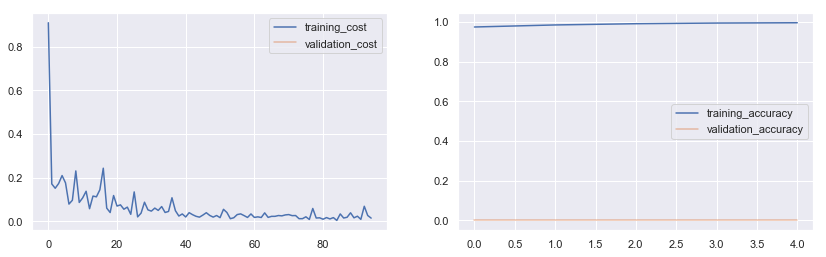

initial_cost:  2.5177  initial_acc:  0.1207
epoch_0  --> cost_train:  0.157353 train_acc:  0.9762  -- cost_val:  0  val_acc:  0  ==> grads:  0.00607
epoch_1  --> cost_train:  0.107284 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00406
epoch_2  --> cost_train:  0.082986 train_acc:  0.9915  -- cost_val:  0  val_acc:  0  ==> grads:  0.00196
epoch_3  --> cost_train:  0.068226 train_acc:  0.9947  -- cost_val:  0  val_acc:  0  ==> grads:  0.00198
epoch_4  --> cost_train:  0.057545 train_acc:  0.996  -- cost_val:  0  val_acc:  0  ==> grads:  0.0012


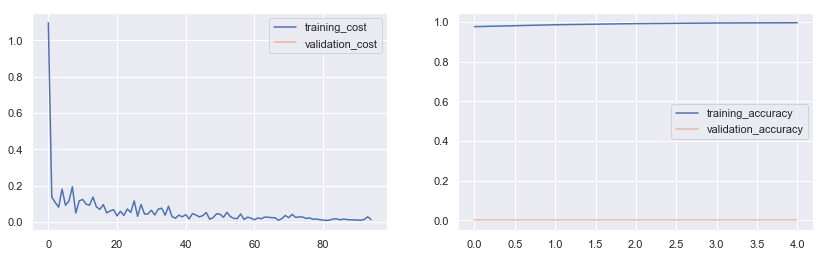

initial_cost:  2.6624  initial_acc:  0.0602
epoch_0  --> cost_train:  0.142784 train_acc:  0.9754  -- cost_val:  0  val_acc:  0  ==> grads:  0.00314
epoch_1  --> cost_train:  0.102845 train_acc:  0.984  -- cost_val:  0  val_acc:  0  ==> grads:  0.00605
epoch_2  --> cost_train:  0.081391 train_acc:  0.9912  -- cost_val:  0  val_acc:  0  ==> grads:  0.00481
epoch_3  --> cost_train:  0.068297 train_acc:  0.9945  -- cost_val:  0  val_acc:  0  ==> grads:  0.00357
epoch_4  --> cost_train:  0.058694 train_acc:  0.9964  -- cost_val:  0  val_acc:  0  ==> grads:  0.0023


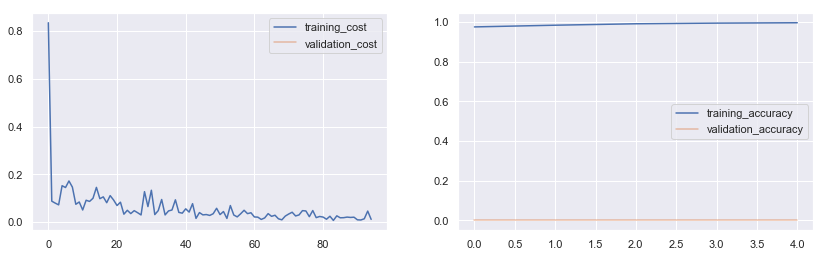

initial_cost:  2.3761  initial_acc:  0.1388
epoch_0  --> cost_train:  0.143089 train_acc:  0.9756  -- cost_val:  0  val_acc:  0  ==> grads:  0.00238
epoch_1  --> cost_train:  0.098979 train_acc:  0.9869  -- cost_val:  0  val_acc:  0  ==> grads:  0.00417
epoch_2  --> cost_train:  0.078861 train_acc:  0.9924  -- cost_val:  0  val_acc:  0  ==> grads:  0.00536
epoch_3  --> cost_train:  0.065726 train_acc:  0.9941  -- cost_val:  0  val_acc:  0  ==> grads:  0.00332
epoch_4  --> cost_train:  0.056085 train_acc:  0.9969  -- cost_val:  0  val_acc:  0  ==> grads:  0.00209


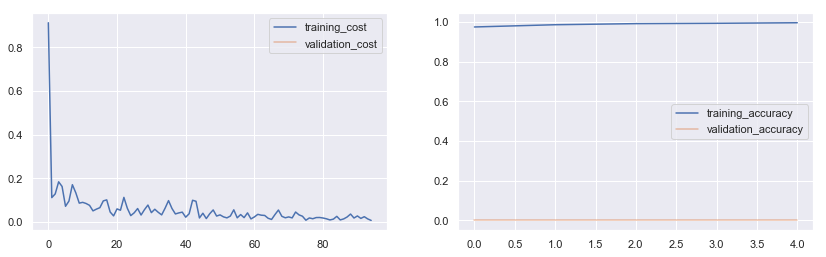

initial_cost:  2.5268  initial_acc:  0.1081
epoch_0  --> cost_train:  0.157416 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.008
epoch_1  --> cost_train:  0.109389 train_acc:  0.9854  -- cost_val:  0  val_acc:  0  ==> grads:  0.00403
epoch_2  --> cost_train:  0.084858 train_acc:  0.9917  -- cost_val:  0  val_acc:  0  ==> grads:  0.00138
epoch_3  --> cost_train:  0.070837 train_acc:  0.995  -- cost_val:  0  val_acc:  0  ==> grads:  0.00236
epoch_4  --> cost_train:  0.060112 train_acc:  0.9963  -- cost_val:  0  val_acc:  0  ==> grads:  0.00349


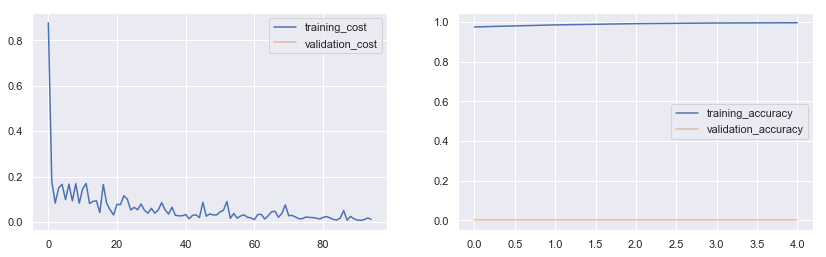

initial_cost:  2.4282  initial_acc:  0.1763
epoch_0  --> cost_train:  0.158805 train_acc:  0.9757  -- cost_val:  0  val_acc:  0  ==> grads:  0.00607
epoch_1  --> cost_train:  0.107447 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00403
epoch_2  --> cost_train:  0.082944 train_acc:  0.9917  -- cost_val:  0  val_acc:  0  ==> grads:  0.0026
epoch_3  --> cost_train:  0.068225 train_acc:  0.9949  -- cost_val:  0  val_acc:  0  ==> grads:  0.00403
epoch_4  --> cost_train:  0.058418 train_acc:  0.9965  -- cost_val:  0  val_acc:  0  ==> grads:  0.00453


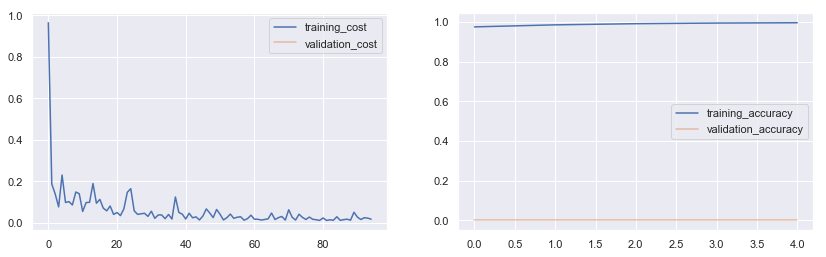

initial_cost:  2.6167  initial_acc:  0.071
epoch_0  --> cost_train:  0.1602 train_acc:  0.9748  -- cost_val:  0  val_acc:  0  ==> grads:  0.00437
epoch_1  --> cost_train:  0.111674 train_acc:  0.9855  -- cost_val:  0  val_acc:  0  ==> grads:  0.0042
epoch_2  --> cost_train:  0.087489 train_acc:  0.9919  -- cost_val:  0  val_acc:  0  ==> grads:  0.00254
epoch_3  --> cost_train:  0.072167 train_acc:  0.9941  -- cost_val:  0  val_acc:  0  ==> grads:  0.00236
epoch_4  --> cost_train:  0.061277 train_acc:  0.9951  -- cost_val:  0  val_acc:  0  ==> grads:  0.00206


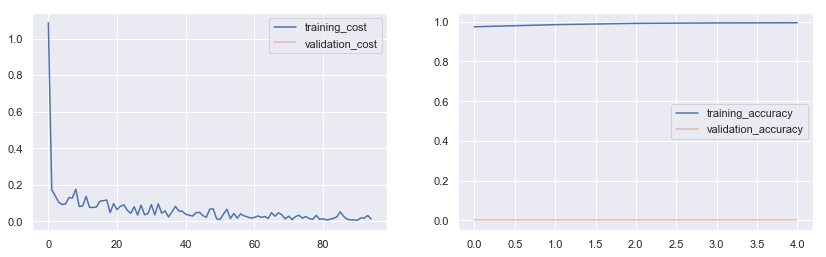

initial_cost:  2.6838  initial_acc:  0.0858
epoch_0  --> cost_train:  0.1585 train_acc:  0.9747  -- cost_val:  0  val_acc:  0  ==> grads:  0.01294
epoch_1  --> cost_train:  0.105521 train_acc:  0.9856  -- cost_val:  0  val_acc:  0  ==> grads:  0.00378
epoch_2  --> cost_train:  0.084037 train_acc:  0.992  -- cost_val:  0  val_acc:  0  ==> grads:  0.00535
epoch_3  --> cost_train:  0.068633 train_acc:  0.995  -- cost_val:  0  val_acc:  0  ==> grads:  0.00444
epoch_4  --> cost_train:  0.057877 train_acc:  0.9965  -- cost_val:  0  val_acc:  0  ==> grads:  0.00365


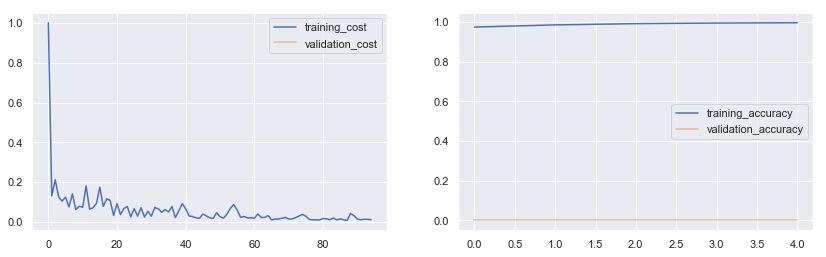

In [6]:
trials = 20
losses = []
for t in range(trials):
    nn_madam = NN_madam(size_h_layer=(X__.shape[1], 256,256, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.0001, l_decay=0.95, bias= 1 , l2_reg= None, dropout=(0, (0,0.5,0.5)),
                              optimizer=('madam',{'beta1':0.9, 'beta2':0.999}),
                              print_=1, plots=1)
    nn_madam.train_nn(X__, y__, epochs= 5, batch_size=128, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_madam.tr_batch_cost)

In [7]:
madam_mnist = losses.copy()

In [8]:
madam_costs = np.zeros((len(madam_mnist[0]), len(madam_mnist)))
for i in range(len(madam_mnist)):
    madam_costs[:,i] = madam_mnist[i]

### Adam testing on MNIST

initial_cost:  2.5976  initial_acc:  0.0812
epoch_0  --> cost_train:  0.332326 train_acc:  0.9629  -- cost_val:  0  val_acc:  0  ==> grads:  0.00505
epoch_1  --> cost_train:  0.224032 train_acc:  0.9748  -- cost_val:  0  val_acc:  0  ==> grads:  0.00344
epoch_2  --> cost_train:  0.179056 train_acc:  0.9818  -- cost_val:  0  val_acc:  0  ==> grads:  0.00557
epoch_3  --> cost_train:  0.152551 train_acc:  0.9852  -- cost_val:  0  val_acc:  0  ==> grads:  0.0032
epoch_4  --> cost_train:  0.131203 train_acc:  0.989  -- cost_val:  0  val_acc:  0  ==> grads:  0.00594


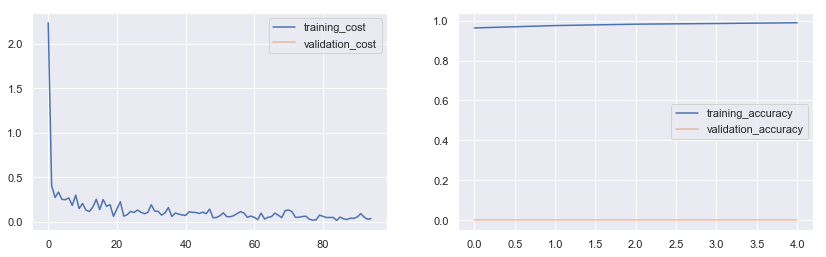

initial_cost:  2.6904  initial_acc:  0.1041
epoch_0  --> cost_train:  0.367426 train_acc:  0.9637  -- cost_val:  0  val_acc:  0  ==> grads:  0.00476
epoch_1  --> cost_train:  0.237547 train_acc:  0.9754  -- cost_val:  0  val_acc:  0  ==> grads:  0.00326
epoch_2  --> cost_train:  0.185421 train_acc:  0.9819  -- cost_val:  0  val_acc:  0  ==> grads:  0.00492
epoch_3  --> cost_train:  0.154922 train_acc:  0.9857  -- cost_val:  0  val_acc:  0  ==> grads:  0.00292
epoch_4  --> cost_train:  0.134297 train_acc:  0.989  -- cost_val:  0  val_acc:  0  ==> grads:  0.00187


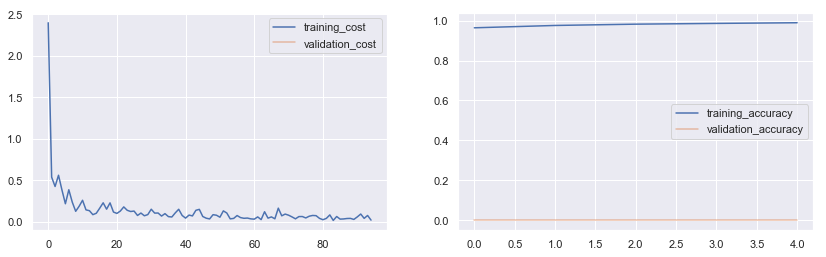

initial_cost:  2.5848  initial_acc:  0.1001
epoch_0  --> cost_train:  0.345026 train_acc:  0.963  -- cost_val:  0  val_acc:  0  ==> grads:  0.00509
epoch_1  --> cost_train:  0.226816 train_acc:  0.9745  -- cost_val:  0  val_acc:  0  ==> grads:  0.00366
epoch_2  --> cost_train:  0.177888 train_acc:  0.9813  -- cost_val:  0  val_acc:  0  ==> grads:  0.00389
epoch_3  --> cost_train:  0.148945 train_acc:  0.9856  -- cost_val:  0  val_acc:  0  ==> grads:  0.00218
epoch_4  --> cost_train:  0.130218 train_acc:  0.9885  -- cost_val:  0  val_acc:  0  ==> grads:  0.0042


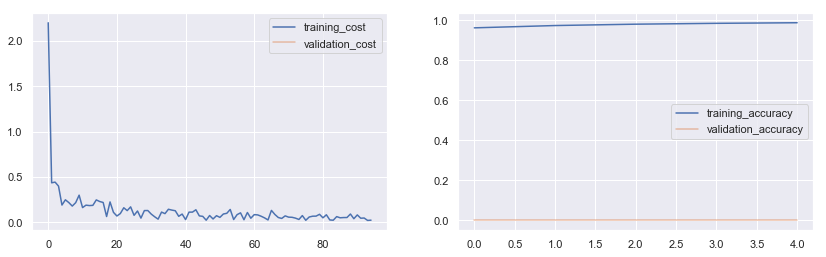

initial_cost:  2.5834  initial_acc:  0.0636
epoch_0  --> cost_train:  0.297305 train_acc:  0.9636  -- cost_val:  0  val_acc:  0  ==> grads:  0.00351
epoch_1  --> cost_train:  0.208684 train_acc:  0.9755  -- cost_val:  0  val_acc:  0  ==> grads:  0.00666
epoch_2  --> cost_train:  0.163596 train_acc:  0.9825  -- cost_val:  0  val_acc:  0  ==> grads:  0.0027
epoch_3  --> cost_train:  0.140962 train_acc:  0.9858  -- cost_val:  0  val_acc:  0  ==> grads:  0.00424
epoch_4  --> cost_train:  0.123835 train_acc:  0.9887  -- cost_val:  0  val_acc:  0  ==> grads:  0.00512


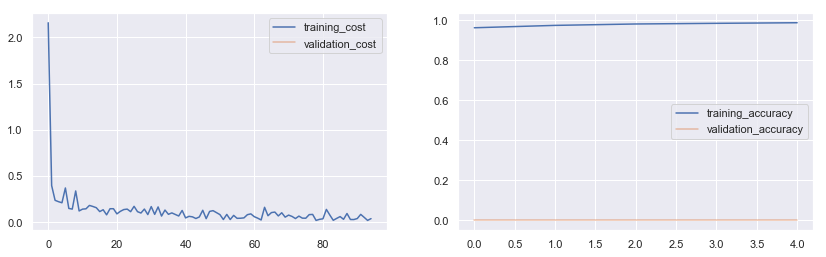

initial_cost:  2.6467  initial_acc:  0.0945
epoch_0  --> cost_train:  0.324153 train_acc:  0.9629  -- cost_val:  0  val_acc:  0  ==> grads:  0.00505
epoch_1  --> cost_train:  0.214697 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.00489
epoch_2  --> cost_train:  0.172446 train_acc:  0.9814  -- cost_val:  0  val_acc:  0  ==> grads:  0.00413
epoch_3  --> cost_train:  0.14775 train_acc:  0.9854  -- cost_val:  0  val_acc:  0  ==> grads:  0.00272
epoch_4  --> cost_train:  0.128943 train_acc:  0.9886  -- cost_val:  0  val_acc:  0  ==> grads:  0.00701


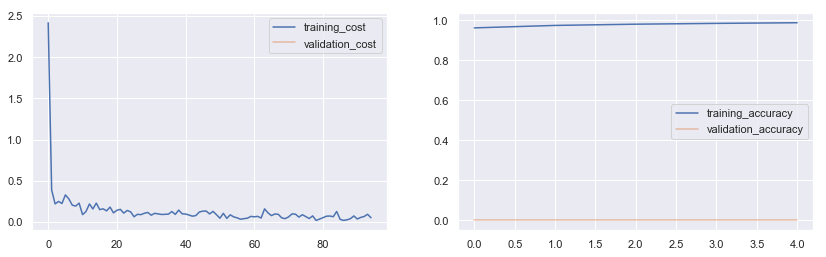

initial_cost:  2.5958  initial_acc:  0.0758
epoch_0  --> cost_train:  0.312058 train_acc:  0.9641  -- cost_val:  0  val_acc:  0  ==> grads:  0.01007
epoch_1  --> cost_train:  0.210589 train_acc:  0.9753  -- cost_val:  0  val_acc:  0  ==> grads:  0.00379
epoch_2  --> cost_train:  0.164584 train_acc:  0.9812  -- cost_val:  0  val_acc:  0  ==> grads:  0.00352
epoch_3  --> cost_train:  0.137812 train_acc:  0.9856  -- cost_val:  0  val_acc:  0  ==> grads:  0.00312
epoch_4  --> cost_train:  0.119187 train_acc:  0.9889  -- cost_val:  0  val_acc:  0  ==> grads:  0.00405


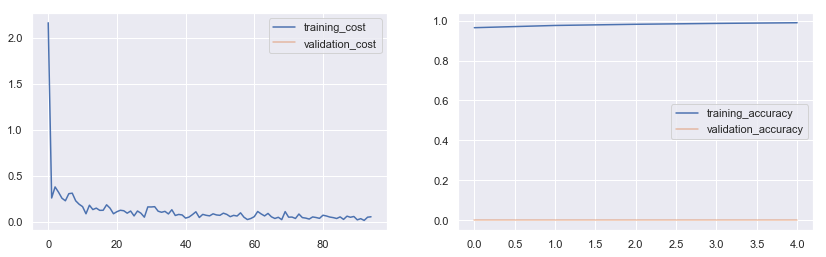

initial_cost:  2.5204  initial_acc:  0.0802
epoch_0  --> cost_train:  0.298079 train_acc:  0.9638  -- cost_val:  0  val_acc:  0  ==> grads:  0.00493
epoch_1  --> cost_train:  0.20905 train_acc:  0.9746  -- cost_val:  0  val_acc:  0  ==> grads:  0.00207
epoch_2  --> cost_train:  0.16733 train_acc:  0.981  -- cost_val:  0  val_acc:  0  ==> grads:  0.00369
epoch_3  --> cost_train:  0.138764 train_acc:  0.9852  -- cost_val:  0  val_acc:  0  ==> grads:  0.00368
epoch_4  --> cost_train:  0.122171 train_acc:  0.9881  -- cost_val:  0  val_acc:  0  ==> grads:  0.00248


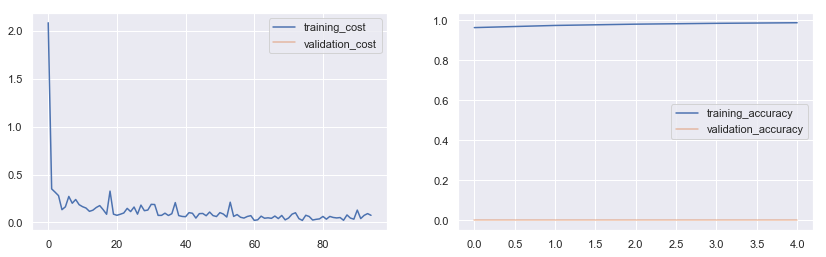

initial_cost:  2.574  initial_acc:  0.0946
epoch_0  --> cost_train:  0.339858 train_acc:  0.9648  -- cost_val:  0  val_acc:  0  ==> grads:  0.00541
epoch_1  --> cost_train:  0.221374 train_acc:  0.9758  -- cost_val:  0  val_acc:  0  ==> grads:  0.00798
epoch_2  --> cost_train:  0.176846 train_acc:  0.9822  -- cost_val:  0  val_acc:  0  ==> grads:  0.00438
epoch_3  --> cost_train:  0.150557 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00501
epoch_4  --> cost_train:  0.13128 train_acc:  0.9892  -- cost_val:  0  val_acc:  0  ==> grads:  0.00207


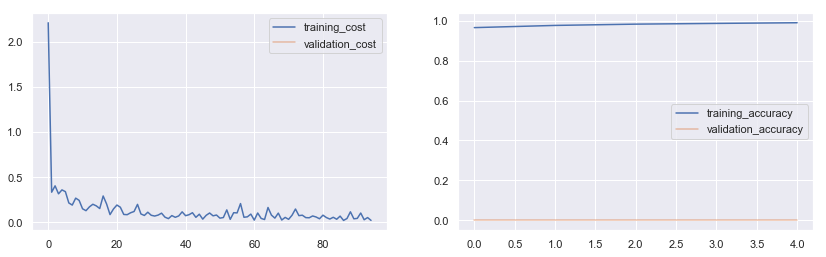

initial_cost:  2.4997  initial_acc:  0.1038
epoch_0  --> cost_train:  0.306947 train_acc:  0.9628  -- cost_val:  0  val_acc:  0  ==> grads:  0.00843
epoch_1  --> cost_train:  0.208774 train_acc:  0.9754  -- cost_val:  0  val_acc:  0  ==> grads:  0.00418
epoch_2  --> cost_train:  0.163333 train_acc:  0.9808  -- cost_val:  0  val_acc:  0  ==> grads:  0.00627
epoch_3  --> cost_train:  0.141462 train_acc:  0.9852  -- cost_val:  0  val_acc:  0  ==> grads:  0.00416
epoch_4  --> cost_train:  0.124225 train_acc:  0.9882  -- cost_val:  0  val_acc:  0  ==> grads:  0.00621


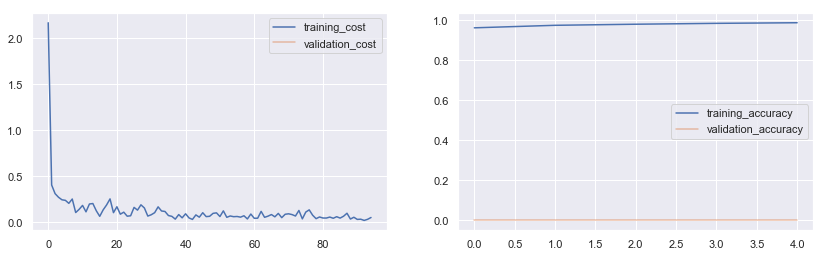

initial_cost:  2.6131  initial_acc:  0.1424
epoch_0  --> cost_train:  0.304868 train_acc:  0.963  -- cost_val:  0  val_acc:  0  ==> grads:  0.00512
epoch_1  --> cost_train:  0.207518 train_acc:  0.9744  -- cost_val:  0  val_acc:  0  ==> grads:  0.00626
epoch_2  --> cost_train:  0.165332 train_acc:  0.9817  -- cost_val:  0  val_acc:  0  ==> grads:  0.00328
epoch_3  --> cost_train:  0.1408 train_acc:  0.9861  -- cost_val:  0  val_acc:  0  ==> grads:  0.00325
epoch_4  --> cost_train:  0.123084 train_acc:  0.9884  -- cost_val:  0  val_acc:  0  ==> grads:  0.00394


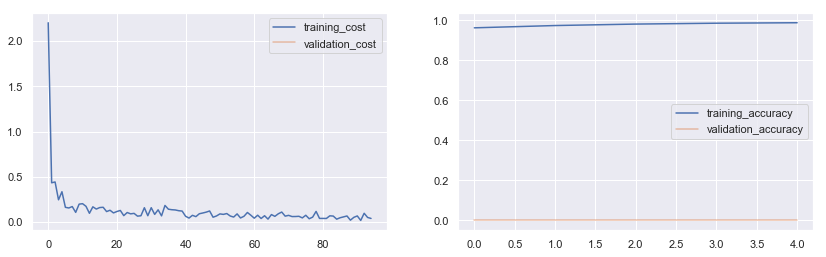

initial_cost:  2.6166  initial_acc:  0.0972
epoch_0  --> cost_train:  0.317421 train_acc:  0.9634  -- cost_val:  0  val_acc:  0  ==> grads:  0.00622
epoch_1  --> cost_train:  0.226329 train_acc:  0.9747  -- cost_val:  0  val_acc:  0  ==> grads:  0.00449
epoch_2  --> cost_train:  0.178765 train_acc:  0.9815  -- cost_val:  0  val_acc:  0  ==> grads:  0.00654
epoch_3  --> cost_train:  0.151889 train_acc:  0.9857  -- cost_val:  0  val_acc:  0  ==> grads:  0.00436
epoch_4  --> cost_train:  0.131584 train_acc:  0.9879  -- cost_val:  0  val_acc:  0  ==> grads:  0.00353


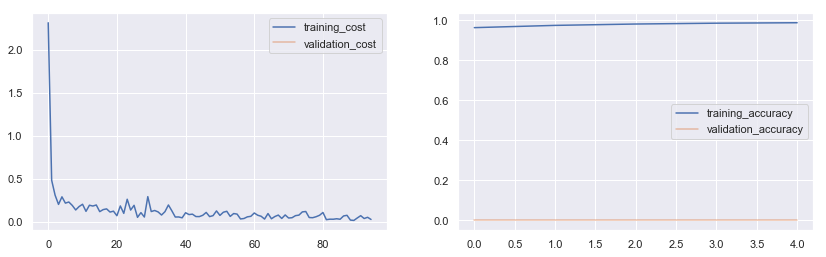

initial_cost:  2.4961  initial_acc:  0.0898
epoch_0  --> cost_train:  0.3251 train_acc:  0.9632  -- cost_val:  0  val_acc:  0  ==> grads:  0.00526
epoch_1  --> cost_train:  0.218292 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.0034
epoch_2  --> cost_train:  0.173358 train_acc:  0.9813  -- cost_val:  0  val_acc:  0  ==> grads:  0.00555
epoch_3  --> cost_train:  0.146614 train_acc:  0.9859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00377
epoch_4  --> cost_train:  0.126862 train_acc:  0.9889  -- cost_val:  0  val_acc:  0  ==> grads:  0.0043


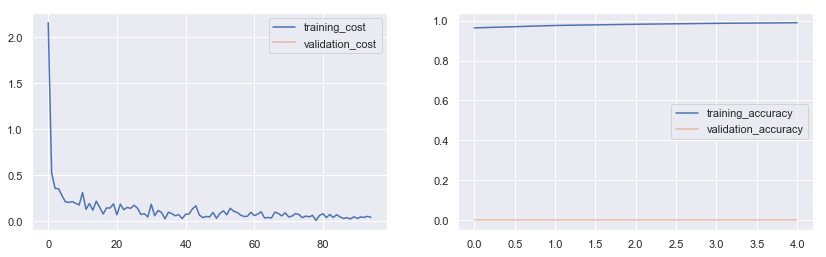

initial_cost:  2.5089  initial_acc:  0.0956
epoch_0  --> cost_train:  0.325547 train_acc:  0.9627  -- cost_val:  0  val_acc:  0  ==> grads:  0.00653
epoch_1  --> cost_train:  0.216718 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.00738
epoch_2  --> cost_train:  0.172398 train_acc:  0.9821  -- cost_val:  0  val_acc:  0  ==> grads:  0.00323
epoch_3  --> cost_train:  0.145413 train_acc:  0.9856  -- cost_val:  0  val_acc:  0  ==> grads:  0.00293
epoch_4  --> cost_train:  0.129165 train_acc:  0.9888  -- cost_val:  0  val_acc:  0  ==> grads:  0.00316


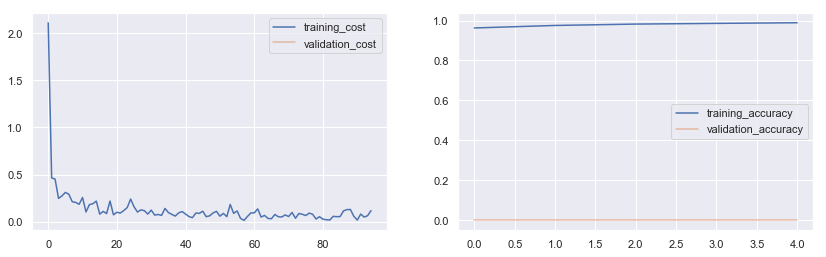

initial_cost:  2.5596  initial_acc:  0.0963
epoch_0  --> cost_train:  0.2963 train_acc:  0.9641  -- cost_val:  0  val_acc:  0  ==> grads:  0.00439
epoch_1  --> cost_train:  0.209934 train_acc:  0.9755  -- cost_val:  0  val_acc:  0  ==> grads:  0.00384
epoch_2  --> cost_train:  0.166984 train_acc:  0.9814  -- cost_val:  0  val_acc:  0  ==> grads:  0.00367
epoch_3  --> cost_train:  0.140287 train_acc:  0.9857  -- cost_val:  0  val_acc:  0  ==> grads:  0.00323
epoch_4  --> cost_train:  0.122885 train_acc:  0.989  -- cost_val:  0  val_acc:  0  ==> grads:  0.00341


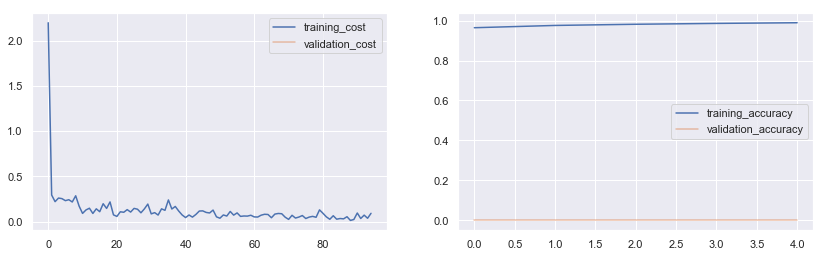

initial_cost:  2.4901  initial_acc:  0.0814
epoch_0  --> cost_train:  0.313874 train_acc:  0.9635  -- cost_val:  0  val_acc:  0  ==> grads:  0.00654
epoch_1  --> cost_train:  0.212503 train_acc:  0.9758  -- cost_val:  0  val_acc:  0  ==> grads:  0.00483
epoch_2  --> cost_train:  0.163595 train_acc:  0.9826  -- cost_val:  0  val_acc:  0  ==> grads:  0.00326
epoch_3  --> cost_train:  0.139792 train_acc:  0.987  -- cost_val:  0  val_acc:  0  ==> grads:  0.0081
epoch_4  --> cost_train:  0.122081 train_acc:  0.9894  -- cost_val:  0  val_acc:  0  ==> grads:  0.00311


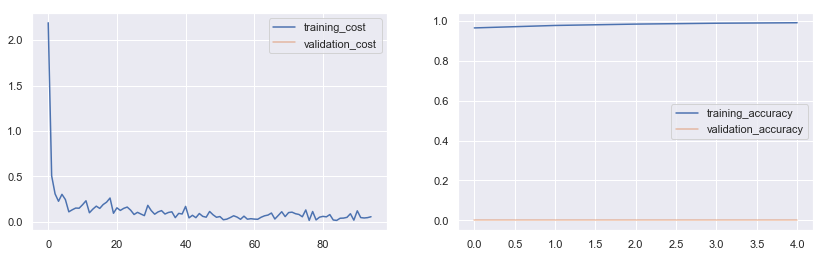

initial_cost:  2.5874  initial_acc:  0.1167
epoch_0  --> cost_train:  0.337063 train_acc:  0.962  -- cost_val:  0  val_acc:  0  ==> grads:  0.00442
epoch_1  --> cost_train:  0.227629 train_acc:  0.9755  -- cost_val:  0  val_acc:  0  ==> grads:  0.00346
epoch_2  --> cost_train:  0.178663 train_acc:  0.9816  -- cost_val:  0  val_acc:  0  ==> grads:  0.00376
epoch_3  --> cost_train:  0.149246 train_acc:  0.9858  -- cost_val:  0  val_acc:  0  ==> grads:  0.00383
epoch_4  --> cost_train:  0.128423 train_acc:  0.9891  -- cost_val:  0  val_acc:  0  ==> grads:  0.00339


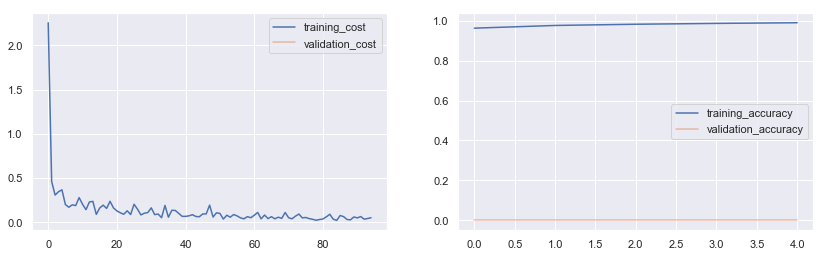

initial_cost:  2.6192  initial_acc:  0.1104
epoch_0  --> cost_train:  0.321274 train_acc:  0.9638  -- cost_val:  0  val_acc:  0  ==> grads:  0.00475
epoch_1  --> cost_train:  0.222368 train_acc:  0.9748  -- cost_val:  0  val_acc:  0  ==> grads:  0.00293
epoch_2  --> cost_train:  0.175467 train_acc:  0.9818  -- cost_val:  0  val_acc:  0  ==> grads:  0.00292
epoch_3  --> cost_train:  0.149401 train_acc:  0.9864  -- cost_val:  0  val_acc:  0  ==> grads:  0.00503
epoch_4  --> cost_train:  0.129466 train_acc:  0.9882  -- cost_val:  0  val_acc:  0  ==> grads:  0.00482


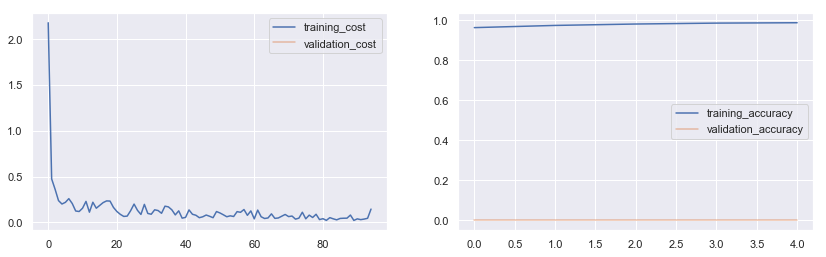

initial_cost:  2.6586  initial_acc:  0.0788
epoch_0  --> cost_train:  0.336721 train_acc:  0.9639  -- cost_val:  0  val_acc:  0  ==> grads:  0.00453
epoch_1  --> cost_train:  0.232318 train_acc:  0.976  -- cost_val:  0  val_acc:  0  ==> grads:  0.00519
epoch_2  --> cost_train:  0.181374 train_acc:  0.9812  -- cost_val:  0  val_acc:  0  ==> grads:  0.00369
epoch_3  --> cost_train:  0.153024 train_acc:  0.9858  -- cost_val:  0  val_acc:  0  ==> grads:  0.00323
epoch_4  --> cost_train:  0.133668 train_acc:  0.9884  -- cost_val:  0  val_acc:  0  ==> grads:  0.00257


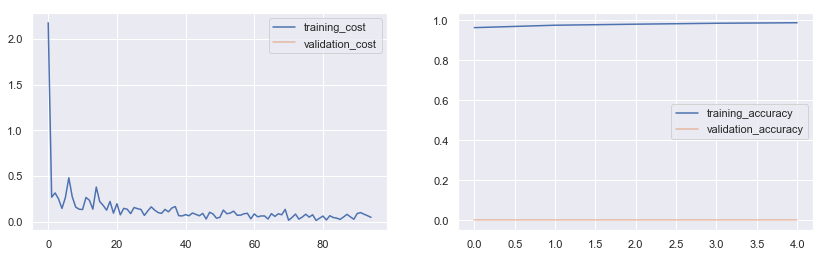

initial_cost:  2.5509  initial_acc:  0.1204
epoch_0  --> cost_train:  0.323579 train_acc:  0.9633  -- cost_val:  0  val_acc:  0  ==> grads:  0.01082
epoch_1  --> cost_train:  0.213374 train_acc:  0.9754  -- cost_val:  0  val_acc:  0  ==> grads:  0.00775
epoch_2  --> cost_train:  0.174737 train_acc:  0.9812  -- cost_val:  0  val_acc:  0  ==> grads:  0.01002
epoch_3  --> cost_train:  0.148261 train_acc:  0.986  -- cost_val:  0  val_acc:  0  ==> grads:  0.0053
epoch_4  --> cost_train:  0.128135 train_acc:  0.9887  -- cost_val:  0  val_acc:  0  ==> grads:  0.00282


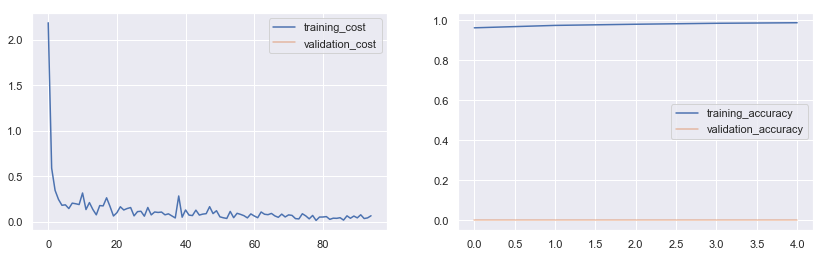

initial_cost:  2.6229  initial_acc:  0.0875
epoch_0  --> cost_train:  0.304395 train_acc:  0.9634  -- cost_val:  0  val_acc:  0  ==> grads:  0.00532
epoch_1  --> cost_train:  0.219218 train_acc:  0.9752  -- cost_val:  0  val_acc:  0  ==> grads:  0.00457
epoch_2  --> cost_train:  0.170412 train_acc:  0.9811  -- cost_val:  0  val_acc:  0  ==> grads:  0.00318
epoch_3  --> cost_train:  0.142342 train_acc:  0.9854  -- cost_val:  0  val_acc:  0  ==> grads:  0.00499
epoch_4  --> cost_train:  0.125624 train_acc:  0.989  -- cost_val:  0  val_acc:  0  ==> grads:  0.00321


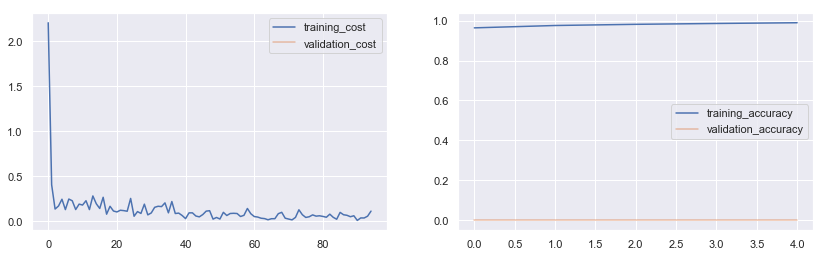

In [9]:
trials = 20
losses = []
for t in range(trials):
    nn_adam = NN_madam(size_h_layer=(X__.shape[1], 256,256, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.0001, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(0, (0,0.5,0.5)),
                              optimizer=('adam',{'beta1':0.9, 'beta2':0.999}),
                              print_=1, plots=1)
    nn_adam.train_nn(X__, y__, epochs= 5, batch_size=128, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_adam.tr_batch_cost)

In [10]:
adam_mnist = losses.copy()

In [11]:
adam_costs = np.zeros((len(adam_mnist[0]), len(adam_mnist)))
for i in range(len(adam_mnist)):
    adam_costs[:,i] = adam_mnist[i]

### Results on MNIST

In [21]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 600

Text(0.5, 1.0, 'MNIST Dataset - Avg losses over 20 x 5 epochs trials (batch=128)')

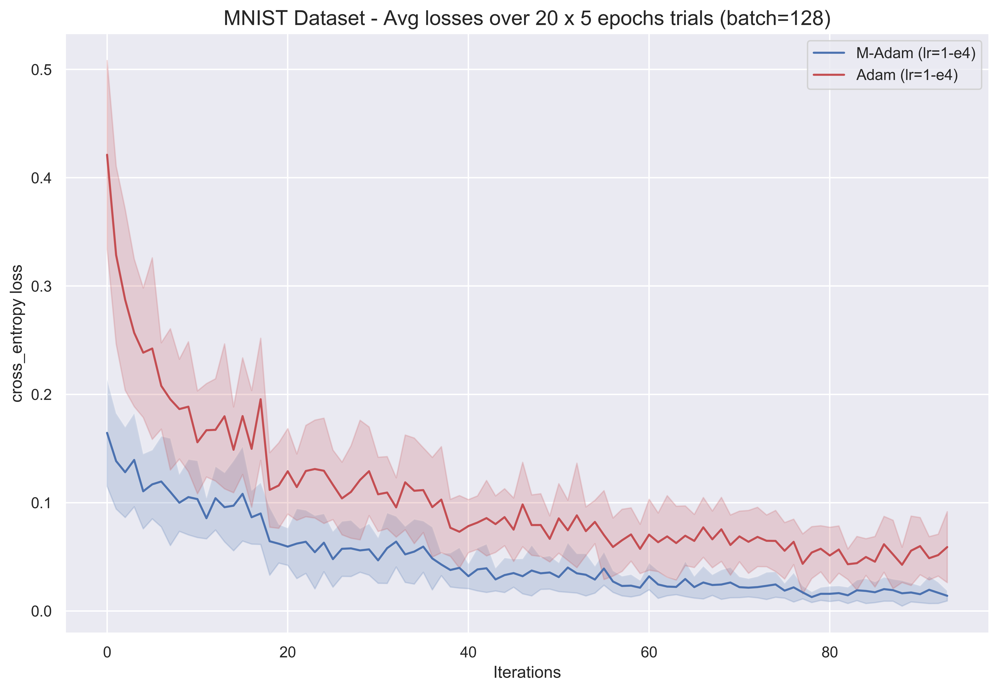

In [22]:
plt.figure(figsize=(12,8))
start = 1
plt.plot(madam_costs.mean(axis=1)[start:], 'b')
plt.fill_between(np.arange(len(madam_costs.mean(axis=1)[start:])), madam_costs.mean(axis=1)[start:], madam_costs.mean(axis=1)[start:] + madam_costs.std(axis=1)[start:], alpha=0.2)
plt.fill_between(np.arange(len(madam_costs.mean(axis=1)[start:])), madam_costs.mean(axis=1)[start:], madam_costs.mean(axis=1)[start:] - madam_costs.std(axis=1)[start:], alpha=0.2,color='b')


plt.plot(adam_costs.mean(axis=1)[1:], 'r')
plt.fill_between(np.arange(len(adam_costs.mean(axis=1)[start:])), adam_costs.mean(axis=1)[start:], adam_costs.mean(axis=1)[start:] + adam_costs.std(axis=1)[start:], alpha=0.2,color='r')
plt.fill_between(np.arange(len(adam_costs.mean(axis=1)[start:])), adam_costs.mean(axis=1)[start:], adam_costs.mean(axis=1)[start:] - adam_costs.std(axis=1)[start:], alpha=0.2,color='r')
plt.legend(['M-Adam (lr=1-e4)', 'Adam (lr=1-e4)'])
plt.xlabel('Iterations', size=12)
plt.ylabel('cross_entropy loss', size=12)
plt.title('MNIST Dataset - Avg losses over 20 x 5 epochs trials (batch=128)', size=15)


## CIFAR-10

In [131]:
from keras.datasets import cifar10

#here we use the (smaller) CIFAR10 test dataset to compare the convergenge of the 2 optimizers
(x, y), (x_train, y__) = cifar10.load_data()

In [132]:
from sklearn.preprocessing import StandardScaler
y__.shape

(10000, 1)

In [133]:
sc_ = StandardScaler()
X__ = sc_.fit_transform(x_train.reshape(-1,3072).astype(float))
#X__test = sc_.transform(x_test.reshape(-1,3072).astype(float))

### M-Adam on CIFAR10

#### Network Structure:

- 2 layers of 512 neurons each
- activation: ReLU
- initialization: truncnorm
- learning rate: 5e-5
- l_rate decay: 0.95
- optimizer: M-Adam {beta1=0.9, beta2=0.999)}
- epochs: 10
- batch_size: 32



initial_cost:  3.1298  initial_acc:  0.1046
epoch_0  --> cost_train:  1.631354 train_acc:  0.538  -- cost_val:  0  val_acc:  0  ==> grads:  0.02223
epoch_1  --> cost_train:  1.4607 train_acc:  0.6527  -- cost_val:  0  val_acc:  0  ==> grads:  0.02532
epoch_2  --> cost_train:  1.334813 train_acc:  0.7119  -- cost_val:  0  val_acc:  0  ==> grads:  0.02264
epoch_3  --> cost_train:  1.230021 train_acc:  0.761  -- cost_val:  0  val_acc:  0  ==> grads:  0.0225
epoch_4  --> cost_train:  1.136466 train_acc:  0.8187  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_5  --> cost_train:  1.060492 train_acc:  0.8537  -- cost_val:  0  val_acc:  0  ==> grads:  0.01833
epoch_6  --> cost_train:  1.001811 train_acc:  0.8811  -- cost_val:  0  val_acc:  0  ==> grads:  0.02089
epoch_7  --> cost_train:  0.946219 train_acc:  0.9024  -- cost_val:  0  val_acc:  0  ==> grads:  0.02036
epoch_8  --> cost_train:  0.895275 train_acc:  0.921  -- cost_val:  0  val_acc:  0  ==> grads:  0.01986
epoch_9  --> cost

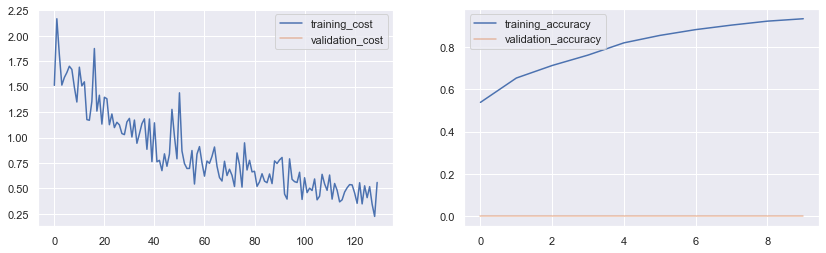

initial_cost:  3.2142  initial_acc:  0.0807
epoch_0  --> cost_train:  1.545669 train_acc:  0.5531  -- cost_val:  0  val_acc:  0  ==> grads:  0.02544
epoch_1  --> cost_train:  1.387512 train_acc:  0.662  -- cost_val:  0  val_acc:  0  ==> grads:  0.02196
epoch_2  --> cost_train:  1.277862 train_acc:  0.7319  -- cost_val:  0  val_acc:  0  ==> grads:  0.02122
epoch_3  --> cost_train:  1.169588 train_acc:  0.7881  -- cost_val:  0  val_acc:  0  ==> grads:  0.02364
epoch_4  --> cost_train:  1.085523 train_acc:  0.836  -- cost_val:  0  val_acc:  0  ==> grads:  0.02105
epoch_5  --> cost_train:  1.017971 train_acc:  0.8659  -- cost_val:  0  val_acc:  0  ==> grads:  0.02298
epoch_6  --> cost_train:  0.957402 train_acc:  0.8875  -- cost_val:  0  val_acc:  0  ==> grads:  0.01914
epoch_7  --> cost_train:  0.899695 train_acc:  0.9068  -- cost_val:  0  val_acc:  0  ==> grads:  0.02215
epoch_8  --> cost_train:  0.855884 train_acc:  0.9347  -- cost_val:  0  val_acc:  0  ==> grads:  0.02123
epoch_9  --> 

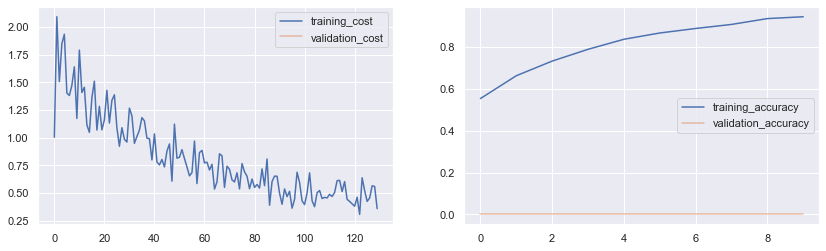

initial_cost:  3.6178  initial_acc:  0.0664
epoch_0  --> cost_train:  1.806531 train_acc:  0.5469  -- cost_val:  0  val_acc:  0  ==> grads:  0.02331
epoch_1  --> cost_train:  1.536842 train_acc:  0.6445  -- cost_val:  0  val_acc:  0  ==> grads:  0.0191
epoch_2  --> cost_train:  1.371579 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02486
epoch_3  --> cost_train:  1.263542 train_acc:  0.786  -- cost_val:  0  val_acc:  0  ==> grads:  0.01827
epoch_4  --> cost_train:  1.168777 train_acc:  0.8169  -- cost_val:  0  val_acc:  0  ==> grads:  0.01999
epoch_5  --> cost_train:  1.081921 train_acc:  0.8612  -- cost_val:  0  val_acc:  0  ==> grads:  0.02161
epoch_6  --> cost_train:  1.007651 train_acc:  0.8924  -- cost_val:  0  val_acc:  0  ==> grads:  0.01705
epoch_7  --> cost_train:  0.951362 train_acc:  0.913  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_8  --> cost_train:  0.895383 train_acc:  0.9302  -- cost_val:  0  val_acc:  0  ==> grads:  0.01552
epoch_9  --> c

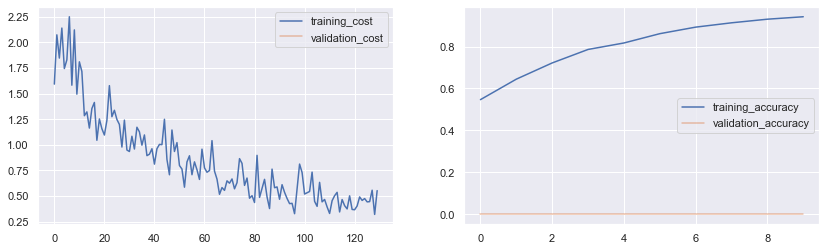

initial_cost:  3.3914  initial_acc:  0.0962
epoch_0  --> cost_train:  1.585254 train_acc:  0.553  -- cost_val:  0  val_acc:  0  ==> grads:  0.02459
epoch_1  --> cost_train:  1.389942 train_acc:  0.6458  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_2  --> cost_train:  1.245874 train_acc:  0.7314  -- cost_val:  0  val_acc:  0  ==> grads:  0.02083
epoch_3  --> cost_train:  1.153648 train_acc:  0.783  -- cost_val:  0  val_acc:  0  ==> grads:  0.01891
epoch_4  --> cost_train:  1.076232 train_acc:  0.8241  -- cost_val:  0  val_acc:  0  ==> grads:  0.01904
epoch_5  --> cost_train:  1.008622 train_acc:  0.8696  -- cost_val:  0  val_acc:  0  ==> grads:  0.02304
epoch_6  --> cost_train:  0.949964 train_acc:  0.8884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01935
epoch_7  --> cost_train:  0.900702 train_acc:  0.908  -- cost_val:  0  val_acc:  0  ==> grads:  0.01556
epoch_8  --> cost_train:  0.858909 train_acc:  0.929  -- cost_val:  0  val_acc:  0  ==> grads:  0.02168
epoch_9  --> co

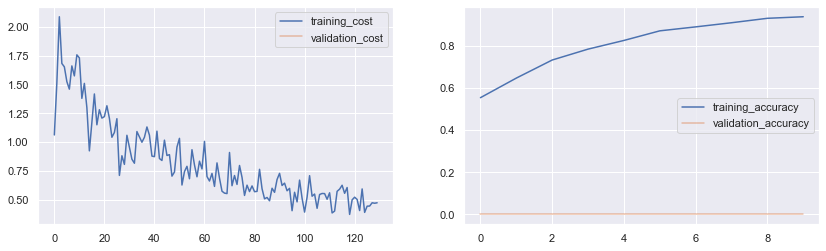

initial_cost:  3.2559  initial_acc:  0.1021
epoch_0  --> cost_train:  1.608362 train_acc:  0.5603  -- cost_val:  0  val_acc:  0  ==> grads:  0.02013
epoch_1  --> cost_train:  1.424073 train_acc:  0.6451  -- cost_val:  0  val_acc:  0  ==> grads:  0.02188
epoch_2  --> cost_train:  1.313154 train_acc:  0.7382  -- cost_val:  0  val_acc:  0  ==> grads:  0.02709
epoch_3  --> cost_train:  1.20219 train_acc:  0.7857  -- cost_val:  0  val_acc:  0  ==> grads:  0.02142
epoch_4  --> cost_train:  1.123091 train_acc:  0.8254  -- cost_val:  0  val_acc:  0  ==> grads:  0.02683
epoch_5  --> cost_train:  1.042035 train_acc:  0.8598  -- cost_val:  0  val_acc:  0  ==> grads:  0.02153
epoch_6  --> cost_train:  0.98572 train_acc:  0.8876  -- cost_val:  0  val_acc:  0  ==> grads:  0.02155
epoch_7  --> cost_train:  0.924846 train_acc:  0.9114  -- cost_val:  0  val_acc:  0  ==> grads:  0.01968
epoch_8  --> cost_train:  0.87604 train_acc:  0.9301  -- cost_val:  0  val_acc:  0  ==> grads:  0.01903
epoch_9  --> c

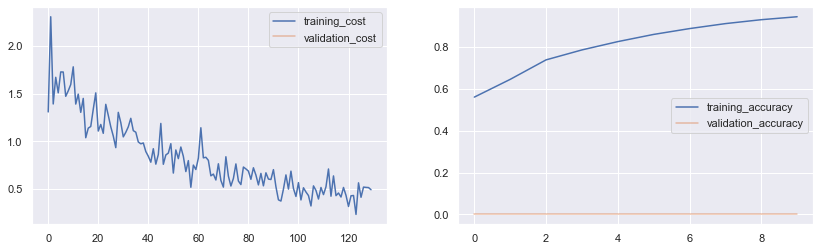

initial_cost:  3.1441  initial_acc:  0.1005
epoch_0  --> cost_train:  1.518362 train_acc:  0.5552  -- cost_val:  0  val_acc:  0  ==> grads:  0.02383
epoch_1  --> cost_train:  1.382304 train_acc:  0.6512  -- cost_val:  0  val_acc:  0  ==> grads:  0.02382
epoch_2  --> cost_train:  1.273867 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02269
epoch_3  --> cost_train:  1.189025 train_acc:  0.7719  -- cost_val:  0  val_acc:  0  ==> grads:  0.02057
epoch_4  --> cost_train:  1.104892 train_acc:  0.8252  -- cost_val:  0  val_acc:  0  ==> grads:  0.01699
epoch_5  --> cost_train:  1.035559 train_acc:  0.8585  -- cost_val:  0  val_acc:  0  ==> grads:  0.01886
epoch_6  --> cost_train:  0.982084 train_acc:  0.8912  -- cost_val:  0  val_acc:  0  ==> grads:  0.01991
epoch_7  --> cost_train:  0.922295 train_acc:  0.8986  -- cost_val:  0  val_acc:  0  ==> grads:  0.01703
epoch_8  --> cost_train:  0.870449 train_acc:  0.9246  -- cost_val:  0  val_acc:  0  ==> grads:  0.01707
epoch_9  --

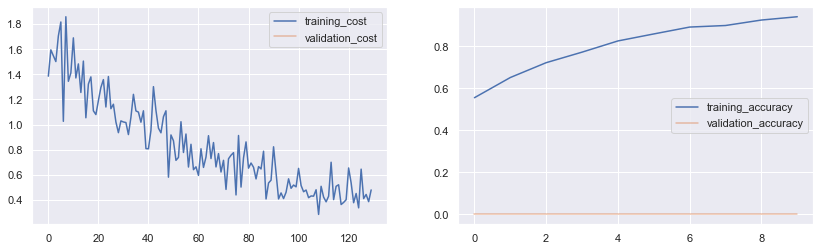

initial_cost:  3.5638  initial_acc:  0.1035
epoch_0  --> cost_train:  1.741577 train_acc:  0.5413  -- cost_val:  0  val_acc:  0  ==> grads:  0.02537
epoch_1  --> cost_train:  1.440565 train_acc:  0.6629  -- cost_val:  0  val_acc:  0  ==> grads:  0.02219
epoch_2  --> cost_train:  1.315997 train_acc:  0.7242  -- cost_val:  0  val_acc:  0  ==> grads:  0.02112
epoch_3  --> cost_train:  1.201977 train_acc:  0.7857  -- cost_val:  0  val_acc:  0  ==> grads:  0.01947
epoch_4  --> cost_train:  1.130332 train_acc:  0.8341  -- cost_val:  0  val_acc:  0  ==> grads:  0.02703
epoch_5  --> cost_train:  1.052069 train_acc:  0.8672  -- cost_val:  0  val_acc:  0  ==> grads:  0.01811
epoch_6  --> cost_train:  0.980769 train_acc:  0.8815  -- cost_val:  0  val_acc:  0  ==> grads:  0.01719
epoch_7  --> cost_train:  0.925664 train_acc:  0.9017  -- cost_val:  0  val_acc:  0  ==> grads:  0.01967
epoch_8  --> cost_train:  0.876545 train_acc:  0.934  -- cost_val:  0  val_acc:  0  ==> grads:  0.01605
epoch_9  -->

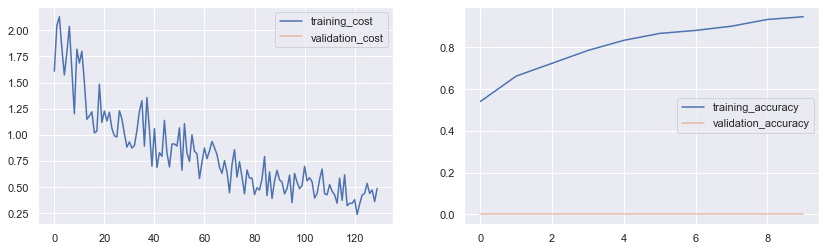

initial_cost:  3.3832  initial_acc:  0.0813
epoch_0  --> cost_train:  1.601362 train_acc:  0.5374  -- cost_val:  0  val_acc:  0  ==> grads:  0.02119
epoch_1  --> cost_train:  1.417708 train_acc:  0.6444  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_2  --> cost_train:  1.3215 train_acc:  0.7214  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_3  --> cost_train:  1.216506 train_acc:  0.7771  -- cost_val:  0  val_acc:  0  ==> grads:  0.02335
epoch_4  --> cost_train:  1.143203 train_acc:  0.8217  -- cost_val:  0  val_acc:  0  ==> grads:  0.02345
epoch_5  --> cost_train:  1.064679 train_acc:  0.8606  -- cost_val:  0  val_acc:  0  ==> grads:  0.02086
epoch_6  --> cost_train:  0.999244 train_acc:  0.877  -- cost_val:  0  val_acc:  0  ==> grads:  0.02461
epoch_7  --> cost_train:  0.940435 train_acc:  0.9055  -- cost_val:  0  val_acc:  0  ==> grads:  0.01836
epoch_8  --> cost_train:  0.890477 train_acc:  0.922  -- cost_val:  0  val_acc:  0  ==> grads:  0.0208
epoch_9  --> cos

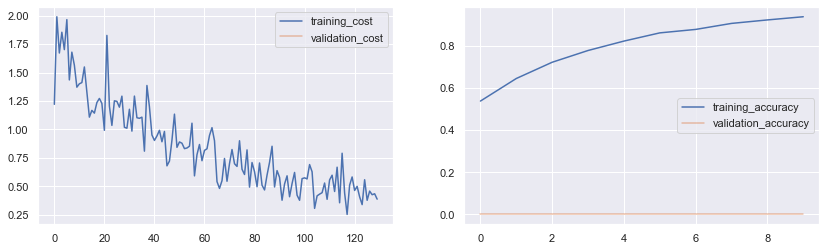

initial_cost:  3.0803  initial_acc:  0.0907
epoch_0  --> cost_train:  1.706962 train_acc:  0.5486  -- cost_val:  0  val_acc:  0  ==> grads:  0.02448
epoch_1  --> cost_train:  1.444738 train_acc:  0.6394  -- cost_val:  0  val_acc:  0  ==> grads:  0.02552
epoch_2  --> cost_train:  1.320015 train_acc:  0.7206  -- cost_val:  0  val_acc:  0  ==> grads:  0.02154
epoch_3  --> cost_train:  1.189694 train_acc:  0.7867  -- cost_val:  0  val_acc:  0  ==> grads:  0.01874
epoch_4  --> cost_train:  1.106862 train_acc:  0.8192  -- cost_val:  0  val_acc:  0  ==> grads:  0.01963
epoch_5  --> cost_train:  1.032006 train_acc:  0.8557  -- cost_val:  0  val_acc:  0  ==> grads:  0.01499
epoch_6  --> cost_train:  0.968938 train_acc:  0.8918  -- cost_val:  0  val_acc:  0  ==> grads:  0.02142
epoch_7  --> cost_train:  0.909157 train_acc:  0.915  -- cost_val:  0  val_acc:  0  ==> grads:  0.01827
epoch_8  --> cost_train:  0.857173 train_acc:  0.9245  -- cost_val:  0  val_acc:  0  ==> grads:  0.01799
epoch_9  -->

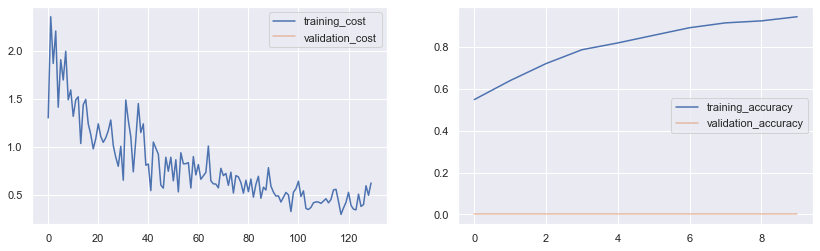

initial_cost:  3.4105  initial_acc:  0.0949
epoch_0  --> cost_train:  1.598 train_acc:  0.5425  -- cost_val:  0  val_acc:  0  ==> grads:  0.02838
epoch_1  --> cost_train:  1.440627 train_acc:  0.6468  -- cost_val:  0  val_acc:  0  ==> grads:  0.02663
epoch_2  --> cost_train:  1.316515 train_acc:  0.7188  -- cost_val:  0  val_acc:  0  ==> grads:  0.02827
epoch_3  --> cost_train:  1.195798 train_acc:  0.7783  -- cost_val:  0  val_acc:  0  ==> grads:  0.02583
epoch_4  --> cost_train:  1.117692 train_acc:  0.8302  -- cost_val:  0  val_acc:  0  ==> grads:  0.02347
epoch_5  --> cost_train:  1.045168 train_acc:  0.8548  -- cost_val:  0  val_acc:  0  ==> grads:  0.02639
epoch_6  --> cost_train:  0.980101 train_acc:  0.8792  -- cost_val:  0  val_acc:  0  ==> grads:  0.02468
epoch_7  --> cost_train:  0.928156 train_acc:  0.9037  -- cost_val:  0  val_acc:  0  ==> grads:  0.01645
epoch_8  --> cost_train:  0.877905 train_acc:  0.9285  -- cost_val:  0  val_acc:  0  ==> grads:  0.01338
epoch_9  --> c

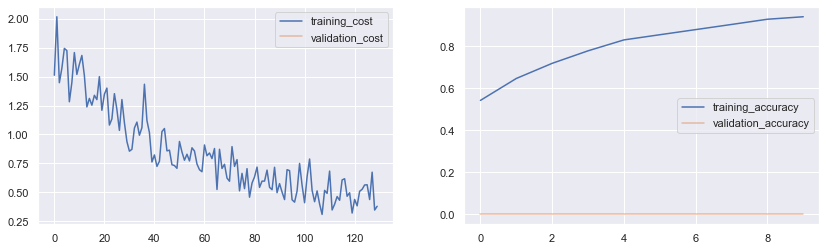

initial_cost:  3.1381  initial_acc:  0.0841
epoch_0  --> cost_train:  1.556954 train_acc:  0.5563  -- cost_val:  0  val_acc:  0  ==> grads:  0.02104
epoch_1  --> cost_train:  1.420492 train_acc:  0.6434  -- cost_val:  0  val_acc:  0  ==> grads:  0.0186
epoch_2  --> cost_train:  1.291738 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02158
epoch_3  --> cost_train:  1.189283 train_acc:  0.7684  -- cost_val:  0  val_acc:  0  ==> grads:  0.01872
epoch_4  --> cost_train:  1.109905 train_acc:  0.8237  -- cost_val:  0  val_acc:  0  ==> grads:  0.02266
epoch_5  --> cost_train:  1.044635 train_acc:  0.8607  -- cost_val:  0  val_acc:  0  ==> grads:  0.01779
epoch_6  --> cost_train:  0.985481 train_acc:  0.896  -- cost_val:  0  val_acc:  0  ==> grads:  0.01895
epoch_7  --> cost_train:  0.928969 train_acc:  0.9126  -- cost_val:  0  val_acc:  0  ==> grads:  0.01718
epoch_8  --> cost_train:  0.880652 train_acc:  0.9306  -- cost_val:  0  val_acc:  0  ==> grads:  0.01811
epoch_9  --> 

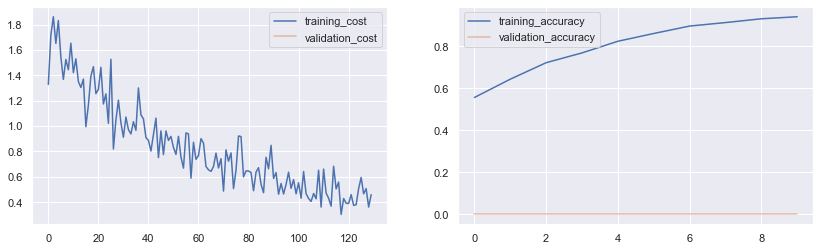

initial_cost:  3.2801  initial_acc:  0.099
epoch_0  --> cost_train:  1.687492 train_acc:  0.5576  -- cost_val:  0  val_acc:  0  ==> grads:  0.02207
epoch_1  --> cost_train:  1.499465 train_acc:  0.6461  -- cost_val:  0  val_acc:  0  ==> grads:  0.02181
epoch_2  --> cost_train:  1.351431 train_acc:  0.7219  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_3  --> cost_train:  1.221671 train_acc:  0.7932  -- cost_val:  0  val_acc:  0  ==> grads:  0.02043
epoch_4  --> cost_train:  1.124517 train_acc:  0.8275  -- cost_val:  0  val_acc:  0  ==> grads:  0.02029
epoch_5  --> cost_train:  1.041635 train_acc:  0.8715  -- cost_val:  0  val_acc:  0  ==> grads:  0.02426
epoch_6  --> cost_train:  0.978721 train_acc:  0.8983  -- cost_val:  0  val_acc:  0  ==> grads:  0.02273
epoch_7  --> cost_train:  0.919941 train_acc:  0.9151  -- cost_val:  0  val_acc:  0  ==> grads:  0.0231
epoch_8  --> cost_train:  0.869265 train_acc:  0.929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01975
epoch_9  --> c

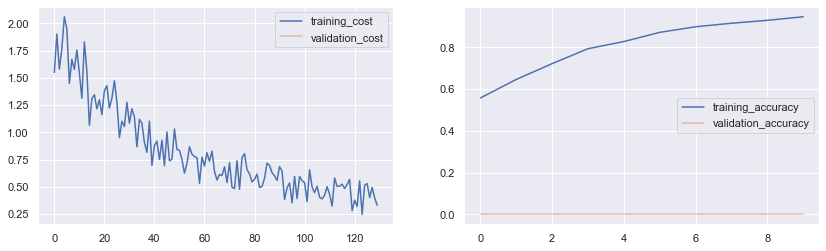

initial_cost:  3.1315  initial_acc:  0.0988
epoch_0  --> cost_train:  1.682115 train_acc:  0.5448  -- cost_val:  0  val_acc:  0  ==> grads:  0.02203
epoch_1  --> cost_train:  1.475838 train_acc:  0.6465  -- cost_val:  0  val_acc:  0  ==> grads:  0.02555
epoch_2  --> cost_train:  1.334449 train_acc:  0.73  -- cost_val:  0  val_acc:  0  ==> grads:  0.02515
epoch_3  --> cost_train:  1.233792 train_acc:  0.7812  -- cost_val:  0  val_acc:  0  ==> grads:  0.01878
epoch_4  --> cost_train:  1.134846 train_acc:  0.8253  -- cost_val:  0  val_acc:  0  ==> grads:  0.01903
epoch_5  --> cost_train:  1.060644 train_acc:  0.8687  -- cost_val:  0  val_acc:  0  ==> grads:  0.02111
epoch_6  --> cost_train:  1.001003 train_acc:  0.8951  -- cost_val:  0  val_acc:  0  ==> grads:  0.02097
epoch_7  --> cost_train:  0.945457 train_acc:  0.9077  -- cost_val:  0  val_acc:  0  ==> grads:  0.02739
epoch_8  --> cost_train:  0.888901 train_acc:  0.9243  -- cost_val:  0  val_acc:  0  ==> grads:  0.02141
epoch_9  --> 

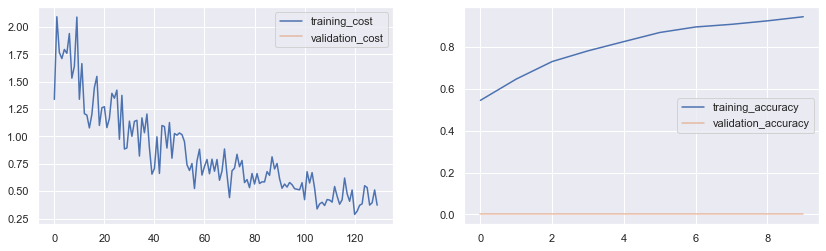

initial_cost:  3.2131  initial_acc:  0.0913
epoch_0  --> cost_train:  1.741508 train_acc:  0.559  -- cost_val:  0  val_acc:  0  ==> grads:  0.02316
epoch_1  --> cost_train:  1.432062 train_acc:  0.6556  -- cost_val:  0  val_acc:  0  ==> grads:  0.02125
epoch_2  --> cost_train:  1.299756 train_acc:  0.7268  -- cost_val:  0  val_acc:  0  ==> grads:  0.02379
epoch_3  --> cost_train:  1.197985 train_acc:  0.7981  -- cost_val:  0  val_acc:  0  ==> grads:  0.01676
epoch_4  --> cost_train:  1.111763 train_acc:  0.8256  -- cost_val:  0  val_acc:  0  ==> grads:  0.02554
epoch_5  --> cost_train:  1.036272 train_acc:  0.8665  -- cost_val:  0  val_acc:  0  ==> grads:  0.01664
epoch_6  --> cost_train:  0.969202 train_acc:  0.8924  -- cost_val:  0  val_acc:  0  ==> grads:  0.02073
epoch_7  --> cost_train:  0.911151 train_acc:  0.9122  -- cost_val:  0  val_acc:  0  ==> grads:  0.01798
epoch_8  --> cost_train:  0.863551 train_acc:  0.9319  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_9  -->

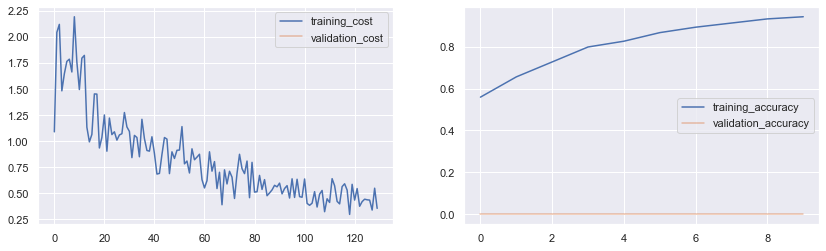

initial_cost:  3.2473  initial_acc:  0.0869
epoch_0  --> cost_train:  1.680662 train_acc:  0.5585  -- cost_val:  0  val_acc:  0  ==> grads:  0.0233
epoch_1  --> cost_train:  1.424762 train_acc:  0.659  -- cost_val:  0  val_acc:  0  ==> grads:  0.02252
epoch_2  --> cost_train:  1.298223 train_acc:  0.7294  -- cost_val:  0  val_acc:  0  ==> grads:  0.02274
epoch_3  --> cost_train:  1.187844 train_acc:  0.7745  -- cost_val:  0  val_acc:  0  ==> grads:  0.02308
epoch_4  --> cost_train:  1.09986 train_acc:  0.8303  -- cost_val:  0  val_acc:  0  ==> grads:  0.02111
epoch_5  --> cost_train:  1.027914 train_acc:  0.868  -- cost_val:  0  val_acc:  0  ==> grads:  0.01864
epoch_6  --> cost_train:  0.962151 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01841
epoch_7  --> cost_train:  0.902325 train_acc:  0.9166  -- cost_val:  0  val_acc:  0  ==> grads:  0.01947
epoch_8  --> cost_train:  0.85397 train_acc:  0.9292  -- cost_val:  0  val_acc:  0  ==> grads:  0.02157
epoch_9  --> cos

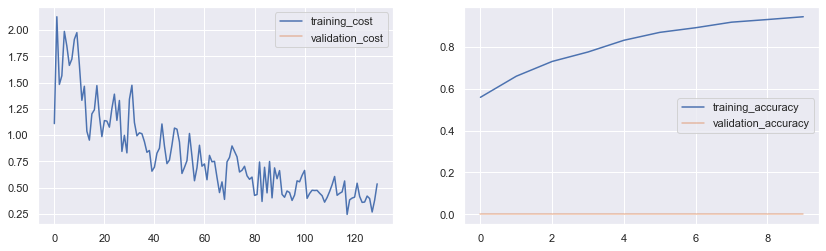

initial_cost:  3.1883  initial_acc:  0.1017
epoch_0  --> cost_train:  1.660108 train_acc:  0.5412  -- cost_val:  0  val_acc:  0  ==> grads:  0.02163
epoch_1  --> cost_train:  1.448746 train_acc:  0.6664  -- cost_val:  0  val_acc:  0  ==> grads:  0.02302
epoch_2  --> cost_train:  1.328923 train_acc:  0.7237  -- cost_val:  0  val_acc:  0  ==> grads:  0.02068
epoch_3  --> cost_train:  1.217804 train_acc:  0.7988  -- cost_val:  0  val_acc:  0  ==> grads:  0.02425
epoch_4  --> cost_train:  1.122438 train_acc:  0.8366  -- cost_val:  0  val_acc:  0  ==> grads:  0.01961
epoch_5  --> cost_train:  1.046505 train_acc:  0.8666  -- cost_val:  0  val_acc:  0  ==> grads:  0.02227
epoch_6  --> cost_train:  0.981342 train_acc:  0.8971  -- cost_val:  0  val_acc:  0  ==> grads:  0.02327
epoch_7  --> cost_train:  0.919002 train_acc:  0.9121  -- cost_val:  0  val_acc:  0  ==> grads:  0.01404
epoch_8  --> cost_train:  0.871732 train_acc:  0.928  -- cost_val:  0  val_acc:  0  ==> grads:  0.01639
epoch_9  -->

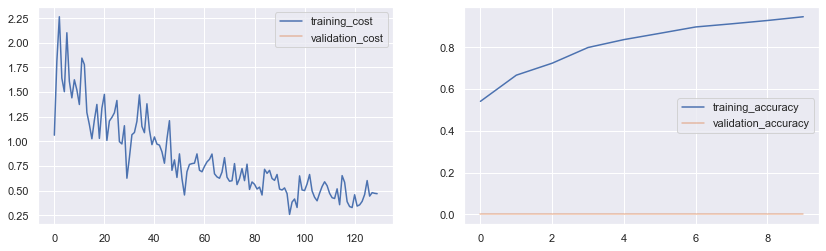

initial_cost:  3.355  initial_acc:  0.1225
epoch_0  --> cost_train:  1.742077 train_acc:  0.5457  -- cost_val:  0  val_acc:  0  ==> grads:  0.02046
epoch_1  --> cost_train:  1.498862 train_acc:  0.6571  -- cost_val:  0  val_acc:  0  ==> grads:  0.02214
epoch_2  --> cost_train:  1.353515 train_acc:  0.7149  -- cost_val:  0  val_acc:  0  ==> grads:  0.02107
epoch_3  --> cost_train:  1.25204 train_acc:  0.7719  -- cost_val:  0  val_acc:  0  ==> grads:  0.01924
epoch_4  --> cost_train:  1.156577 train_acc:  0.8226  -- cost_val:  0  val_acc:  0  ==> grads:  0.01946
epoch_5  --> cost_train:  1.070735 train_acc:  0.848  -- cost_val:  0  val_acc:  0  ==> grads:  0.0176
epoch_6  --> cost_train:  1.0058 train_acc:  0.8841  -- cost_val:  0  val_acc:  0  ==> grads:  0.02291
epoch_7  --> cost_train:  0.942622 train_acc:  0.9046  -- cost_val:  0  val_acc:  0  ==> grads:  0.02139
epoch_8  --> cost_train:  0.887368 train_acc:  0.9233  -- cost_val:  0  val_acc:  0  ==> grads:  0.01591
epoch_9  --> cost

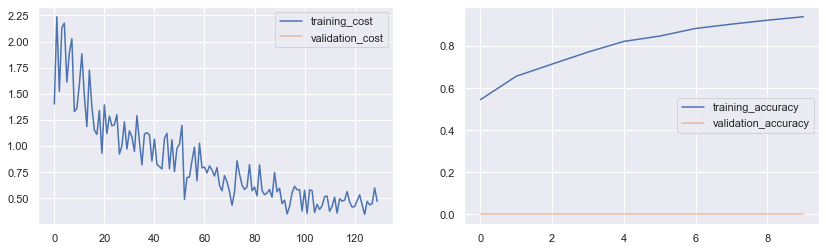

initial_cost:  3.2239  initial_acc:  0.1053
epoch_0  --> cost_train:  1.672815 train_acc:  0.5513  -- cost_val:  0  val_acc:  0  ==> grads:  0.02558
epoch_1  --> cost_train:  1.424365 train_acc:  0.6497  -- cost_val:  0  val_acc:  0  ==> grads:  0.01939
epoch_2  --> cost_train:  1.287023 train_acc:  0.7235  -- cost_val:  0  val_acc:  0  ==> grads:  0.0228
epoch_3  --> cost_train:  1.1958 train_acc:  0.7817  -- cost_val:  0  val_acc:  0  ==> grads:  0.02876
epoch_4  --> cost_train:  1.120902 train_acc:  0.8328  -- cost_val:  0  val_acc:  0  ==> grads:  0.02293
epoch_5  --> cost_train:  1.044496 train_acc:  0.8543  -- cost_val:  0  val_acc:  0  ==> grads:  0.02278
epoch_6  --> cost_train:  0.987407 train_acc:  0.8912  -- cost_val:  0  val_acc:  0  ==> grads:  0.02306
epoch_7  --> cost_train:  0.926779 train_acc:  0.9044  -- cost_val:  0  val_acc:  0  ==> grads:  0.01758
epoch_8  --> cost_train:  0.877182 train_acc:  0.9226  -- cost_val:  0  val_acc:  0  ==> grads:  0.0208
epoch_9  --> co

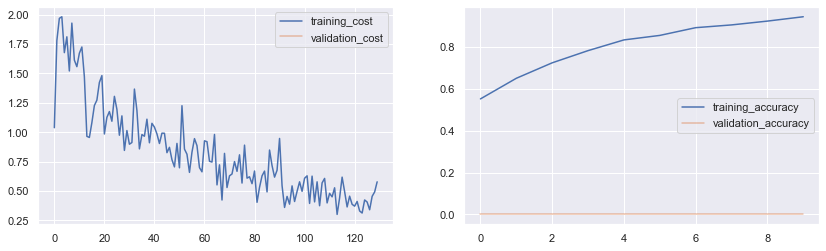

initial_cost:  3.3342  initial_acc:  0.1072
epoch_0  --> cost_train:  1.668815 train_acc:  0.5496  -- cost_val:  0  val_acc:  0  ==> grads:  0.0238
epoch_1  --> cost_train:  1.482554 train_acc:  0.6587  -- cost_val:  0  val_acc:  0  ==> grads:  0.02189
epoch_2  --> cost_train:  1.331979 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.0191
epoch_3  --> cost_train:  1.21351 train_acc:  0.7824  -- cost_val:  0  val_acc:  0  ==> grads:  0.02472
epoch_4  --> cost_train:  1.118015 train_acc:  0.8305  -- cost_val:  0  val_acc:  0  ==> grads:  0.0209
epoch_5  --> cost_train:  1.038371 train_acc:  0.8546  -- cost_val:  0  val_acc:  0  ==> grads:  0.01808
epoch_6  --> cost_train:  0.976351 train_acc:  0.884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01792
epoch_7  --> cost_train:  0.919252 train_acc:  0.9059  -- cost_val:  0  val_acc:  0  ==> grads:  0.01483
epoch_8  --> cost_train:  0.875707 train_acc:  0.9186  -- cost_val:  0  val_acc:  0  ==> grads:  0.01837
epoch_9  --> cos

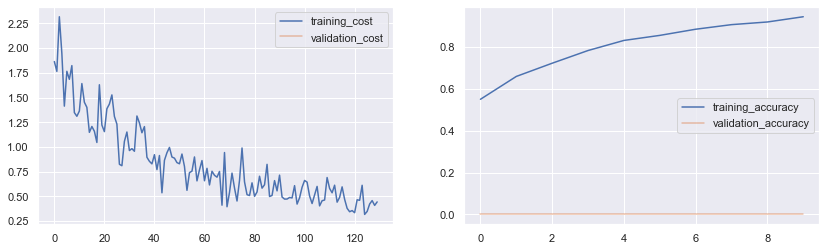

initial_cost:  3.1795  initial_acc:  0.102
epoch_0  --> cost_train:  1.671431 train_acc:  0.556  -- cost_val:  0  val_acc:  0  ==> grads:  0.02261
epoch_1  --> cost_train:  1.477065 train_acc:  0.653  -- cost_val:  0  val_acc:  0  ==> grads:  0.02745
epoch_2  --> cost_train:  1.339482 train_acc:  0.725  -- cost_val:  0  val_acc:  0  ==> grads:  0.0239
epoch_3  --> cost_train:  1.227969 train_acc:  0.7851  -- cost_val:  0  val_acc:  0  ==> grads:  0.02539
epoch_4  --> cost_train:  1.142428 train_acc:  0.8268  -- cost_val:  0  val_acc:  0  ==> grads:  0.01524
epoch_5  --> cost_train:  1.059926 train_acc:  0.8581  -- cost_val:  0  val_acc:  0  ==> grads:  0.01929
epoch_6  --> cost_train:  0.988999 train_acc:  0.889  -- cost_val:  0  val_acc:  0  ==> grads:  0.02132
epoch_7  --> cost_train:  0.930562 train_acc:  0.9071  -- cost_val:  0  val_acc:  0  ==> grads:  0.02206
epoch_8  --> cost_train:  0.876542 train_acc:  0.9227  -- cost_val:  0  val_acc:  0  ==> grads:  0.02273
epoch_9  --> cost

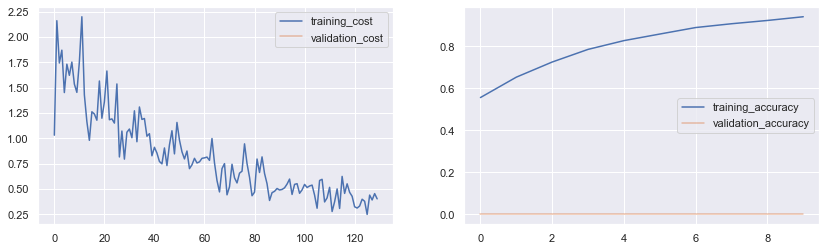

In [167]:
trials = 20
losses = []
for t in range(trials):
    nn_madam = NN_madam(size_h_layer=(X__.shape[1], 512,512, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.00005, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(0, (0,0.5,0.5)),
                              optimizer=('madam',{'beta1':0.9, 'beta2':0.999}),
                              plot_cost=False, print_=1, plots=1)
    nn_madam.train_nn(X__, y__, epochs= 10, batch_size=32, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_madam.tr_batch_cost)

In [166]:
madam_cifar10 = losses.copy()

In [ ]:
madam = np.zeros((len(madam_cifar10[0]), len(madam_cifar10)))
for i in range(len(madam_cifar10)):
    madam[:,i] = madam_cifar10[i]

### Adam on CIFAR10

initial_cost:  3.1298  initial_acc:  0.1046
epoch_0  --> cost_train:  1.631354 train_acc:  0.538  -- cost_val:  0  val_acc:  0  ==> grads:  0.02223
epoch_1  --> cost_train:  1.4607 train_acc:  0.6527  -- cost_val:  0  val_acc:  0  ==> grads:  0.02532
epoch_2  --> cost_train:  1.334813 train_acc:  0.7119  -- cost_val:  0  val_acc:  0  ==> grads:  0.02264
epoch_3  --> cost_train:  1.230021 train_acc:  0.761  -- cost_val:  0  val_acc:  0  ==> grads:  0.0225
epoch_4  --> cost_train:  1.136466 train_acc:  0.8187  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_5  --> cost_train:  1.060492 train_acc:  0.8537  -- cost_val:  0  val_acc:  0  ==> grads:  0.01833
epoch_6  --> cost_train:  1.001811 train_acc:  0.8811  -- cost_val:  0  val_acc:  0  ==> grads:  0.02089
epoch_7  --> cost_train:  0.946219 train_acc:  0.9024  -- cost_val:  0  val_acc:  0  ==> grads:  0.02036
epoch_8  --> cost_train:  0.895275 train_acc:  0.921  -- cost_val:  0  val_acc:  0  ==> grads:  0.01986
epoch_9  --> cost

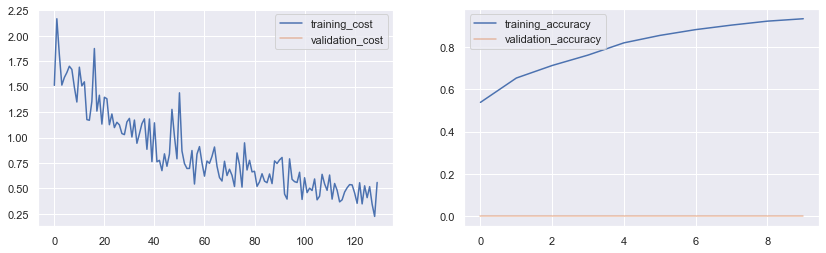

initial_cost:  3.2142  initial_acc:  0.0807
epoch_0  --> cost_train:  1.545669 train_acc:  0.5531  -- cost_val:  0  val_acc:  0  ==> grads:  0.02544
epoch_1  --> cost_train:  1.387512 train_acc:  0.662  -- cost_val:  0  val_acc:  0  ==> grads:  0.02196
epoch_2  --> cost_train:  1.277862 train_acc:  0.7319  -- cost_val:  0  val_acc:  0  ==> grads:  0.02122
epoch_3  --> cost_train:  1.169588 train_acc:  0.7881  -- cost_val:  0  val_acc:  0  ==> grads:  0.02364
epoch_4  --> cost_train:  1.085523 train_acc:  0.836  -- cost_val:  0  val_acc:  0  ==> grads:  0.02105
epoch_5  --> cost_train:  1.017971 train_acc:  0.8659  -- cost_val:  0  val_acc:  0  ==> grads:  0.02298
epoch_6  --> cost_train:  0.957402 train_acc:  0.8875  -- cost_val:  0  val_acc:  0  ==> grads:  0.01914
epoch_7  --> cost_train:  0.899695 train_acc:  0.9068  -- cost_val:  0  val_acc:  0  ==> grads:  0.02215
epoch_8  --> cost_train:  0.855884 train_acc:  0.9347  -- cost_val:  0  val_acc:  0  ==> grads:  0.02123
epoch_9  --> 

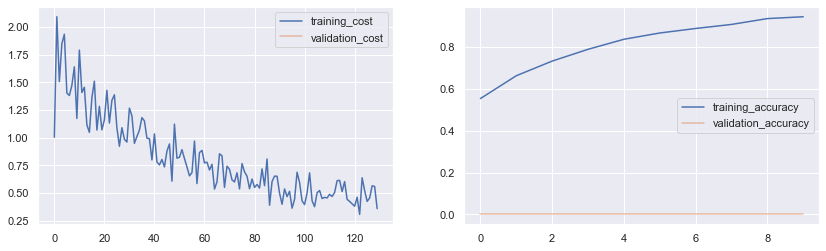

initial_cost:  3.6178  initial_acc:  0.0664
epoch_0  --> cost_train:  1.806531 train_acc:  0.5469  -- cost_val:  0  val_acc:  0  ==> grads:  0.02331
epoch_1  --> cost_train:  1.536842 train_acc:  0.6445  -- cost_val:  0  val_acc:  0  ==> grads:  0.0191
epoch_2  --> cost_train:  1.371579 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02486
epoch_3  --> cost_train:  1.263542 train_acc:  0.786  -- cost_val:  0  val_acc:  0  ==> grads:  0.01827
epoch_4  --> cost_train:  1.168777 train_acc:  0.8169  -- cost_val:  0  val_acc:  0  ==> grads:  0.01999
epoch_5  --> cost_train:  1.081921 train_acc:  0.8612  -- cost_val:  0  val_acc:  0  ==> grads:  0.02161
epoch_6  --> cost_train:  1.007651 train_acc:  0.8924  -- cost_val:  0  val_acc:  0  ==> grads:  0.01705
epoch_7  --> cost_train:  0.951362 train_acc:  0.913  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_8  --> cost_train:  0.895383 train_acc:  0.9302  -- cost_val:  0  val_acc:  0  ==> grads:  0.01552
epoch_9  --> c

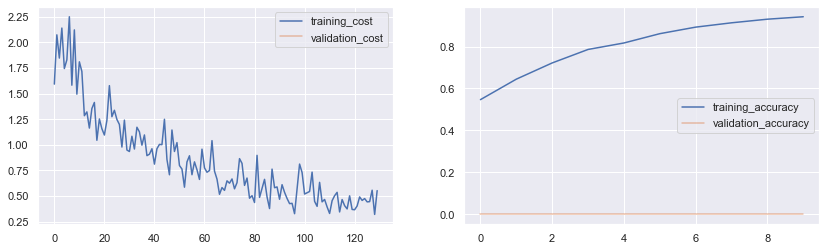

initial_cost:  3.3914  initial_acc:  0.0962
epoch_0  --> cost_train:  1.585254 train_acc:  0.553  -- cost_val:  0  val_acc:  0  ==> grads:  0.02459
epoch_1  --> cost_train:  1.389942 train_acc:  0.6458  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_2  --> cost_train:  1.245874 train_acc:  0.7314  -- cost_val:  0  val_acc:  0  ==> grads:  0.02083
epoch_3  --> cost_train:  1.153648 train_acc:  0.783  -- cost_val:  0  val_acc:  0  ==> grads:  0.01891
epoch_4  --> cost_train:  1.076232 train_acc:  0.8241  -- cost_val:  0  val_acc:  0  ==> grads:  0.01904
epoch_5  --> cost_train:  1.008622 train_acc:  0.8696  -- cost_val:  0  val_acc:  0  ==> grads:  0.02304
epoch_6  --> cost_train:  0.949964 train_acc:  0.8884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01935
epoch_7  --> cost_train:  0.900702 train_acc:  0.908  -- cost_val:  0  val_acc:  0  ==> grads:  0.01556
epoch_8  --> cost_train:  0.858909 train_acc:  0.929  -- cost_val:  0  val_acc:  0  ==> grads:  0.02168
epoch_9  --> co

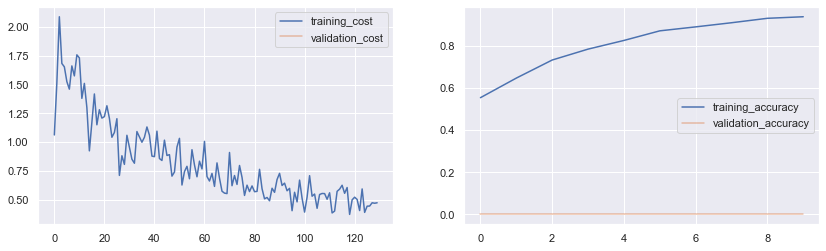

initial_cost:  3.2559  initial_acc:  0.1021
epoch_0  --> cost_train:  1.608362 train_acc:  0.5603  -- cost_val:  0  val_acc:  0  ==> grads:  0.02013
epoch_1  --> cost_train:  1.424073 train_acc:  0.6451  -- cost_val:  0  val_acc:  0  ==> grads:  0.02188
epoch_2  --> cost_train:  1.313154 train_acc:  0.7382  -- cost_val:  0  val_acc:  0  ==> grads:  0.02709
epoch_3  --> cost_train:  1.20219 train_acc:  0.7857  -- cost_val:  0  val_acc:  0  ==> grads:  0.02142
epoch_4  --> cost_train:  1.123091 train_acc:  0.8254  -- cost_val:  0  val_acc:  0  ==> grads:  0.02683
epoch_5  --> cost_train:  1.042035 train_acc:  0.8598  -- cost_val:  0  val_acc:  0  ==> grads:  0.02153
epoch_6  --> cost_train:  0.98572 train_acc:  0.8876  -- cost_val:  0  val_acc:  0  ==> grads:  0.02155
epoch_7  --> cost_train:  0.924846 train_acc:  0.9114  -- cost_val:  0  val_acc:  0  ==> grads:  0.01968
epoch_8  --> cost_train:  0.87604 train_acc:  0.9301  -- cost_val:  0  val_acc:  0  ==> grads:  0.01903
epoch_9  --> c

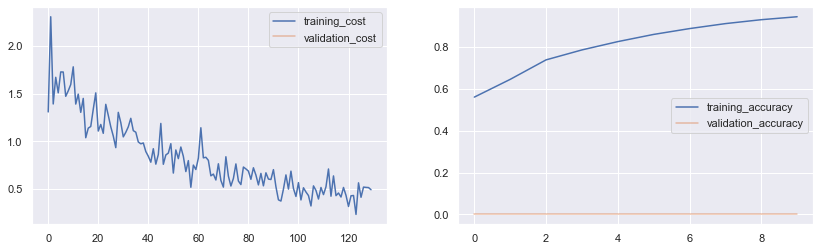

initial_cost:  3.1441  initial_acc:  0.1005
epoch_0  --> cost_train:  1.518362 train_acc:  0.5552  -- cost_val:  0  val_acc:  0  ==> grads:  0.02383
epoch_1  --> cost_train:  1.382304 train_acc:  0.6512  -- cost_val:  0  val_acc:  0  ==> grads:  0.02382
epoch_2  --> cost_train:  1.273867 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02269
epoch_3  --> cost_train:  1.189025 train_acc:  0.7719  -- cost_val:  0  val_acc:  0  ==> grads:  0.02057
epoch_4  --> cost_train:  1.104892 train_acc:  0.8252  -- cost_val:  0  val_acc:  0  ==> grads:  0.01699
epoch_5  --> cost_train:  1.035559 train_acc:  0.8585  -- cost_val:  0  val_acc:  0  ==> grads:  0.01886
epoch_6  --> cost_train:  0.982084 train_acc:  0.8912  -- cost_val:  0  val_acc:  0  ==> grads:  0.01991
epoch_7  --> cost_train:  0.922295 train_acc:  0.8986  -- cost_val:  0  val_acc:  0  ==> grads:  0.01703
epoch_8  --> cost_train:  0.870449 train_acc:  0.9246  -- cost_val:  0  val_acc:  0  ==> grads:  0.01707
epoch_9  --

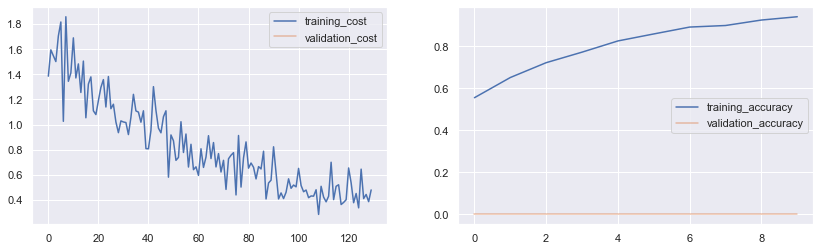

initial_cost:  3.5638  initial_acc:  0.1035
epoch_0  --> cost_train:  1.741577 train_acc:  0.5413  -- cost_val:  0  val_acc:  0  ==> grads:  0.02537
epoch_1  --> cost_train:  1.440565 train_acc:  0.6629  -- cost_val:  0  val_acc:  0  ==> grads:  0.02219
epoch_2  --> cost_train:  1.315997 train_acc:  0.7242  -- cost_val:  0  val_acc:  0  ==> grads:  0.02112
epoch_3  --> cost_train:  1.201977 train_acc:  0.7857  -- cost_val:  0  val_acc:  0  ==> grads:  0.01947
epoch_4  --> cost_train:  1.130332 train_acc:  0.8341  -- cost_val:  0  val_acc:  0  ==> grads:  0.02703
epoch_5  --> cost_train:  1.052069 train_acc:  0.8672  -- cost_val:  0  val_acc:  0  ==> grads:  0.01811
epoch_6  --> cost_train:  0.980769 train_acc:  0.8815  -- cost_val:  0  val_acc:  0  ==> grads:  0.01719
epoch_7  --> cost_train:  0.925664 train_acc:  0.9017  -- cost_val:  0  val_acc:  0  ==> grads:  0.01967
epoch_8  --> cost_train:  0.876545 train_acc:  0.934  -- cost_val:  0  val_acc:  0  ==> grads:  0.01605
epoch_9  -->

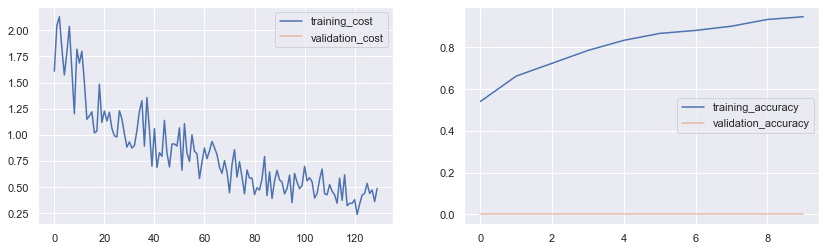

initial_cost:  3.3832  initial_acc:  0.0813
epoch_0  --> cost_train:  1.601362 train_acc:  0.5374  -- cost_val:  0  val_acc:  0  ==> grads:  0.02119
epoch_1  --> cost_train:  1.417708 train_acc:  0.6444  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_2  --> cost_train:  1.3215 train_acc:  0.7214  -- cost_val:  0  val_acc:  0  ==> grads:  0.02012
epoch_3  --> cost_train:  1.216506 train_acc:  0.7771  -- cost_val:  0  val_acc:  0  ==> grads:  0.02335
epoch_4  --> cost_train:  1.143203 train_acc:  0.8217  -- cost_val:  0  val_acc:  0  ==> grads:  0.02345
epoch_5  --> cost_train:  1.064679 train_acc:  0.8606  -- cost_val:  0  val_acc:  0  ==> grads:  0.02086
epoch_6  --> cost_train:  0.999244 train_acc:  0.877  -- cost_val:  0  val_acc:  0  ==> grads:  0.02461
epoch_7  --> cost_train:  0.940435 train_acc:  0.9055  -- cost_val:  0  val_acc:  0  ==> grads:  0.01836
epoch_8  --> cost_train:  0.890477 train_acc:  0.922  -- cost_val:  0  val_acc:  0  ==> grads:  0.0208
epoch_9  --> cos

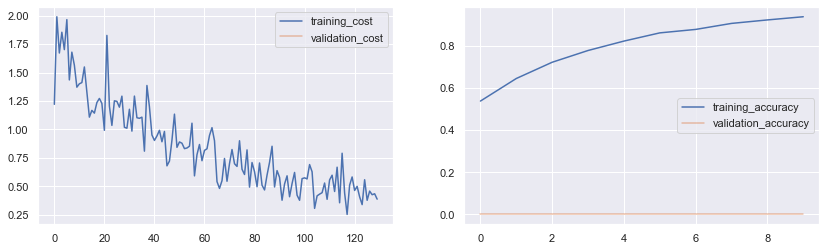

initial_cost:  3.0803  initial_acc:  0.0907
epoch_0  --> cost_train:  1.706962 train_acc:  0.5486  -- cost_val:  0  val_acc:  0  ==> grads:  0.02448
epoch_1  --> cost_train:  1.444738 train_acc:  0.6394  -- cost_val:  0  val_acc:  0  ==> grads:  0.02552
epoch_2  --> cost_train:  1.320015 train_acc:  0.7206  -- cost_val:  0  val_acc:  0  ==> grads:  0.02154
epoch_3  --> cost_train:  1.189694 train_acc:  0.7867  -- cost_val:  0  val_acc:  0  ==> grads:  0.01874
epoch_4  --> cost_train:  1.106862 train_acc:  0.8192  -- cost_val:  0  val_acc:  0  ==> grads:  0.01963
epoch_5  --> cost_train:  1.032006 train_acc:  0.8557  -- cost_val:  0  val_acc:  0  ==> grads:  0.01499
epoch_6  --> cost_train:  0.968938 train_acc:  0.8918  -- cost_val:  0  val_acc:  0  ==> grads:  0.02142
epoch_7  --> cost_train:  0.909157 train_acc:  0.915  -- cost_val:  0  val_acc:  0  ==> grads:  0.01827
epoch_8  --> cost_train:  0.857173 train_acc:  0.9245  -- cost_val:  0  val_acc:  0  ==> grads:  0.01799
epoch_9  -->

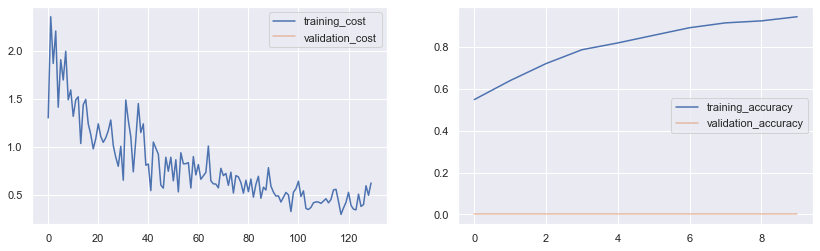

initial_cost:  3.4105  initial_acc:  0.0949
epoch_0  --> cost_train:  1.598 train_acc:  0.5425  -- cost_val:  0  val_acc:  0  ==> grads:  0.02838
epoch_1  --> cost_train:  1.440627 train_acc:  0.6468  -- cost_val:  0  val_acc:  0  ==> grads:  0.02663
epoch_2  --> cost_train:  1.316515 train_acc:  0.7188  -- cost_val:  0  val_acc:  0  ==> grads:  0.02827
epoch_3  --> cost_train:  1.195798 train_acc:  0.7783  -- cost_val:  0  val_acc:  0  ==> grads:  0.02583
epoch_4  --> cost_train:  1.117692 train_acc:  0.8302  -- cost_val:  0  val_acc:  0  ==> grads:  0.02347
epoch_5  --> cost_train:  1.045168 train_acc:  0.8548  -- cost_val:  0  val_acc:  0  ==> grads:  0.02639
epoch_6  --> cost_train:  0.980101 train_acc:  0.8792  -- cost_val:  0  val_acc:  0  ==> grads:  0.02468
epoch_7  --> cost_train:  0.928156 train_acc:  0.9037  -- cost_val:  0  val_acc:  0  ==> grads:  0.01645
epoch_8  --> cost_train:  0.877905 train_acc:  0.9285  -- cost_val:  0  val_acc:  0  ==> grads:  0.01338
epoch_9  --> c

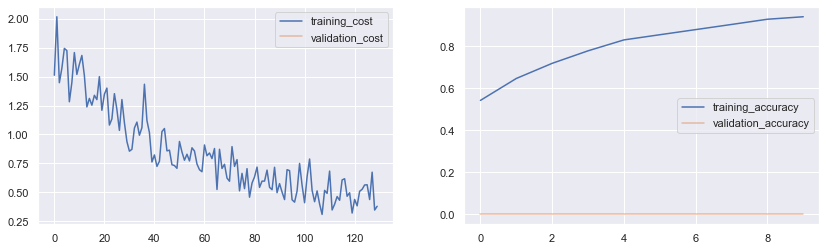

initial_cost:  3.1381  initial_acc:  0.0841
epoch_0  --> cost_train:  1.556954 train_acc:  0.5563  -- cost_val:  0  val_acc:  0  ==> grads:  0.02104
epoch_1  --> cost_train:  1.420492 train_acc:  0.6434  -- cost_val:  0  val_acc:  0  ==> grads:  0.0186
epoch_2  --> cost_train:  1.291738 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.02158
epoch_3  --> cost_train:  1.189283 train_acc:  0.7684  -- cost_val:  0  val_acc:  0  ==> grads:  0.01872
epoch_4  --> cost_train:  1.109905 train_acc:  0.8237  -- cost_val:  0  val_acc:  0  ==> grads:  0.02266
epoch_5  --> cost_train:  1.044635 train_acc:  0.8607  -- cost_val:  0  val_acc:  0  ==> grads:  0.01779
epoch_6  --> cost_train:  0.985481 train_acc:  0.896  -- cost_val:  0  val_acc:  0  ==> grads:  0.01895
epoch_7  --> cost_train:  0.928969 train_acc:  0.9126  -- cost_val:  0  val_acc:  0  ==> grads:  0.01718
epoch_8  --> cost_train:  0.880652 train_acc:  0.9306  -- cost_val:  0  val_acc:  0  ==> grads:  0.01811
epoch_9  --> 

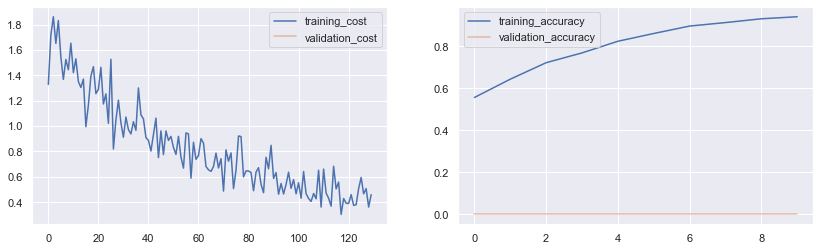

initial_cost:  3.2801  initial_acc:  0.099
epoch_0  --> cost_train:  1.687492 train_acc:  0.5576  -- cost_val:  0  val_acc:  0  ==> grads:  0.02207
epoch_1  --> cost_train:  1.499465 train_acc:  0.6461  -- cost_val:  0  val_acc:  0  ==> grads:  0.02181
epoch_2  --> cost_train:  1.351431 train_acc:  0.7219  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_3  --> cost_train:  1.221671 train_acc:  0.7932  -- cost_val:  0  val_acc:  0  ==> grads:  0.02043
epoch_4  --> cost_train:  1.124517 train_acc:  0.8275  -- cost_val:  0  val_acc:  0  ==> grads:  0.02029
epoch_5  --> cost_train:  1.041635 train_acc:  0.8715  -- cost_val:  0  val_acc:  0  ==> grads:  0.02426
epoch_6  --> cost_train:  0.978721 train_acc:  0.8983  -- cost_val:  0  val_acc:  0  ==> grads:  0.02273
epoch_7  --> cost_train:  0.919941 train_acc:  0.9151  -- cost_val:  0  val_acc:  0  ==> grads:  0.0231
epoch_8  --> cost_train:  0.869265 train_acc:  0.929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01975
epoch_9  --> c

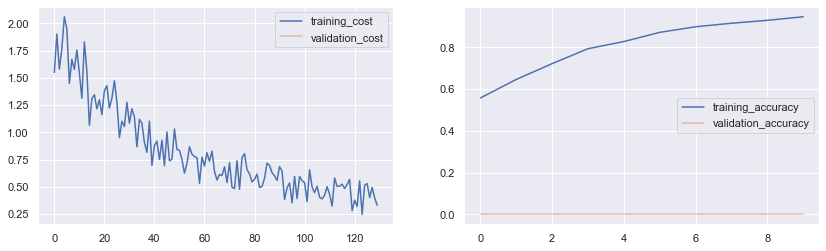

initial_cost:  3.1315  initial_acc:  0.0988
epoch_0  --> cost_train:  1.682115 train_acc:  0.5448  -- cost_val:  0  val_acc:  0  ==> grads:  0.02203
epoch_1  --> cost_train:  1.475838 train_acc:  0.6465  -- cost_val:  0  val_acc:  0  ==> grads:  0.02555
epoch_2  --> cost_train:  1.334449 train_acc:  0.73  -- cost_val:  0  val_acc:  0  ==> grads:  0.02515
epoch_3  --> cost_train:  1.233792 train_acc:  0.7812  -- cost_val:  0  val_acc:  0  ==> grads:  0.01878
epoch_4  --> cost_train:  1.134846 train_acc:  0.8253  -- cost_val:  0  val_acc:  0  ==> grads:  0.01903
epoch_5  --> cost_train:  1.060644 train_acc:  0.8687  -- cost_val:  0  val_acc:  0  ==> grads:  0.02111
epoch_6  --> cost_train:  1.001003 train_acc:  0.8951  -- cost_val:  0  val_acc:  0  ==> grads:  0.02097
epoch_7  --> cost_train:  0.945457 train_acc:  0.9077  -- cost_val:  0  val_acc:  0  ==> grads:  0.02739
epoch_8  --> cost_train:  0.888901 train_acc:  0.9243  -- cost_val:  0  val_acc:  0  ==> grads:  0.02141
epoch_9  --> 

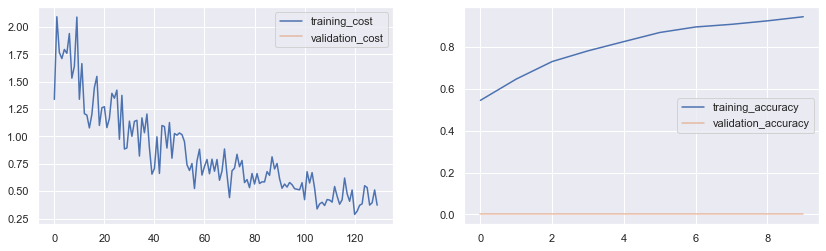

initial_cost:  3.2131  initial_acc:  0.0913
epoch_0  --> cost_train:  1.741508 train_acc:  0.559  -- cost_val:  0  val_acc:  0  ==> grads:  0.02316
epoch_1  --> cost_train:  1.432062 train_acc:  0.6556  -- cost_val:  0  val_acc:  0  ==> grads:  0.02125
epoch_2  --> cost_train:  1.299756 train_acc:  0.7268  -- cost_val:  0  val_acc:  0  ==> grads:  0.02379
epoch_3  --> cost_train:  1.197985 train_acc:  0.7981  -- cost_val:  0  val_acc:  0  ==> grads:  0.01676
epoch_4  --> cost_train:  1.111763 train_acc:  0.8256  -- cost_val:  0  val_acc:  0  ==> grads:  0.02554
epoch_5  --> cost_train:  1.036272 train_acc:  0.8665  -- cost_val:  0  val_acc:  0  ==> grads:  0.01664
epoch_6  --> cost_train:  0.969202 train_acc:  0.8924  -- cost_val:  0  val_acc:  0  ==> grads:  0.02073
epoch_7  --> cost_train:  0.911151 train_acc:  0.9122  -- cost_val:  0  val_acc:  0  ==> grads:  0.01798
epoch_8  --> cost_train:  0.863551 train_acc:  0.9319  -- cost_val:  0  val_acc:  0  ==> grads:  0.02162
epoch_9  -->

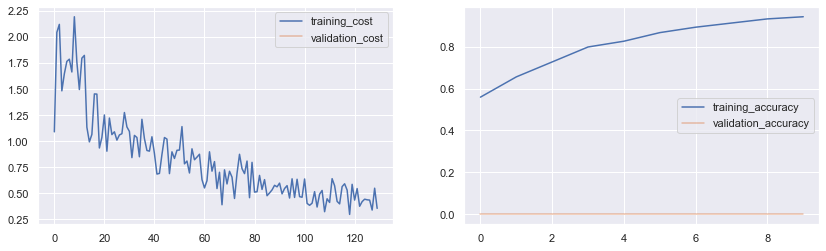

initial_cost:  3.2473  initial_acc:  0.0869
epoch_0  --> cost_train:  1.680662 train_acc:  0.5585  -- cost_val:  0  val_acc:  0  ==> grads:  0.0233
epoch_1  --> cost_train:  1.424762 train_acc:  0.659  -- cost_val:  0  val_acc:  0  ==> grads:  0.02252
epoch_2  --> cost_train:  1.298223 train_acc:  0.7294  -- cost_val:  0  val_acc:  0  ==> grads:  0.02274
epoch_3  --> cost_train:  1.187844 train_acc:  0.7745  -- cost_val:  0  val_acc:  0  ==> grads:  0.02308
epoch_4  --> cost_train:  1.09986 train_acc:  0.8303  -- cost_val:  0  val_acc:  0  ==> grads:  0.02111
epoch_5  --> cost_train:  1.027914 train_acc:  0.868  -- cost_val:  0  val_acc:  0  ==> grads:  0.01864
epoch_6  --> cost_train:  0.962151 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01841
epoch_7  --> cost_train:  0.902325 train_acc:  0.9166  -- cost_val:  0  val_acc:  0  ==> grads:  0.01947
epoch_8  --> cost_train:  0.85397 train_acc:  0.9292  -- cost_val:  0  val_acc:  0  ==> grads:  0.02157
epoch_9  --> cos

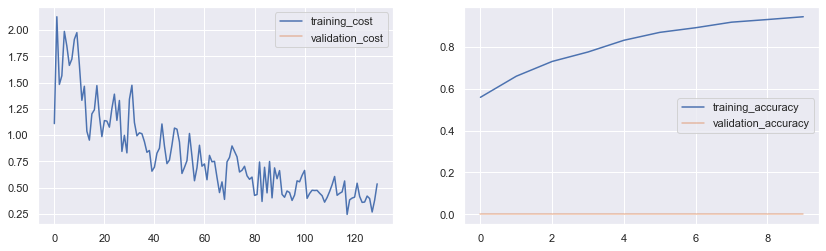

initial_cost:  3.1883  initial_acc:  0.1017
epoch_0  --> cost_train:  1.660108 train_acc:  0.5412  -- cost_val:  0  val_acc:  0  ==> grads:  0.02163
epoch_1  --> cost_train:  1.448746 train_acc:  0.6664  -- cost_val:  0  val_acc:  0  ==> grads:  0.02302
epoch_2  --> cost_train:  1.328923 train_acc:  0.7237  -- cost_val:  0  val_acc:  0  ==> grads:  0.02068
epoch_3  --> cost_train:  1.217804 train_acc:  0.7988  -- cost_val:  0  val_acc:  0  ==> grads:  0.02425
epoch_4  --> cost_train:  1.122438 train_acc:  0.8366  -- cost_val:  0  val_acc:  0  ==> grads:  0.01961
epoch_5  --> cost_train:  1.046505 train_acc:  0.8666  -- cost_val:  0  val_acc:  0  ==> grads:  0.02227
epoch_6  --> cost_train:  0.981342 train_acc:  0.8971  -- cost_val:  0  val_acc:  0  ==> grads:  0.02327
epoch_7  --> cost_train:  0.919002 train_acc:  0.9121  -- cost_val:  0  val_acc:  0  ==> grads:  0.01404
epoch_8  --> cost_train:  0.871732 train_acc:  0.928  -- cost_val:  0  val_acc:  0  ==> grads:  0.01639
epoch_9  -->

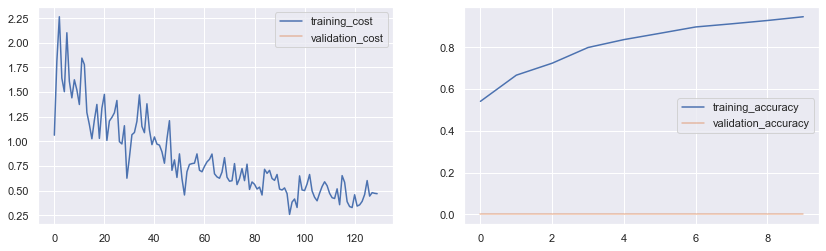

initial_cost:  3.355  initial_acc:  0.1225
epoch_0  --> cost_train:  1.742077 train_acc:  0.5457  -- cost_val:  0  val_acc:  0  ==> grads:  0.02046
epoch_1  --> cost_train:  1.498862 train_acc:  0.6571  -- cost_val:  0  val_acc:  0  ==> grads:  0.02214
epoch_2  --> cost_train:  1.353515 train_acc:  0.7149  -- cost_val:  0  val_acc:  0  ==> grads:  0.02107
epoch_3  --> cost_train:  1.25204 train_acc:  0.7719  -- cost_val:  0  val_acc:  0  ==> grads:  0.01924
epoch_4  --> cost_train:  1.156577 train_acc:  0.8226  -- cost_val:  0  val_acc:  0  ==> grads:  0.01946
epoch_5  --> cost_train:  1.070735 train_acc:  0.848  -- cost_val:  0  val_acc:  0  ==> grads:  0.0176
epoch_6  --> cost_train:  1.0058 train_acc:  0.8841  -- cost_val:  0  val_acc:  0  ==> grads:  0.02291
epoch_7  --> cost_train:  0.942622 train_acc:  0.9046  -- cost_val:  0  val_acc:  0  ==> grads:  0.02139
epoch_8  --> cost_train:  0.887368 train_acc:  0.9233  -- cost_val:  0  val_acc:  0  ==> grads:  0.01591
epoch_9  --> cost

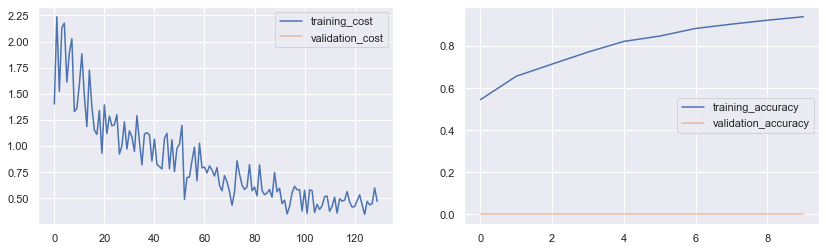

initial_cost:  3.2239  initial_acc:  0.1053
epoch_0  --> cost_train:  1.672815 train_acc:  0.5513  -- cost_val:  0  val_acc:  0  ==> grads:  0.02558
epoch_1  --> cost_train:  1.424365 train_acc:  0.6497  -- cost_val:  0  val_acc:  0  ==> grads:  0.01939
epoch_2  --> cost_train:  1.287023 train_acc:  0.7235  -- cost_val:  0  val_acc:  0  ==> grads:  0.0228
epoch_3  --> cost_train:  1.1958 train_acc:  0.7817  -- cost_val:  0  val_acc:  0  ==> grads:  0.02876
epoch_4  --> cost_train:  1.120902 train_acc:  0.8328  -- cost_val:  0  val_acc:  0  ==> grads:  0.02293
epoch_5  --> cost_train:  1.044496 train_acc:  0.8543  -- cost_val:  0  val_acc:  0  ==> grads:  0.02278
epoch_6  --> cost_train:  0.987407 train_acc:  0.8912  -- cost_val:  0  val_acc:  0  ==> grads:  0.02306
epoch_7  --> cost_train:  0.926779 train_acc:  0.9044  -- cost_val:  0  val_acc:  0  ==> grads:  0.01758
epoch_8  --> cost_train:  0.877182 train_acc:  0.9226  -- cost_val:  0  val_acc:  0  ==> grads:  0.0208
epoch_9  --> co

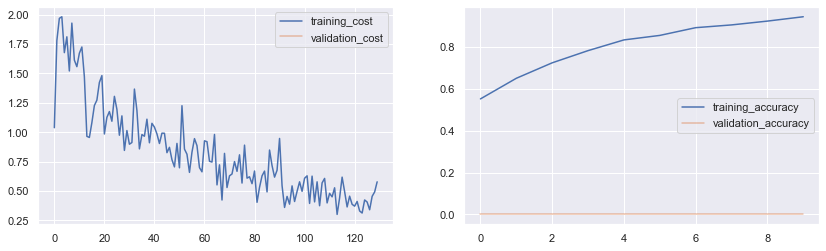

initial_cost:  3.3342  initial_acc:  0.1072
epoch_0  --> cost_train:  1.668815 train_acc:  0.5496  -- cost_val:  0  val_acc:  0  ==> grads:  0.0238
epoch_1  --> cost_train:  1.482554 train_acc:  0.6587  -- cost_val:  0  val_acc:  0  ==> grads:  0.02189
epoch_2  --> cost_train:  1.331979 train_acc:  0.7218  -- cost_val:  0  val_acc:  0  ==> grads:  0.0191
epoch_3  --> cost_train:  1.21351 train_acc:  0.7824  -- cost_val:  0  val_acc:  0  ==> grads:  0.02472
epoch_4  --> cost_train:  1.118015 train_acc:  0.8305  -- cost_val:  0  val_acc:  0  ==> grads:  0.0209
epoch_5  --> cost_train:  1.038371 train_acc:  0.8546  -- cost_val:  0  val_acc:  0  ==> grads:  0.01808
epoch_6  --> cost_train:  0.976351 train_acc:  0.884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01792
epoch_7  --> cost_train:  0.919252 train_acc:  0.9059  -- cost_val:  0  val_acc:  0  ==> grads:  0.01483
epoch_8  --> cost_train:  0.875707 train_acc:  0.9186  -- cost_val:  0  val_acc:  0  ==> grads:  0.01837
epoch_9  --> cos

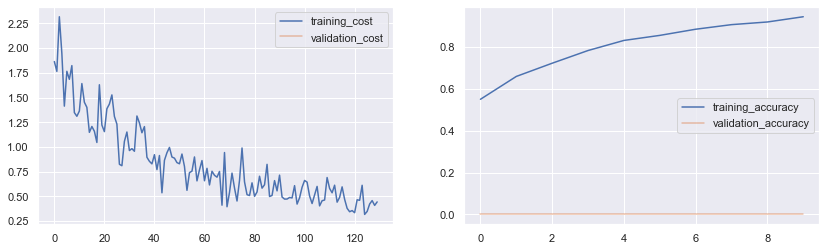

initial_cost:  3.1795  initial_acc:  0.102
epoch_0  --> cost_train:  1.671431 train_acc:  0.556  -- cost_val:  0  val_acc:  0  ==> grads:  0.02261
epoch_1  --> cost_train:  1.477065 train_acc:  0.653  -- cost_val:  0  val_acc:  0  ==> grads:  0.02745
epoch_2  --> cost_train:  1.339482 train_acc:  0.725  -- cost_val:  0  val_acc:  0  ==> grads:  0.0239
epoch_3  --> cost_train:  1.227969 train_acc:  0.7851  -- cost_val:  0  val_acc:  0  ==> grads:  0.02539
epoch_4  --> cost_train:  1.142428 train_acc:  0.8268  -- cost_val:  0  val_acc:  0  ==> grads:  0.01524
epoch_5  --> cost_train:  1.059926 train_acc:  0.8581  -- cost_val:  0  val_acc:  0  ==> grads:  0.01929
epoch_6  --> cost_train:  0.988999 train_acc:  0.889  -- cost_val:  0  val_acc:  0  ==> grads:  0.02132
epoch_7  --> cost_train:  0.930562 train_acc:  0.9071  -- cost_val:  0  val_acc:  0  ==> grads:  0.02206
epoch_8  --> cost_train:  0.876542 train_acc:  0.9227  -- cost_val:  0  val_acc:  0  ==> grads:  0.02273
epoch_9  --> cost

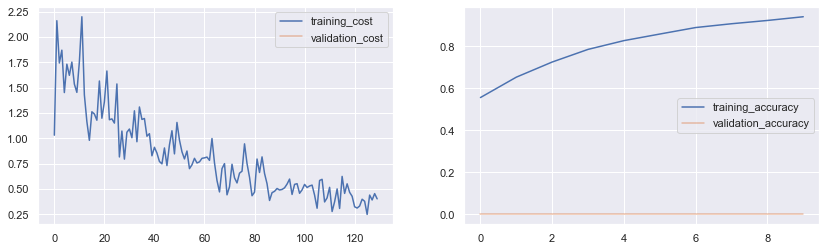

In [167]:
trials = 20
losses = []
for t in range(trials):
    nn_adam = NN_madam(size_h_layer=(X__.shape[1], 512,512, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.00005, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(0, (0,0.5,0.5)),
                              optimizer=('adam',{'beta1':0.9, 'beta2':0.999}),
                              plot_cost=False, print_=1, plots=1)
    nn_adam.train_nn(X__, y__, epochs= 10, batch_size=32, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_madam.tr_batch_cost)

In [ ]:
adam_cifar10 = losses.copy()

In [168]:
adam = np.zeros((len(adam_cifar10[0]), len(adam_cifar10)))
for i in range(len(adam_cifar10)):
    adam[:,i] = adam_cifar10[i]

### Results on CIFAR10

Text(0.5, 1.0, 'CIFAR10 Dataset - Avg losses over 20 x 10 epochs trials (batch_size=32)')

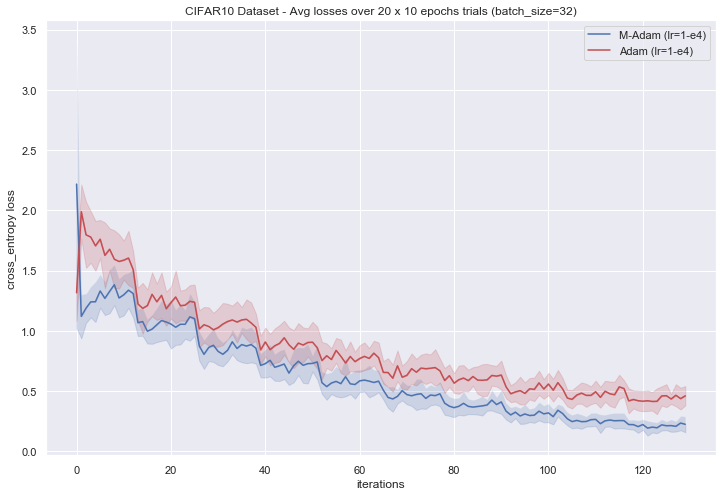

In [226]:

start = 0
plt.figure(figsize=(12,8))
plt.plot(madam.mean(axis=1)[start:], 'b')
plt.fill_between(np.arange(len(madam.mean(axis=1)[start:])), madam.mean(axis=1)[start:], madam.mean(axis=1)[start:] + madam.std(axis=1)[start:], alpha=0.2)
plt.fill_between(np.arange(len(madam.mean(axis=1)[start:])), madam.mean(axis=1)[start:], madam.mean(axis=1)[start:] - madam.std(axis=1)[start:], alpha=0.2,color='b')


plt.plot(adam.mean(axis=1)[start:], 'r')
plt.fill_between(np.arange(len(adam.mean(axis=1)[start:])), adam.mean(axis=1)[start:], adam.mean(axis=1)[start:] + adam.std(axis=1)[start:], alpha=0.2,color='r')
plt.fill_between(np.arange(len(adam.mean(axis=1)[start:])), adam.mean(axis=1)[start:], adam.mean(axis=1)[start:] - adam.std(axis=1)[start:], alpha=0.2,color='r')
plt.legend(['M-Adam (lr=1-e4)', 'Adam (lr=1-e4)'])
plt.xlabel('iterations')
plt.ylabel('cross_entropy loss')
plt.title('CIFAR10 Dataset - Avg losses over 20 x 10 epochs trials (batch_size=32)')



### SVHN dataset 

In [315]:
#!wget -O '.'/train_32x32.mat http://ufldl.stanford.edu/housenumbers/train_32x32.mat

In [316]:
#!wget -O '.'/test_32x32.mat http://ufldl.stanford.edu/housenumbers/test_32x32.mat

In [197]:
from scipy.io import loadmat
#we need the loadmat function to convert the MATLAB file downloaded into pandas dataframe
df = loadmat('test_32x32.mat')
X_train = df['X'].reshape(3072,-1).T
y__ = df['y'].astype(int).copy()

#we replace the target label 10 with 0
y__[y__==10]=0


In [198]:
X_train.shape

(26032, 3072)

In [199]:
sc_ = StandardScaler()
X__ = sc_.fit_transform(X_train.reshape(-1,3072).astype(float))


### M-Adam on SVHN

initial_cost:  3.2495  initial_acc:  0.0818
epoch_0  --> cost_train:  1.299318 train_acc:  0.7126  -- cost_val:  0  val_acc:  0  ==> grads:  0.01547
epoch_1  --> cost_train:  1.075732 train_acc:  0.786  -- cost_val:  0  val_acc:  0  ==> grads:  0.01388
epoch_2  --> cost_train:  0.963049 train_acc:  0.8156  -- cost_val:  0  val_acc:  0  ==> grads:  0.01309
epoch_3  --> cost_train:  0.888424 train_acc:  0.8312  -- cost_val:  0  val_acc:  0  ==> grads:  0.01256
epoch_4  --> cost_train:  0.829284 train_acc:  0.8578  -- cost_val:  0  val_acc:  0  ==> grads:  0.01431
epoch_5  --> cost_train:  0.776566 train_acc:  0.8684  -- cost_val:  0  val_acc:  0  ==> grads:  0.0146
epoch_6  --> cost_train:  0.730821 train_acc:  0.8835  -- cost_val:  0  val_acc:  0  ==> grads:  0.01368
epoch_7  --> cost_train:  0.690736 train_acc:  0.8892  -- cost_val:  0  val_acc:  0  ==> grads:  0.00818
epoch_8  --> cost_train:  0.658949 train_acc:  0.8963  -- cost_val:  0  val_acc:  0  ==> grads:  0.00981
epoch_9  --> 

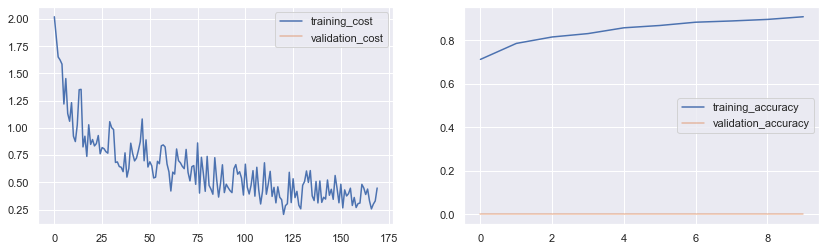

initial_cost:  3.2946  initial_acc:  0.1036
epoch_0  --> cost_train:  1.307247 train_acc:  0.712  -- cost_val:  0  val_acc:  0  ==> grads:  0.01797
epoch_1  --> cost_train:  1.074403 train_acc:  0.7903  -- cost_val:  0  val_acc:  0  ==> grads:  0.01151
epoch_2  --> cost_train:  0.933702 train_acc:  0.8166  -- cost_val:  0  val_acc:  0  ==> grads:  0.01373
epoch_3  --> cost_train:  0.846538 train_acc:  0.8349  -- cost_val:  0  val_acc:  0  ==> grads:  0.01293
epoch_4  --> cost_train:  0.795172 train_acc:  0.8527  -- cost_val:  0  val_acc:  0  ==> grads:  0.0121
epoch_5  --> cost_train:  0.742195 train_acc:  0.8657  -- cost_val:  0  val_acc:  0  ==> grads:  0.01049
epoch_6  --> cost_train:  0.699138 train_acc:  0.8866  -- cost_val:  0  val_acc:  0  ==> grads:  0.01691
epoch_7  --> cost_train:  0.667957 train_acc:  0.8754  -- cost_val:  0  val_acc:  0  ==> grads:  0.01798
epoch_8  --> cost_train:  0.63502 train_acc:  0.9014  -- cost_val:  0  val_acc:  0  ==> grads:  0.01004
epoch_9  --> c

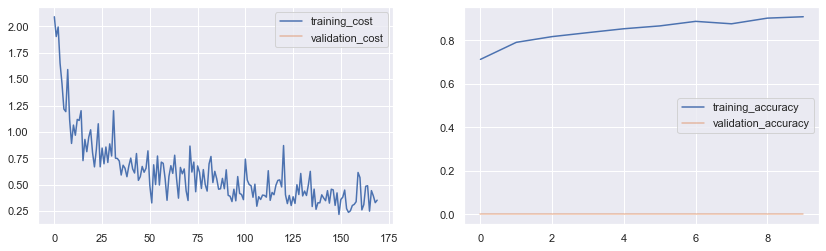

initial_cost:  3.374  initial_acc:  0.0763
epoch_0  --> cost_train:  1.287506 train_acc:  0.7206  -- cost_val:  0  val_acc:  0  ==> grads:  0.01787
epoch_1  --> cost_train:  1.070768 train_acc:  0.7641  -- cost_val:  0  val_acc:  0  ==> grads:  0.01287
epoch_2  --> cost_train:  0.927355 train_acc:  0.8137  -- cost_val:  0  val_acc:  0  ==> grads:  0.01445
epoch_3  --> cost_train:  0.855068 train_acc:  0.8439  -- cost_val:  0  val_acc:  0  ==> grads:  0.01131
epoch_4  --> cost_train:  0.788665 train_acc:  0.8541  -- cost_val:  0  val_acc:  0  ==> grads:  0.01564
epoch_5  --> cost_train:  0.741638 train_acc:  0.8671  -- cost_val:  0  val_acc:  0  ==> grads:  0.01316
epoch_6  --> cost_train:  0.699736 train_acc:  0.8891  -- cost_val:  0  val_acc:  0  ==> grads:  0.01714
epoch_7  --> cost_train:  0.668563 train_acc:  0.8906  -- cost_val:  0  val_acc:  0  ==> grads:  0.01239
epoch_8  --> cost_train:  0.642966 train_acc:  0.9028  -- cost_val:  0  val_acc:  0  ==> grads:  0.01456
epoch_9  -->

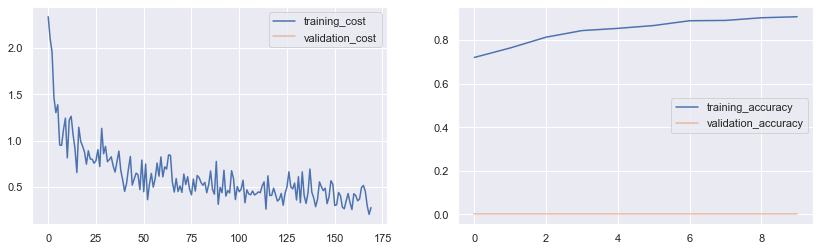

initial_cost:  4.1378  initial_acc:  0.093
epoch_0  --> cost_train:  1.348541 train_acc:  0.7135  -- cost_val:  0  val_acc:  0  ==> grads:  0.01402
epoch_1  --> cost_train:  1.131288 train_acc:  0.781  -- cost_val:  0  val_acc:  0  ==> grads:  0.01332
epoch_2  --> cost_train:  0.983051 train_acc:  0.8142  -- cost_val:  0  val_acc:  0  ==> grads:  0.01765
epoch_3  --> cost_train:  0.891947 train_acc:  0.8377  -- cost_val:  0  val_acc:  0  ==> grads:  0.01557
epoch_4  --> cost_train:  0.825511 train_acc:  0.8565  -- cost_val:  0  val_acc:  0  ==> grads:  0.01381
epoch_5  --> cost_train:  0.77129 train_acc:  0.8714  -- cost_val:  0  val_acc:  0  ==> grads:  0.02055
epoch_6  --> cost_train:  0.715871 train_acc:  0.883  -- cost_val:  0  val_acc:  0  ==> grads:  0.0153
epoch_7  --> cost_train:  0.67639 train_acc:  0.8929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01504
epoch_8  --> cost_train:  0.639187 train_acc:  0.9042  -- cost_val:  0  val_acc:  0  ==> grads:  0.01127
epoch_9  --> cost

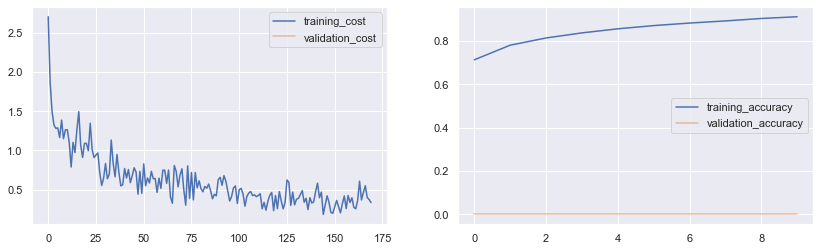

initial_cost:  3.5723  initial_acc:  0.0846
epoch_0  --> cost_train:  1.346329 train_acc:  0.721  -- cost_val:  0  val_acc:  0  ==> grads:  0.01441
epoch_1  --> cost_train:  1.080494 train_acc:  0.7828  -- cost_val:  0  val_acc:  0  ==> grads:  0.0112
epoch_2  --> cost_train:  0.943175 train_acc:  0.8074  -- cost_val:  0  val_acc:  0  ==> grads:  0.01746
epoch_3  --> cost_train:  0.861632 train_acc:  0.8409  -- cost_val:  0  val_acc:  0  ==> grads:  0.01193
epoch_4  --> cost_train:  0.796653 train_acc:  0.8532  -- cost_val:  0  val_acc:  0  ==> grads:  0.01315
epoch_5  --> cost_train:  0.737458 train_acc:  0.8752  -- cost_val:  0  val_acc:  0  ==> grads:  0.01614
epoch_6  --> cost_train:  0.693217 train_acc:  0.8819  -- cost_val:  0  val_acc:  0  ==> grads:  0.01654
epoch_7  --> cost_train:  0.664981 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01275
epoch_8  --> cost_train:  0.635932 train_acc:  0.8977  -- cost_val:  0  val_acc:  0  ==> grads:  0.00999
epoch_9  --> 

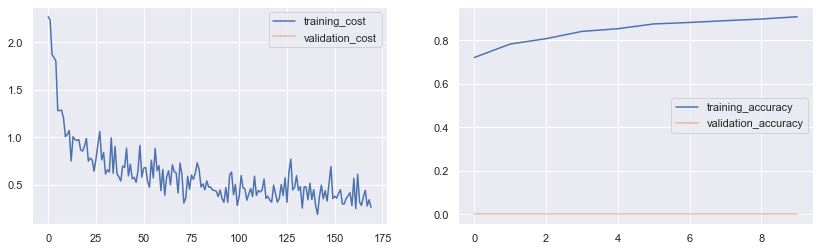

initial_cost:  3.5172  initial_acc:  0.065
epoch_0  --> cost_train:  1.388882 train_acc:  0.7172  -- cost_val:  0  val_acc:  0  ==> grads:  0.01185
epoch_1  --> cost_train:  1.123715 train_acc:  0.7649  -- cost_val:  0  val_acc:  0  ==> grads:  0.01372
epoch_2  --> cost_train:  0.987778 train_acc:  0.8074  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_3  --> cost_train:  0.888696 train_acc:  0.834  -- cost_val:  0  val_acc:  0  ==> grads:  0.01243
epoch_4  --> cost_train:  0.825484 train_acc:  0.8558  -- cost_val:  0  val_acc:  0  ==> grads:  0.01234
epoch_5  --> cost_train:  0.772214 train_acc:  0.8692  -- cost_val:  0  val_acc:  0  ==> grads:  0.01416
epoch_6  --> cost_train:  0.73213 train_acc:  0.8879  -- cost_val:  0  val_acc:  0  ==> grads:  0.01472
epoch_7  --> cost_train:  0.691316 train_acc:  0.8903  -- cost_val:  0  val_acc:  0  ==> grads:  0.01703
epoch_8  --> cost_train:  0.660059 train_acc:  0.9038  -- cost_val:  0  val_acc:  0  ==> grads:  0.01339
epoch_9  --> c

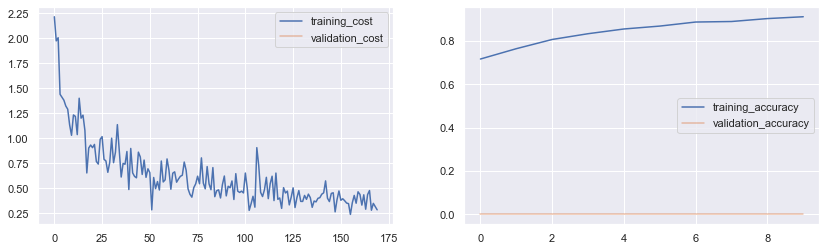

initial_cost:  3.6942  initial_acc:  0.0684
epoch_0  --> cost_train:  1.329947 train_acc:  0.7221  -- cost_val:  0  val_acc:  0  ==> grads:  0.01495
epoch_1  --> cost_train:  1.064771 train_acc:  0.7734  -- cost_val:  0  val_acc:  0  ==> grads:  0.01849
epoch_2  --> cost_train:  0.928255 train_acc:  0.8193  -- cost_val:  0  val_acc:  0  ==> grads:  0.011
epoch_3  --> cost_train:  0.84504 train_acc:  0.838  -- cost_val:  0  val_acc:  0  ==> grads:  0.01302
epoch_4  --> cost_train:  0.785599 train_acc:  0.8589  -- cost_val:  0  val_acc:  0  ==> grads:  0.01032
epoch_5  --> cost_train:  0.73725 train_acc:  0.8716  -- cost_val:  0  val_acc:  0  ==> grads:  0.01125
epoch_6  --> cost_train:  0.696616 train_acc:  0.8863  -- cost_val:  0  val_acc:  0  ==> grads:  0.0138
epoch_7  --> cost_train:  0.658218 train_acc:  0.8932  -- cost_val:  0  val_acc:  0  ==> grads:  0.01298
epoch_8  --> cost_train:  0.630404 train_acc:  0.9029  -- cost_val:  0  val_acc:  0  ==> grads:  0.01174
epoch_9  --> cost

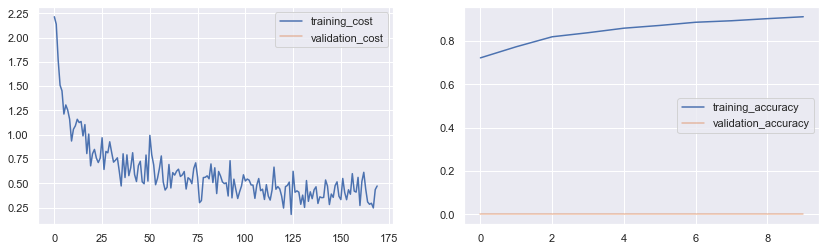

initial_cost:  2.7442  initial_acc:  0.1424
epoch_0  --> cost_train:  1.353271 train_acc:  0.7228  -- cost_val:  0  val_acc:  0  ==> grads:  0.01402
epoch_1  --> cost_train:  1.106941 train_acc:  0.7815  -- cost_val:  0  val_acc:  0  ==> grads:  0.01641
epoch_2  --> cost_train:  0.974804 train_acc:  0.8006  -- cost_val:  0  val_acc:  0  ==> grads:  0.01473
epoch_3  --> cost_train:  0.87166 train_acc:  0.8403  -- cost_val:  0  val_acc:  0  ==> grads:  0.01539
epoch_4  --> cost_train:  0.798644 train_acc:  0.8568  -- cost_val:  0  val_acc:  0  ==> grads:  0.01154
epoch_5  --> cost_train:  0.743449 train_acc:  0.8688  -- cost_val:  0  val_acc:  0  ==> grads:  0.01192
epoch_6  --> cost_train:  0.699136 train_acc:  0.8747  -- cost_val:  0  val_acc:  0  ==> grads:  0.01196
epoch_7  --> cost_train:  0.664128 train_acc:  0.8955  -- cost_val:  0  val_acc:  0  ==> grads:  0.01528
epoch_8  --> cost_train:  0.633345 train_acc:  0.9037  -- cost_val:  0  val_acc:  0  ==> grads:  0.0153
epoch_9  --> 

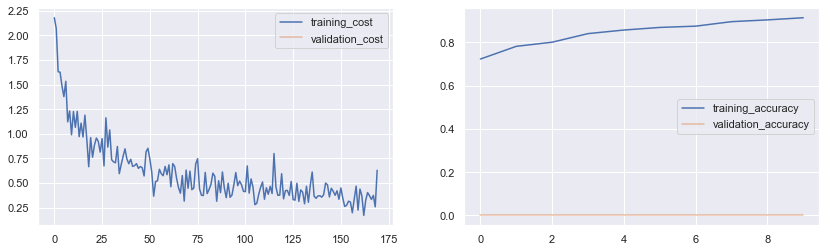

initial_cost:  3.0555  initial_acc:  0.1019
epoch_0  --> cost_train:  1.279241 train_acc:  0.7158  -- cost_val:  0  val_acc:  0  ==> grads:  0.02039
epoch_1  --> cost_train:  1.047168 train_acc:  0.7791  -- cost_val:  0  val_acc:  0  ==> grads:  0.01572
epoch_2  --> cost_train:  0.92769 train_acc:  0.8122  -- cost_val:  0  val_acc:  0  ==> grads:  0.0133
epoch_3  --> cost_train:  0.852393 train_acc:  0.8377  -- cost_val:  0  val_acc:  0  ==> grads:  0.013
epoch_4  --> cost_train:  0.79958 train_acc:  0.8595  -- cost_val:  0  val_acc:  0  ==> grads:  0.01188
epoch_5  --> cost_train:  0.752708 train_acc:  0.8639  -- cost_val:  0  val_acc:  0  ==> grads:  0.01555
epoch_6  --> cost_train:  0.704239 train_acc:  0.8828  -- cost_val:  0  val_acc:  0  ==> grads:  0.01053
epoch_7  --> cost_train:  0.668493 train_acc:  0.8944  -- cost_val:  0  val_acc:  0  ==> grads:  0.01247
epoch_8  --> cost_train:  0.635086 train_acc:  0.8978  -- cost_val:  0  val_acc:  0  ==> grads:  0.01073
epoch_9  --> cos

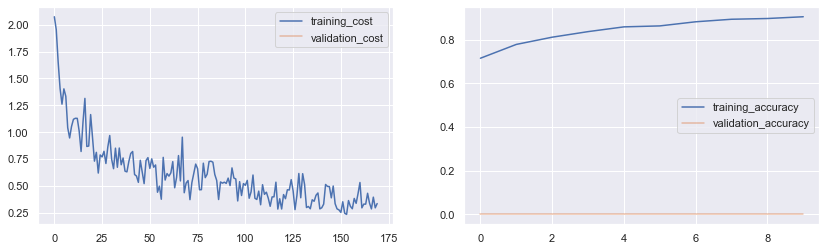

initial_cost:  2.8546  initial_acc:  0.0988
epoch_0  --> cost_train:  1.266324 train_acc:  0.7027  -- cost_val:  0  val_acc:  0  ==> grads:  0.01499
epoch_1  --> cost_train:  1.055647 train_acc:  0.7785  -- cost_val:  0  val_acc:  0  ==> grads:  0.0136
epoch_2  --> cost_train:  0.917549 train_acc:  0.8152  -- cost_val:  0  val_acc:  0  ==> grads:  0.01385
epoch_3  --> cost_train:  0.836665 train_acc:  0.8441  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_4  --> cost_train:  0.761282 train_acc:  0.8553  -- cost_val:  0  val_acc:  0  ==> grads:  0.01519
epoch_5  --> cost_train:  0.713346 train_acc:  0.8741  -- cost_val:  0  val_acc:  0  ==> grads:  0.01369
epoch_6  --> cost_train:  0.672476 train_acc:  0.8826  -- cost_val:  0  val_acc:  0  ==> grads:  0.0123
epoch_7  --> cost_train:  0.644873 train_acc:  0.8962  -- cost_val:  0  val_acc:  0  ==> grads:  0.0132
epoch_8  --> cost_train:  0.616503 train_acc:  0.9068  -- cost_val:  0  val_acc:  0  ==> grads:  0.01251
epoch_9  --> c

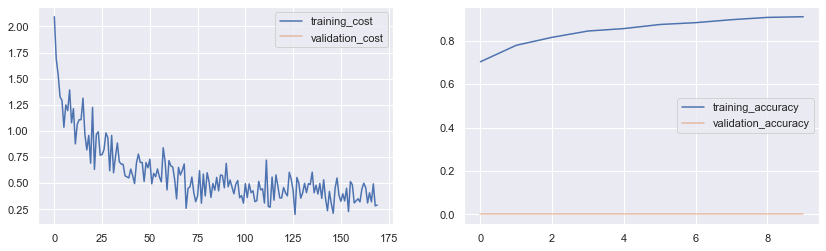

initial_cost:  3.0125  initial_acc:  0.1704
epoch_0  --> cost_train:  1.282906 train_acc:  0.7235  -- cost_val:  0  val_acc:  0  ==> grads:  0.01662
epoch_1  --> cost_train:  1.046324 train_acc:  0.783  -- cost_val:  0  val_acc:  0  ==> grads:  0.01356
epoch_2  --> cost_train:  0.953884 train_acc:  0.8185  -- cost_val:  0  val_acc:  0  ==> grads:  0.01013
epoch_3  --> cost_train:  0.872001 train_acc:  0.8399  -- cost_val:  0  val_acc:  0  ==> grads:  0.01272
epoch_4  --> cost_train:  0.80516 train_acc:  0.8565  -- cost_val:  0  val_acc:  0  ==> grads:  0.01407
epoch_5  --> cost_train:  0.745154 train_acc:  0.8608  -- cost_val:  0  val_acc:  0  ==> grads:  0.00859
epoch_6  --> cost_train:  0.702813 train_acc:  0.884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01749
epoch_7  --> cost_train:  0.671116 train_acc:  0.8894  -- cost_val:  0  val_acc:  0  ==> grads:  0.01562
epoch_8  --> cost_train:  0.63491 train_acc:  0.8959  -- cost_val:  0  val_acc:  0  ==> grads:  0.01251
epoch_9  --> co

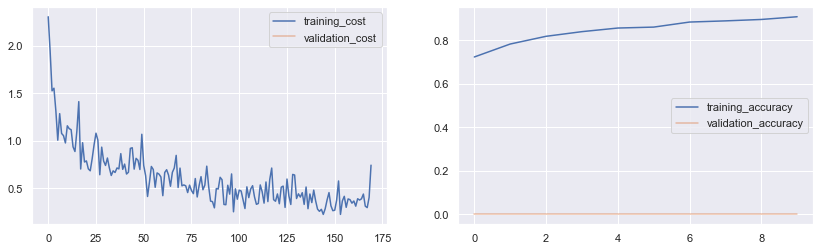

initial_cost:  3.3266  initial_acc:  0.1026
epoch_0  --> cost_train:  1.286135 train_acc:  0.7133  -- cost_val:  0  val_acc:  0  ==> grads:  0.01708
epoch_1  --> cost_train:  1.025594 train_acc:  0.7896  -- cost_val:  0  val_acc:  0  ==> grads:  0.01946
epoch_2  --> cost_train:  0.901688 train_acc:  0.8185  -- cost_val:  0  val_acc:  0  ==> grads:  0.01474
epoch_3  --> cost_train:  0.833225 train_acc:  0.8349  -- cost_val:  0  val_acc:  0  ==> grads:  0.01218
epoch_4  --> cost_train:  0.776708 train_acc:  0.8599  -- cost_val:  0  val_acc:  0  ==> grads:  0.01306
epoch_5  --> cost_train:  0.727512 train_acc:  0.8722  -- cost_val:  0  val_acc:  0  ==> grads:  0.01523
epoch_6  --> cost_train:  0.696197 train_acc:  0.8764  -- cost_val:  0  val_acc:  0  ==> grads:  0.01102
epoch_7  --> cost_train:  0.658472 train_acc:  0.8906  -- cost_val:  0  val_acc:  0  ==> grads:  0.0127
epoch_8  --> cost_train:  0.633038 train_acc:  0.9059  -- cost_val:  0  val_acc:  0  ==> grads:  0.01287
epoch_9  -->

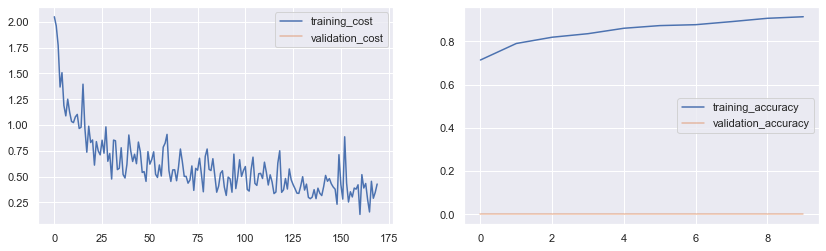

initial_cost:  3.202  initial_acc:  0.1027
epoch_0  --> cost_train:  1.356382 train_acc:  0.7193  -- cost_val:  0  val_acc:  0  ==> grads:  0.01776
epoch_1  --> cost_train:  1.102259 train_acc:  0.7716  -- cost_val:  0  val_acc:  0  ==> grads:  0.01153
epoch_2  --> cost_train:  0.974135 train_acc:  0.7999  -- cost_val:  0  val_acc:  0  ==> grads:  0.01822
epoch_3  --> cost_train:  0.882476 train_acc:  0.8397  -- cost_val:  0  val_acc:  0  ==> grads:  0.01288
epoch_4  --> cost_train:  0.808984 train_acc:  0.8528  -- cost_val:  0  val_acc:  0  ==> grads:  0.01262
epoch_5  --> cost_train:  0.756561 train_acc:  0.8687  -- cost_val:  0  val_acc:  0  ==> grads:  0.01328
epoch_6  --> cost_train:  0.713418 train_acc:  0.8824  -- cost_val:  0  val_acc:  0  ==> grads:  0.01324
epoch_7  --> cost_train:  0.678524 train_acc:  0.8907  -- cost_val:  0  val_acc:  0  ==> grads:  0.01312
epoch_8  --> cost_train:  0.643365 train_acc:  0.8969  -- cost_val:  0  val_acc:  0  ==> grads:  0.01266
epoch_9  -->

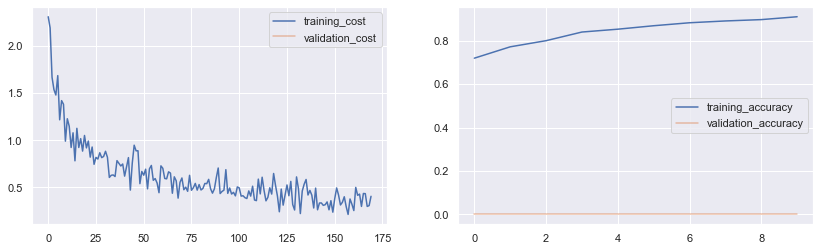

initial_cost:  3.2963  initial_acc:  0.1403
epoch_0  --> cost_train:  1.400235 train_acc:  0.7081  -- cost_val:  0  val_acc:  0  ==> grads:  0.02003
epoch_1  --> cost_train:  1.118268 train_acc:  0.7799  -- cost_val:  0  val_acc:  0  ==> grads:  0.01148
epoch_2  --> cost_train:  0.976251 train_acc:  0.8128  -- cost_val:  0  val_acc:  0  ==> grads:  0.01618
epoch_3  --> cost_train:  0.883871 train_acc:  0.8313  -- cost_val:  0  val_acc:  0  ==> grads:  0.01296
epoch_4  --> cost_train:  0.823371 train_acc:  0.8639  -- cost_val:  0  val_acc:  0  ==> grads:  0.01181
epoch_5  --> cost_train:  0.768274 train_acc:  0.8738  -- cost_val:  0  val_acc:  0  ==> grads:  0.01283
epoch_6  --> cost_train:  0.719805 train_acc:  0.888  -- cost_val:  0  val_acc:  0  ==> grads:  0.01227
epoch_7  --> cost_train:  0.681954 train_acc:  0.8962  -- cost_val:  0  val_acc:  0  ==> grads:  0.01152
epoch_8  --> cost_train:  0.650425 train_acc:  0.9038  -- cost_val:  0  val_acc:  0  ==> grads:  0.01092
epoch_9  -->

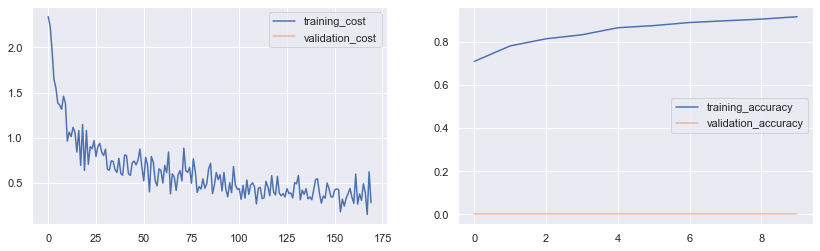

initial_cost:  3.3352  initial_acc:  0.0788
epoch_0  --> cost_train:  1.254 train_acc:  0.7046  -- cost_val:  0  val_acc:  0  ==> grads:  0.01137
epoch_1  --> cost_train:  1.031579 train_acc:  0.7778  -- cost_val:  0  val_acc:  0  ==> grads:  0.01649
epoch_2  --> cost_train:  0.923631 train_acc:  0.8143  -- cost_val:  0  val_acc:  0  ==> grads:  0.0138
epoch_3  --> cost_train:  0.836646 train_acc:  0.8446  -- cost_val:  0  val_acc:  0  ==> grads:  0.01471
epoch_4  --> cost_train:  0.783625 train_acc:  0.8546  -- cost_val:  0  val_acc:  0  ==> grads:  0.0129
epoch_5  --> cost_train:  0.737843 train_acc:  0.8659  -- cost_val:  0  val_acc:  0  ==> grads:  0.01445
epoch_6  --> cost_train:  0.697417 train_acc:  0.8861  -- cost_val:  0  val_acc:  0  ==> grads:  0.01312
epoch_7  --> cost_train:  0.660345 train_acc:  0.8898  -- cost_val:  0  val_acc:  0  ==> grads:  0.00648
epoch_8  --> cost_train:  0.632918 train_acc:  0.9053  -- cost_val:  0  val_acc:  0  ==> grads:  0.01457
epoch_9  --> cos

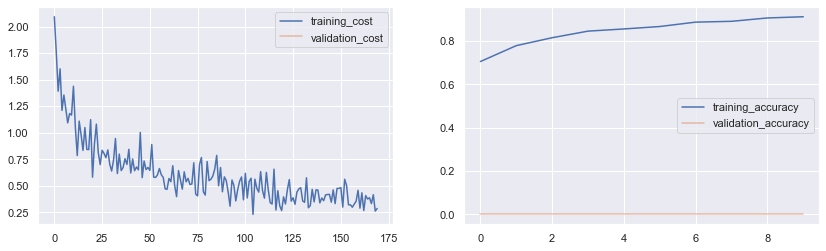

initial_cost:  2.9454  initial_acc:  0.1194
epoch_0  --> cost_train:  1.307147 train_acc:  0.7225  -- cost_val:  0  val_acc:  0  ==> grads:  0.01205
epoch_1  --> cost_train:  1.073544 train_acc:  0.7842  -- cost_val:  0  val_acc:  0  ==> grads:  0.01524
epoch_2  --> cost_train:  0.955055 train_acc:  0.8219  -- cost_val:  0  val_acc:  0  ==> grads:  0.01124
epoch_3  --> cost_train:  0.854428 train_acc:  0.8406  -- cost_val:  0  val_acc:  0  ==> grads:  0.01523
epoch_4  --> cost_train:  0.799465 train_acc:  0.8643  -- cost_val:  0  val_acc:  0  ==> grads:  0.01056
epoch_5  --> cost_train:  0.739012 train_acc:  0.87  -- cost_val:  0  val_acc:  0  ==> grads:  0.01305
epoch_6  --> cost_train:  0.695535 train_acc:  0.8843  -- cost_val:  0  val_acc:  0  ==> grads:  0.01471
epoch_7  --> cost_train:  0.660679 train_acc:  0.897  -- cost_val:  0  val_acc:  0  ==> grads:  0.01274
epoch_8  --> cost_train:  0.631367 train_acc:  0.9016  -- cost_val:  0  val_acc:  0  ==> grads:  0.0099
epoch_9  --> co

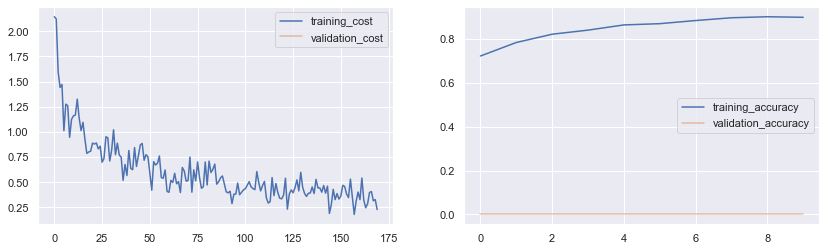

initial_cost:  3.4618  initial_acc:  0.0975
epoch_0  --> cost_train:  1.305035 train_acc:  0.7253  -- cost_val:  0  val_acc:  0  ==> grads:  0.01649
epoch_1  --> cost_train:  1.065468 train_acc:  0.7803  -- cost_val:  0  val_acc:  0  ==> grads:  0.01479
epoch_2  --> cost_train:  0.925863 train_acc:  0.8141  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_3  --> cost_train:  0.861871 train_acc:  0.8394  -- cost_val:  0  val_acc:  0  ==> grads:  0.01289
epoch_4  --> cost_train:  0.786354 train_acc:  0.8538  -- cost_val:  0  val_acc:  0  ==> grads:  0.01585
epoch_5  --> cost_train:  0.73255 train_acc:  0.8748  -- cost_val:  0  val_acc:  0  ==> grads:  0.01389
epoch_6  --> cost_train:  0.693557 train_acc:  0.8833  -- cost_val:  0  val_acc:  0  ==> grads:  0.01044
epoch_7  --> cost_train:  0.660061 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01331
epoch_8  --> cost_train:  0.627883 train_acc:  0.901  -- cost_val:  0  val_acc:  0  ==> grads:  0.00968
epoch_9  --> 

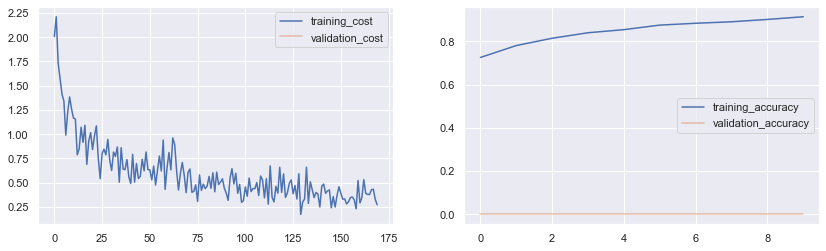

initial_cost:  3.3059  initial_acc:  0.0985
epoch_0  --> cost_train:  1.262659 train_acc:  0.7219  -- cost_val:  0  val_acc:  0  ==> grads:  0.01698
epoch_1  --> cost_train:  1.053374 train_acc:  0.779  -- cost_val:  0  val_acc:  0  ==> grads:  0.01384
epoch_2  --> cost_train:  0.925194 train_acc:  0.8117  -- cost_val:  0  val_acc:  0  ==> grads:  0.01239
epoch_3  --> cost_train:  0.852441 train_acc:  0.8372  -- cost_val:  0  val_acc:  0  ==> grads:  0.01331
epoch_4  --> cost_train:  0.784739 train_acc:  0.8523  -- cost_val:  0  val_acc:  0  ==> grads:  0.01407
epoch_5  --> cost_train:  0.733973 train_acc:  0.8612  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_6  --> cost_train:  0.69198 train_acc:  0.8859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00902
epoch_7  --> cost_train:  0.658882 train_acc:  0.8908  -- cost_val:  0  val_acc:  0  ==> grads:  0.01166
epoch_8  --> cost_train:  0.626482 train_acc:  0.8983  -- cost_val:  0  val_acc:  0  ==> grads:  0.01052
epoch_9  --> 

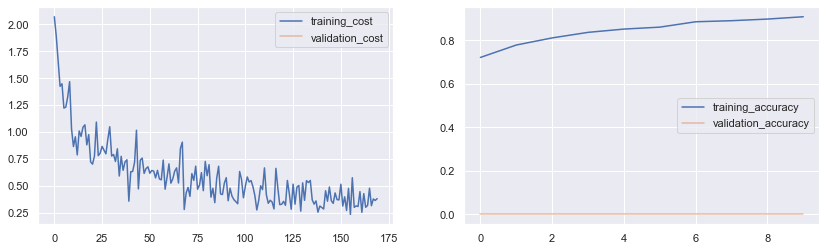

initial_cost:  3.3225  initial_acc:  0.0924
epoch_0  --> cost_train:  1.303794 train_acc:  0.7182  -- cost_val:  0  val_acc:  0  ==> grads:  0.01388
epoch_1  --> cost_train:  1.067929 train_acc:  0.7765  -- cost_val:  0  val_acc:  0  ==> grads:  0.01641
epoch_2  --> cost_train:  0.948788 train_acc:  0.8123  -- cost_val:  0  val_acc:  0  ==> grads:  0.01435
epoch_3  --> cost_train:  0.855822 train_acc:  0.8417  -- cost_val:  0  val_acc:  0  ==> grads:  0.01028
epoch_4  --> cost_train:  0.792132 train_acc:  0.8571  -- cost_val:  0  val_acc:  0  ==> grads:  0.01189
epoch_5  --> cost_train:  0.735151 train_acc:  0.8769  -- cost_val:  0  val_acc:  0  ==> grads:  0.01515
epoch_6  --> cost_train:  0.69523 train_acc:  0.8868  -- cost_val:  0  val_acc:  0  ==> grads:  0.01606
epoch_7  --> cost_train:  0.660937 train_acc:  0.8929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01289
epoch_8  --> cost_train:  0.626814 train_acc:  0.8944  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_9  -->

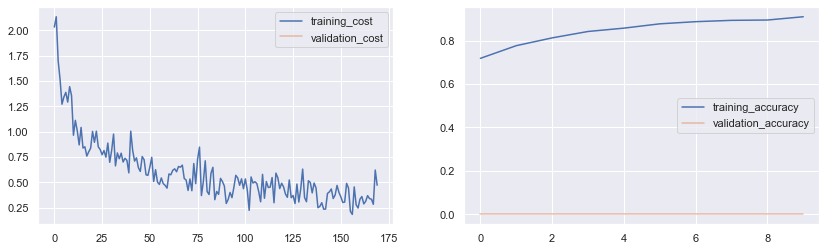

initial_cost:  3.3404  initial_acc:  0.1041
epoch_0  --> cost_train:  1.277018 train_acc:  0.7081  -- cost_val:  0  val_acc:  0  ==> grads:  0.01487
epoch_1  --> cost_train:  1.027824 train_acc:  0.7831  -- cost_val:  0  val_acc:  0  ==> grads:  0.01241
epoch_2  --> cost_train:  0.932855 train_acc:  0.8073  -- cost_val:  0  val_acc:  0  ==> grads:  0.01592
epoch_3  --> cost_train:  0.857359 train_acc:  0.8353  -- cost_val:  0  val_acc:  0  ==> grads:  0.01267
epoch_4  --> cost_train:  0.797531 train_acc:  0.8541  -- cost_val:  0  val_acc:  0  ==> grads:  0.01415
epoch_5  --> cost_train:  0.740262 train_acc:  0.8709  -- cost_val:  0  val_acc:  0  ==> grads:  0.01233
epoch_6  --> cost_train:  0.699449 train_acc:  0.8793  -- cost_val:  0  val_acc:  0  ==> grads:  0.00856
epoch_7  --> cost_train:  0.669124 train_acc:  0.8951  -- cost_val:  0  val_acc:  0  ==> grads:  0.01041
epoch_8  --> cost_train:  0.635737 train_acc:  0.8993  -- cost_val:  0  val_acc:  0  ==> grads:  0.01165
epoch_9  --

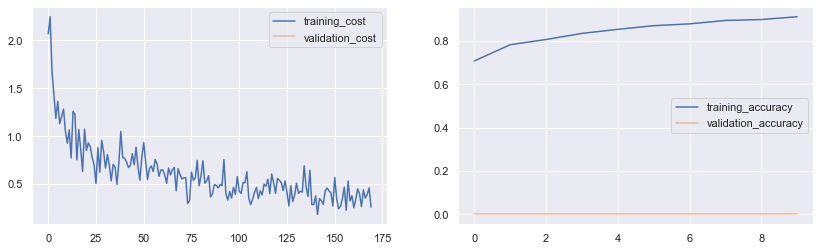

In [205]:
trials = 20
losses = []
for t in range(trials):
    nn_madam = NN_madam(size_h_layer=(X__.shape[1], 512,512, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.00005, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(0, (0,0.5,0.5)),
                              optimizer=('madam',{'beta1':0.9, 'beta2':0.999}),
                              plot_cost=False, print_=1, plots=1)
    nn_madam.train_nn(X__, y__, epochs= 10, batch_size=64, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_madam.tr_batch_cost)

In [203]:
madam_svhn = losses.copy()

In [ ]:
madam = np.zeros((len(madam_svhn[0]), len(madam_svhn)))
for i in range(len(madam_svhn)):
    madam[:,i] = madam_svhn[i]

### Adam on SVHN

initial_cost:  3.2495  initial_acc:  0.0818
epoch_0  --> cost_train:  1.299318 train_acc:  0.7126  -- cost_val:  0  val_acc:  0  ==> grads:  0.01547
epoch_1  --> cost_train:  1.075732 train_acc:  0.786  -- cost_val:  0  val_acc:  0  ==> grads:  0.01388
epoch_2  --> cost_train:  0.963049 train_acc:  0.8156  -- cost_val:  0  val_acc:  0  ==> grads:  0.01309
epoch_3  --> cost_train:  0.888424 train_acc:  0.8312  -- cost_val:  0  val_acc:  0  ==> grads:  0.01256
epoch_4  --> cost_train:  0.829284 train_acc:  0.8578  -- cost_val:  0  val_acc:  0  ==> grads:  0.01431
epoch_5  --> cost_train:  0.776566 train_acc:  0.8684  -- cost_val:  0  val_acc:  0  ==> grads:  0.0146
epoch_6  --> cost_train:  0.730821 train_acc:  0.8835  -- cost_val:  0  val_acc:  0  ==> grads:  0.01368
epoch_7  --> cost_train:  0.690736 train_acc:  0.8892  -- cost_val:  0  val_acc:  0  ==> grads:  0.00818
epoch_8  --> cost_train:  0.658949 train_acc:  0.8963  -- cost_val:  0  val_acc:  0  ==> grads:  0.00981
epoch_9  --> 

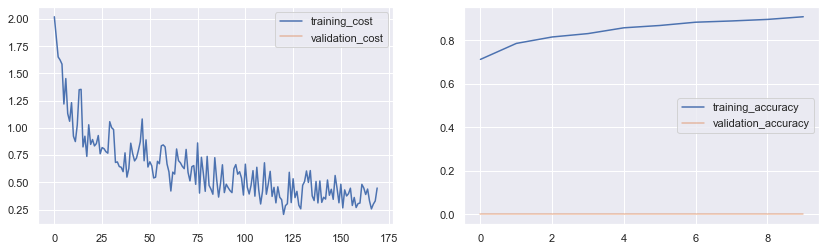

initial_cost:  3.2946  initial_acc:  0.1036
epoch_0  --> cost_train:  1.307247 train_acc:  0.712  -- cost_val:  0  val_acc:  0  ==> grads:  0.01797
epoch_1  --> cost_train:  1.074403 train_acc:  0.7903  -- cost_val:  0  val_acc:  0  ==> grads:  0.01151
epoch_2  --> cost_train:  0.933702 train_acc:  0.8166  -- cost_val:  0  val_acc:  0  ==> grads:  0.01373
epoch_3  --> cost_train:  0.846538 train_acc:  0.8349  -- cost_val:  0  val_acc:  0  ==> grads:  0.01293
epoch_4  --> cost_train:  0.795172 train_acc:  0.8527  -- cost_val:  0  val_acc:  0  ==> grads:  0.0121
epoch_5  --> cost_train:  0.742195 train_acc:  0.8657  -- cost_val:  0  val_acc:  0  ==> grads:  0.01049
epoch_6  --> cost_train:  0.699138 train_acc:  0.8866  -- cost_val:  0  val_acc:  0  ==> grads:  0.01691
epoch_7  --> cost_train:  0.667957 train_acc:  0.8754  -- cost_val:  0  val_acc:  0  ==> grads:  0.01798
epoch_8  --> cost_train:  0.63502 train_acc:  0.9014  -- cost_val:  0  val_acc:  0  ==> grads:  0.01004
epoch_9  --> c

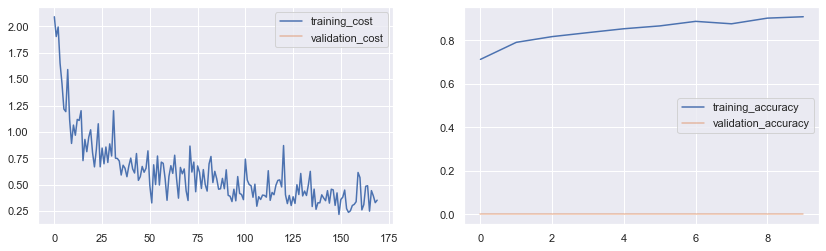

initial_cost:  3.374  initial_acc:  0.0763
epoch_0  --> cost_train:  1.287506 train_acc:  0.7206  -- cost_val:  0  val_acc:  0  ==> grads:  0.01787
epoch_1  --> cost_train:  1.070768 train_acc:  0.7641  -- cost_val:  0  val_acc:  0  ==> grads:  0.01287
epoch_2  --> cost_train:  0.927355 train_acc:  0.8137  -- cost_val:  0  val_acc:  0  ==> grads:  0.01445
epoch_3  --> cost_train:  0.855068 train_acc:  0.8439  -- cost_val:  0  val_acc:  0  ==> grads:  0.01131
epoch_4  --> cost_train:  0.788665 train_acc:  0.8541  -- cost_val:  0  val_acc:  0  ==> grads:  0.01564
epoch_5  --> cost_train:  0.741638 train_acc:  0.8671  -- cost_val:  0  val_acc:  0  ==> grads:  0.01316
epoch_6  --> cost_train:  0.699736 train_acc:  0.8891  -- cost_val:  0  val_acc:  0  ==> grads:  0.01714
epoch_7  --> cost_train:  0.668563 train_acc:  0.8906  -- cost_val:  0  val_acc:  0  ==> grads:  0.01239
epoch_8  --> cost_train:  0.642966 train_acc:  0.9028  -- cost_val:  0  val_acc:  0  ==> grads:  0.01456
epoch_9  -->

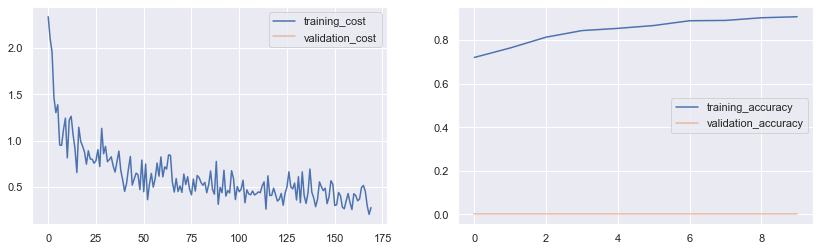

initial_cost:  4.1378  initial_acc:  0.093
epoch_0  --> cost_train:  1.348541 train_acc:  0.7135  -- cost_val:  0  val_acc:  0  ==> grads:  0.01402
epoch_1  --> cost_train:  1.131288 train_acc:  0.781  -- cost_val:  0  val_acc:  0  ==> grads:  0.01332
epoch_2  --> cost_train:  0.983051 train_acc:  0.8142  -- cost_val:  0  val_acc:  0  ==> grads:  0.01765
epoch_3  --> cost_train:  0.891947 train_acc:  0.8377  -- cost_val:  0  val_acc:  0  ==> grads:  0.01557
epoch_4  --> cost_train:  0.825511 train_acc:  0.8565  -- cost_val:  0  val_acc:  0  ==> grads:  0.01381
epoch_5  --> cost_train:  0.77129 train_acc:  0.8714  -- cost_val:  0  val_acc:  0  ==> grads:  0.02055
epoch_6  --> cost_train:  0.715871 train_acc:  0.883  -- cost_val:  0  val_acc:  0  ==> grads:  0.0153
epoch_7  --> cost_train:  0.67639 train_acc:  0.8929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01504
epoch_8  --> cost_train:  0.639187 train_acc:  0.9042  -- cost_val:  0  val_acc:  0  ==> grads:  0.01127
epoch_9  --> cost

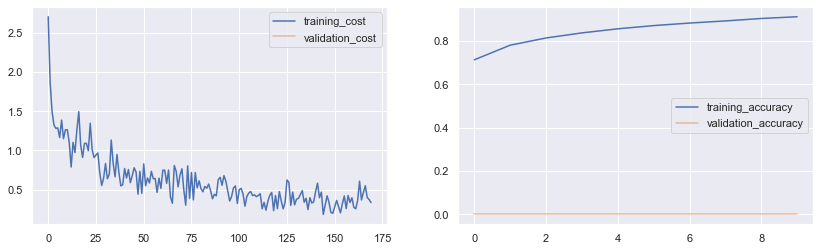

initial_cost:  3.5723  initial_acc:  0.0846
epoch_0  --> cost_train:  1.346329 train_acc:  0.721  -- cost_val:  0  val_acc:  0  ==> grads:  0.01441
epoch_1  --> cost_train:  1.080494 train_acc:  0.7828  -- cost_val:  0  val_acc:  0  ==> grads:  0.0112
epoch_2  --> cost_train:  0.943175 train_acc:  0.8074  -- cost_val:  0  val_acc:  0  ==> grads:  0.01746
epoch_3  --> cost_train:  0.861632 train_acc:  0.8409  -- cost_val:  0  val_acc:  0  ==> grads:  0.01193
epoch_4  --> cost_train:  0.796653 train_acc:  0.8532  -- cost_val:  0  val_acc:  0  ==> grads:  0.01315
epoch_5  --> cost_train:  0.737458 train_acc:  0.8752  -- cost_val:  0  val_acc:  0  ==> grads:  0.01614
epoch_6  --> cost_train:  0.693217 train_acc:  0.8819  -- cost_val:  0  val_acc:  0  ==> grads:  0.01654
epoch_7  --> cost_train:  0.664981 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01275
epoch_8  --> cost_train:  0.635932 train_acc:  0.8977  -- cost_val:  0  val_acc:  0  ==> grads:  0.00999
epoch_9  --> 

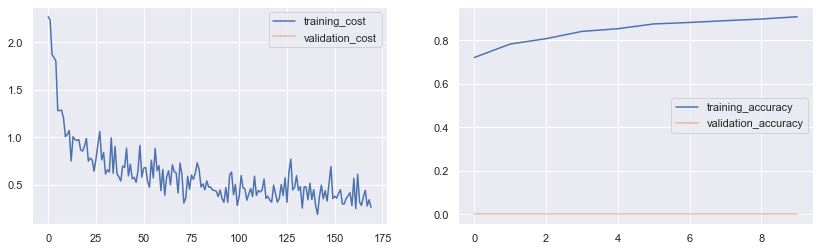

initial_cost:  3.5172  initial_acc:  0.065
epoch_0  --> cost_train:  1.388882 train_acc:  0.7172  -- cost_val:  0  val_acc:  0  ==> grads:  0.01185
epoch_1  --> cost_train:  1.123715 train_acc:  0.7649  -- cost_val:  0  val_acc:  0  ==> grads:  0.01372
epoch_2  --> cost_train:  0.987778 train_acc:  0.8074  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_3  --> cost_train:  0.888696 train_acc:  0.834  -- cost_val:  0  val_acc:  0  ==> grads:  0.01243
epoch_4  --> cost_train:  0.825484 train_acc:  0.8558  -- cost_val:  0  val_acc:  0  ==> grads:  0.01234
epoch_5  --> cost_train:  0.772214 train_acc:  0.8692  -- cost_val:  0  val_acc:  0  ==> grads:  0.01416
epoch_6  --> cost_train:  0.73213 train_acc:  0.8879  -- cost_val:  0  val_acc:  0  ==> grads:  0.01472
epoch_7  --> cost_train:  0.691316 train_acc:  0.8903  -- cost_val:  0  val_acc:  0  ==> grads:  0.01703
epoch_8  --> cost_train:  0.660059 train_acc:  0.9038  -- cost_val:  0  val_acc:  0  ==> grads:  0.01339
epoch_9  --> c

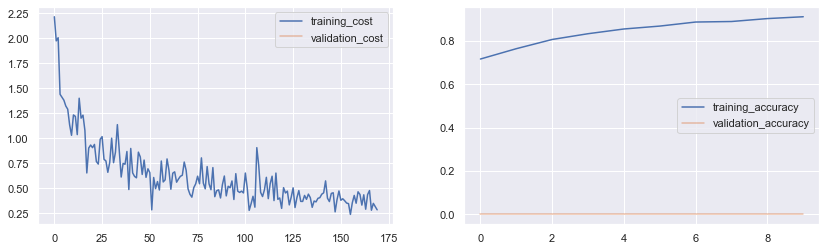

initial_cost:  3.6942  initial_acc:  0.0684
epoch_0  --> cost_train:  1.329947 train_acc:  0.7221  -- cost_val:  0  val_acc:  0  ==> grads:  0.01495
epoch_1  --> cost_train:  1.064771 train_acc:  0.7734  -- cost_val:  0  val_acc:  0  ==> grads:  0.01849
epoch_2  --> cost_train:  0.928255 train_acc:  0.8193  -- cost_val:  0  val_acc:  0  ==> grads:  0.011
epoch_3  --> cost_train:  0.84504 train_acc:  0.838  -- cost_val:  0  val_acc:  0  ==> grads:  0.01302
epoch_4  --> cost_train:  0.785599 train_acc:  0.8589  -- cost_val:  0  val_acc:  0  ==> grads:  0.01032
epoch_5  --> cost_train:  0.73725 train_acc:  0.8716  -- cost_val:  0  val_acc:  0  ==> grads:  0.01125
epoch_6  --> cost_train:  0.696616 train_acc:  0.8863  -- cost_val:  0  val_acc:  0  ==> grads:  0.0138
epoch_7  --> cost_train:  0.658218 train_acc:  0.8932  -- cost_val:  0  val_acc:  0  ==> grads:  0.01298
epoch_8  --> cost_train:  0.630404 train_acc:  0.9029  -- cost_val:  0  val_acc:  0  ==> grads:  0.01174
epoch_9  --> cost

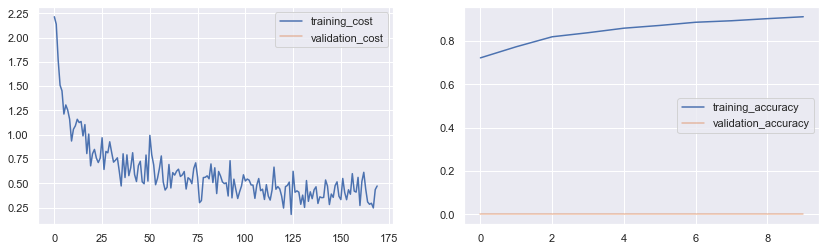

initial_cost:  2.7442  initial_acc:  0.1424
epoch_0  --> cost_train:  1.353271 train_acc:  0.7228  -- cost_val:  0  val_acc:  0  ==> grads:  0.01402
epoch_1  --> cost_train:  1.106941 train_acc:  0.7815  -- cost_val:  0  val_acc:  0  ==> grads:  0.01641
epoch_2  --> cost_train:  0.974804 train_acc:  0.8006  -- cost_val:  0  val_acc:  0  ==> grads:  0.01473
epoch_3  --> cost_train:  0.87166 train_acc:  0.8403  -- cost_val:  0  val_acc:  0  ==> grads:  0.01539
epoch_4  --> cost_train:  0.798644 train_acc:  0.8568  -- cost_val:  0  val_acc:  0  ==> grads:  0.01154
epoch_5  --> cost_train:  0.743449 train_acc:  0.8688  -- cost_val:  0  val_acc:  0  ==> grads:  0.01192
epoch_6  --> cost_train:  0.699136 train_acc:  0.8747  -- cost_val:  0  val_acc:  0  ==> grads:  0.01196
epoch_7  --> cost_train:  0.664128 train_acc:  0.8955  -- cost_val:  0  val_acc:  0  ==> grads:  0.01528
epoch_8  --> cost_train:  0.633345 train_acc:  0.9037  -- cost_val:  0  val_acc:  0  ==> grads:  0.0153
epoch_9  --> 

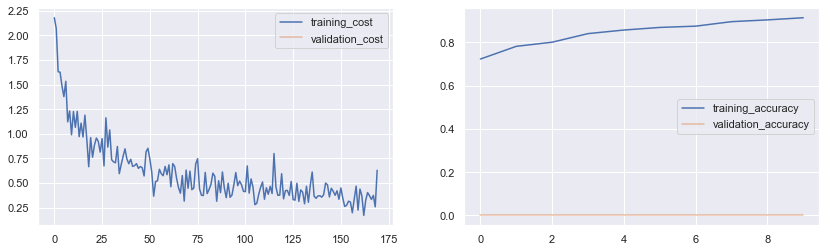

initial_cost:  3.0555  initial_acc:  0.1019
epoch_0  --> cost_train:  1.279241 train_acc:  0.7158  -- cost_val:  0  val_acc:  0  ==> grads:  0.02039
epoch_1  --> cost_train:  1.047168 train_acc:  0.7791  -- cost_val:  0  val_acc:  0  ==> grads:  0.01572
epoch_2  --> cost_train:  0.92769 train_acc:  0.8122  -- cost_val:  0  val_acc:  0  ==> grads:  0.0133
epoch_3  --> cost_train:  0.852393 train_acc:  0.8377  -- cost_val:  0  val_acc:  0  ==> grads:  0.013
epoch_4  --> cost_train:  0.79958 train_acc:  0.8595  -- cost_val:  0  val_acc:  0  ==> grads:  0.01188
epoch_5  --> cost_train:  0.752708 train_acc:  0.8639  -- cost_val:  0  val_acc:  0  ==> grads:  0.01555
epoch_6  --> cost_train:  0.704239 train_acc:  0.8828  -- cost_val:  0  val_acc:  0  ==> grads:  0.01053
epoch_7  --> cost_train:  0.668493 train_acc:  0.8944  -- cost_val:  0  val_acc:  0  ==> grads:  0.01247
epoch_8  --> cost_train:  0.635086 train_acc:  0.8978  -- cost_val:  0  val_acc:  0  ==> grads:  0.01073
epoch_9  --> cos

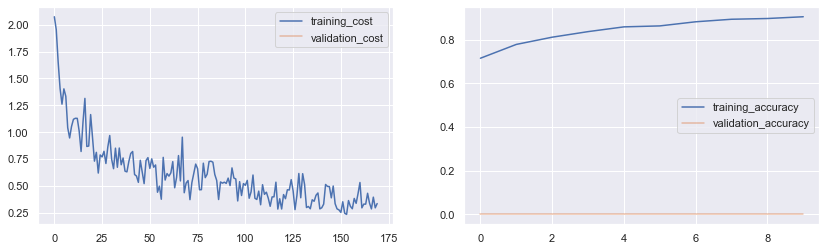

initial_cost:  2.8546  initial_acc:  0.0988
epoch_0  --> cost_train:  1.266324 train_acc:  0.7027  -- cost_val:  0  val_acc:  0  ==> grads:  0.01499
epoch_1  --> cost_train:  1.055647 train_acc:  0.7785  -- cost_val:  0  val_acc:  0  ==> grads:  0.0136
epoch_2  --> cost_train:  0.917549 train_acc:  0.8152  -- cost_val:  0  val_acc:  0  ==> grads:  0.01385
epoch_3  --> cost_train:  0.836665 train_acc:  0.8441  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_4  --> cost_train:  0.761282 train_acc:  0.8553  -- cost_val:  0  val_acc:  0  ==> grads:  0.01519
epoch_5  --> cost_train:  0.713346 train_acc:  0.8741  -- cost_val:  0  val_acc:  0  ==> grads:  0.01369
epoch_6  --> cost_train:  0.672476 train_acc:  0.8826  -- cost_val:  0  val_acc:  0  ==> grads:  0.0123
epoch_7  --> cost_train:  0.644873 train_acc:  0.8962  -- cost_val:  0  val_acc:  0  ==> grads:  0.0132
epoch_8  --> cost_train:  0.616503 train_acc:  0.9068  -- cost_val:  0  val_acc:  0  ==> grads:  0.01251
epoch_9  --> c

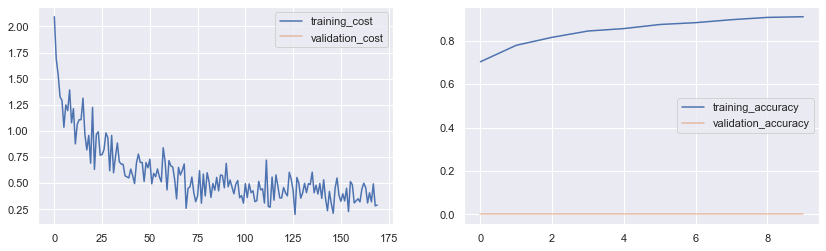

initial_cost:  3.0125  initial_acc:  0.1704
epoch_0  --> cost_train:  1.282906 train_acc:  0.7235  -- cost_val:  0  val_acc:  0  ==> grads:  0.01662
epoch_1  --> cost_train:  1.046324 train_acc:  0.783  -- cost_val:  0  val_acc:  0  ==> grads:  0.01356
epoch_2  --> cost_train:  0.953884 train_acc:  0.8185  -- cost_val:  0  val_acc:  0  ==> grads:  0.01013
epoch_3  --> cost_train:  0.872001 train_acc:  0.8399  -- cost_val:  0  val_acc:  0  ==> grads:  0.01272
epoch_4  --> cost_train:  0.80516 train_acc:  0.8565  -- cost_val:  0  val_acc:  0  ==> grads:  0.01407
epoch_5  --> cost_train:  0.745154 train_acc:  0.8608  -- cost_val:  0  val_acc:  0  ==> grads:  0.00859
epoch_6  --> cost_train:  0.702813 train_acc:  0.884  -- cost_val:  0  val_acc:  0  ==> grads:  0.01749
epoch_7  --> cost_train:  0.671116 train_acc:  0.8894  -- cost_val:  0  val_acc:  0  ==> grads:  0.01562
epoch_8  --> cost_train:  0.63491 train_acc:  0.8959  -- cost_val:  0  val_acc:  0  ==> grads:  0.01251
epoch_9  --> co

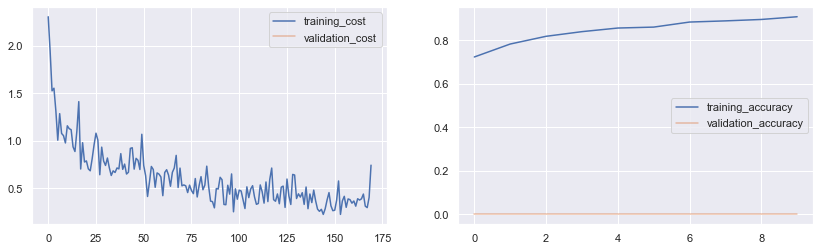

initial_cost:  3.3266  initial_acc:  0.1026
epoch_0  --> cost_train:  1.286135 train_acc:  0.7133  -- cost_val:  0  val_acc:  0  ==> grads:  0.01708
epoch_1  --> cost_train:  1.025594 train_acc:  0.7896  -- cost_val:  0  val_acc:  0  ==> grads:  0.01946
epoch_2  --> cost_train:  0.901688 train_acc:  0.8185  -- cost_val:  0  val_acc:  0  ==> grads:  0.01474
epoch_3  --> cost_train:  0.833225 train_acc:  0.8349  -- cost_val:  0  val_acc:  0  ==> grads:  0.01218
epoch_4  --> cost_train:  0.776708 train_acc:  0.8599  -- cost_val:  0  val_acc:  0  ==> grads:  0.01306
epoch_5  --> cost_train:  0.727512 train_acc:  0.8722  -- cost_val:  0  val_acc:  0  ==> grads:  0.01523
epoch_6  --> cost_train:  0.696197 train_acc:  0.8764  -- cost_val:  0  val_acc:  0  ==> grads:  0.01102
epoch_7  --> cost_train:  0.658472 train_acc:  0.8906  -- cost_val:  0  val_acc:  0  ==> grads:  0.0127
epoch_8  --> cost_train:  0.633038 train_acc:  0.9059  -- cost_val:  0  val_acc:  0  ==> grads:  0.01287
epoch_9  -->

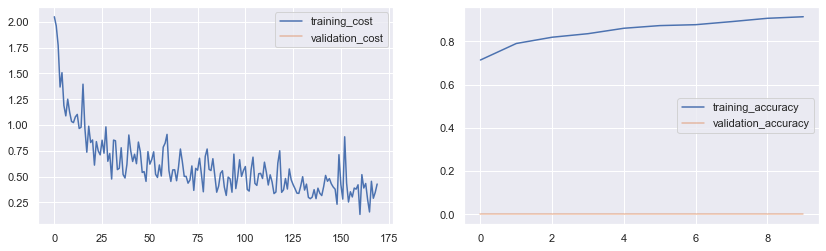

initial_cost:  3.202  initial_acc:  0.1027
epoch_0  --> cost_train:  1.356382 train_acc:  0.7193  -- cost_val:  0  val_acc:  0  ==> grads:  0.01776
epoch_1  --> cost_train:  1.102259 train_acc:  0.7716  -- cost_val:  0  val_acc:  0  ==> grads:  0.01153
epoch_2  --> cost_train:  0.974135 train_acc:  0.7999  -- cost_val:  0  val_acc:  0  ==> grads:  0.01822
epoch_3  --> cost_train:  0.882476 train_acc:  0.8397  -- cost_val:  0  val_acc:  0  ==> grads:  0.01288
epoch_4  --> cost_train:  0.808984 train_acc:  0.8528  -- cost_val:  0  val_acc:  0  ==> grads:  0.01262
epoch_5  --> cost_train:  0.756561 train_acc:  0.8687  -- cost_val:  0  val_acc:  0  ==> grads:  0.01328
epoch_6  --> cost_train:  0.713418 train_acc:  0.8824  -- cost_val:  0  val_acc:  0  ==> grads:  0.01324
epoch_7  --> cost_train:  0.678524 train_acc:  0.8907  -- cost_val:  0  val_acc:  0  ==> grads:  0.01312
epoch_8  --> cost_train:  0.643365 train_acc:  0.8969  -- cost_val:  0  val_acc:  0  ==> grads:  0.01266
epoch_9  -->

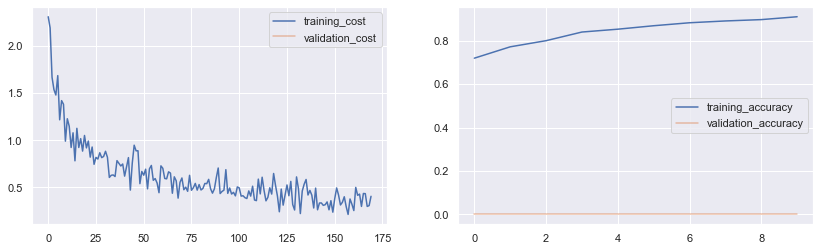

initial_cost:  3.2963  initial_acc:  0.1403
epoch_0  --> cost_train:  1.400235 train_acc:  0.7081  -- cost_val:  0  val_acc:  0  ==> grads:  0.02003
epoch_1  --> cost_train:  1.118268 train_acc:  0.7799  -- cost_val:  0  val_acc:  0  ==> grads:  0.01148
epoch_2  --> cost_train:  0.976251 train_acc:  0.8128  -- cost_val:  0  val_acc:  0  ==> grads:  0.01618
epoch_3  --> cost_train:  0.883871 train_acc:  0.8313  -- cost_val:  0  val_acc:  0  ==> grads:  0.01296
epoch_4  --> cost_train:  0.823371 train_acc:  0.8639  -- cost_val:  0  val_acc:  0  ==> grads:  0.01181
epoch_5  --> cost_train:  0.768274 train_acc:  0.8738  -- cost_val:  0  val_acc:  0  ==> grads:  0.01283
epoch_6  --> cost_train:  0.719805 train_acc:  0.888  -- cost_val:  0  val_acc:  0  ==> grads:  0.01227
epoch_7  --> cost_train:  0.681954 train_acc:  0.8962  -- cost_val:  0  val_acc:  0  ==> grads:  0.01152
epoch_8  --> cost_train:  0.650425 train_acc:  0.9038  -- cost_val:  0  val_acc:  0  ==> grads:  0.01092
epoch_9  -->

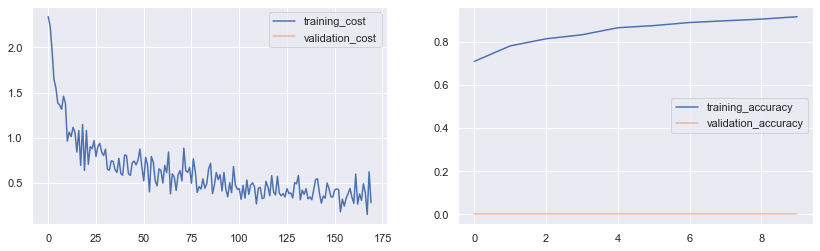

initial_cost:  3.3352  initial_acc:  0.0788
epoch_0  --> cost_train:  1.254 train_acc:  0.7046  -- cost_val:  0  val_acc:  0  ==> grads:  0.01137
epoch_1  --> cost_train:  1.031579 train_acc:  0.7778  -- cost_val:  0  val_acc:  0  ==> grads:  0.01649
epoch_2  --> cost_train:  0.923631 train_acc:  0.8143  -- cost_val:  0  val_acc:  0  ==> grads:  0.0138
epoch_3  --> cost_train:  0.836646 train_acc:  0.8446  -- cost_val:  0  val_acc:  0  ==> grads:  0.01471
epoch_4  --> cost_train:  0.783625 train_acc:  0.8546  -- cost_val:  0  val_acc:  0  ==> grads:  0.0129
epoch_5  --> cost_train:  0.737843 train_acc:  0.8659  -- cost_val:  0  val_acc:  0  ==> grads:  0.01445
epoch_6  --> cost_train:  0.697417 train_acc:  0.8861  -- cost_val:  0  val_acc:  0  ==> grads:  0.01312
epoch_7  --> cost_train:  0.660345 train_acc:  0.8898  -- cost_val:  0  val_acc:  0  ==> grads:  0.00648
epoch_8  --> cost_train:  0.632918 train_acc:  0.9053  -- cost_val:  0  val_acc:  0  ==> grads:  0.01457
epoch_9  --> cos

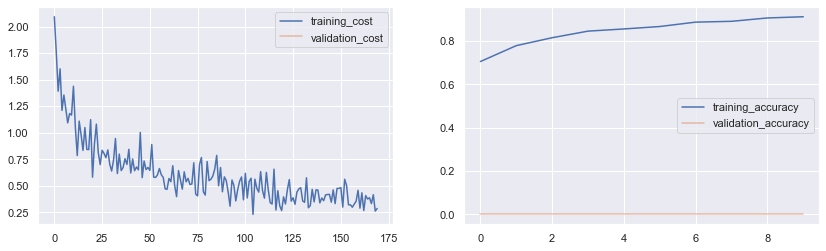

initial_cost:  2.9454  initial_acc:  0.1194
epoch_0  --> cost_train:  1.307147 train_acc:  0.7225  -- cost_val:  0  val_acc:  0  ==> grads:  0.01205
epoch_1  --> cost_train:  1.073544 train_acc:  0.7842  -- cost_val:  0  val_acc:  0  ==> grads:  0.01524
epoch_2  --> cost_train:  0.955055 train_acc:  0.8219  -- cost_val:  0  val_acc:  0  ==> grads:  0.01124
epoch_3  --> cost_train:  0.854428 train_acc:  0.8406  -- cost_val:  0  val_acc:  0  ==> grads:  0.01523
epoch_4  --> cost_train:  0.799465 train_acc:  0.8643  -- cost_val:  0  val_acc:  0  ==> grads:  0.01056
epoch_5  --> cost_train:  0.739012 train_acc:  0.87  -- cost_val:  0  val_acc:  0  ==> grads:  0.01305
epoch_6  --> cost_train:  0.695535 train_acc:  0.8843  -- cost_val:  0  val_acc:  0  ==> grads:  0.01471
epoch_7  --> cost_train:  0.660679 train_acc:  0.897  -- cost_val:  0  val_acc:  0  ==> grads:  0.01274
epoch_8  --> cost_train:  0.631367 train_acc:  0.9016  -- cost_val:  0  val_acc:  0  ==> grads:  0.0099
epoch_9  --> co

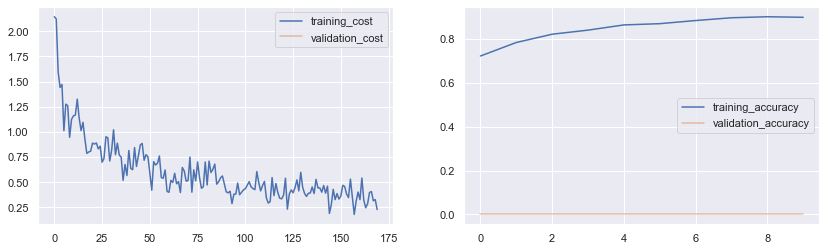

initial_cost:  3.4618  initial_acc:  0.0975
epoch_0  --> cost_train:  1.305035 train_acc:  0.7253  -- cost_val:  0  val_acc:  0  ==> grads:  0.01649
epoch_1  --> cost_train:  1.065468 train_acc:  0.7803  -- cost_val:  0  val_acc:  0  ==> grads:  0.01479
epoch_2  --> cost_train:  0.925863 train_acc:  0.8141  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_3  --> cost_train:  0.861871 train_acc:  0.8394  -- cost_val:  0  val_acc:  0  ==> grads:  0.01289
epoch_4  --> cost_train:  0.786354 train_acc:  0.8538  -- cost_val:  0  val_acc:  0  ==> grads:  0.01585
epoch_5  --> cost_train:  0.73255 train_acc:  0.8748  -- cost_val:  0  val_acc:  0  ==> grads:  0.01389
epoch_6  --> cost_train:  0.693557 train_acc:  0.8833  -- cost_val:  0  val_acc:  0  ==> grads:  0.01044
epoch_7  --> cost_train:  0.660061 train_acc:  0.8901  -- cost_val:  0  val_acc:  0  ==> grads:  0.01331
epoch_8  --> cost_train:  0.627883 train_acc:  0.901  -- cost_val:  0  val_acc:  0  ==> grads:  0.00968
epoch_9  --> 

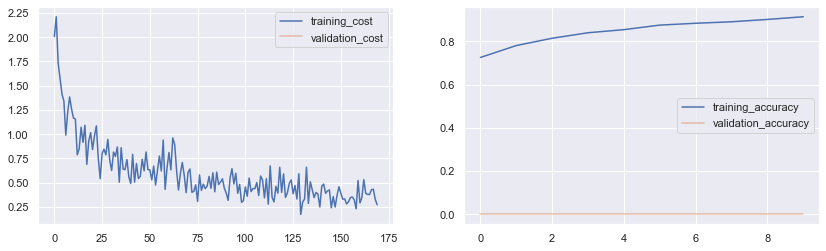

initial_cost:  3.3059  initial_acc:  0.0985
epoch_0  --> cost_train:  1.262659 train_acc:  0.7219  -- cost_val:  0  val_acc:  0  ==> grads:  0.01698
epoch_1  --> cost_train:  1.053374 train_acc:  0.779  -- cost_val:  0  val_acc:  0  ==> grads:  0.01384
epoch_2  --> cost_train:  0.925194 train_acc:  0.8117  -- cost_val:  0  val_acc:  0  ==> grads:  0.01239
epoch_3  --> cost_train:  0.852441 train_acc:  0.8372  -- cost_val:  0  val_acc:  0  ==> grads:  0.01331
epoch_4  --> cost_train:  0.784739 train_acc:  0.8523  -- cost_val:  0  val_acc:  0  ==> grads:  0.01407
epoch_5  --> cost_train:  0.733973 train_acc:  0.8612  -- cost_val:  0  val_acc:  0  ==> grads:  0.01432
epoch_6  --> cost_train:  0.69198 train_acc:  0.8859  -- cost_val:  0  val_acc:  0  ==> grads:  0.00902
epoch_7  --> cost_train:  0.658882 train_acc:  0.8908  -- cost_val:  0  val_acc:  0  ==> grads:  0.01166
epoch_8  --> cost_train:  0.626482 train_acc:  0.8983  -- cost_val:  0  val_acc:  0  ==> grads:  0.01052
epoch_9  --> 

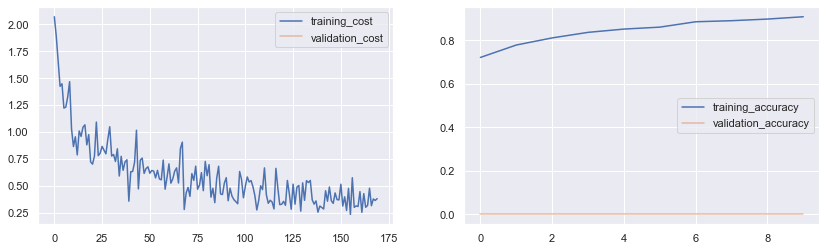

initial_cost:  3.3225  initial_acc:  0.0924
epoch_0  --> cost_train:  1.303794 train_acc:  0.7182  -- cost_val:  0  val_acc:  0  ==> grads:  0.01388
epoch_1  --> cost_train:  1.067929 train_acc:  0.7765  -- cost_val:  0  val_acc:  0  ==> grads:  0.01641
epoch_2  --> cost_train:  0.948788 train_acc:  0.8123  -- cost_val:  0  val_acc:  0  ==> grads:  0.01435
epoch_3  --> cost_train:  0.855822 train_acc:  0.8417  -- cost_val:  0  val_acc:  0  ==> grads:  0.01028
epoch_4  --> cost_train:  0.792132 train_acc:  0.8571  -- cost_val:  0  val_acc:  0  ==> grads:  0.01189
epoch_5  --> cost_train:  0.735151 train_acc:  0.8769  -- cost_val:  0  val_acc:  0  ==> grads:  0.01515
epoch_6  --> cost_train:  0.69523 train_acc:  0.8868  -- cost_val:  0  val_acc:  0  ==> grads:  0.01606
epoch_7  --> cost_train:  0.660937 train_acc:  0.8929  -- cost_val:  0  val_acc:  0  ==> grads:  0.01289
epoch_8  --> cost_train:  0.626814 train_acc:  0.8944  -- cost_val:  0  val_acc:  0  ==> grads:  0.01728
epoch_9  -->

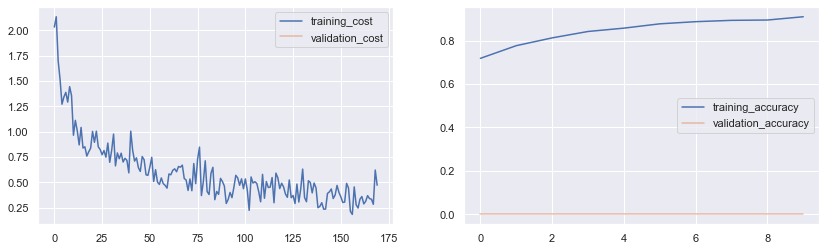

initial_cost:  3.3404  initial_acc:  0.1041
epoch_0  --> cost_train:  1.277018 train_acc:  0.7081  -- cost_val:  0  val_acc:  0  ==> grads:  0.01487
epoch_1  --> cost_train:  1.027824 train_acc:  0.7831  -- cost_val:  0  val_acc:  0  ==> grads:  0.01241
epoch_2  --> cost_train:  0.932855 train_acc:  0.8073  -- cost_val:  0  val_acc:  0  ==> grads:  0.01592
epoch_3  --> cost_train:  0.857359 train_acc:  0.8353  -- cost_val:  0  val_acc:  0  ==> grads:  0.01267
epoch_4  --> cost_train:  0.797531 train_acc:  0.8541  -- cost_val:  0  val_acc:  0  ==> grads:  0.01415
epoch_5  --> cost_train:  0.740262 train_acc:  0.8709  -- cost_val:  0  val_acc:  0  ==> grads:  0.01233
epoch_6  --> cost_train:  0.699449 train_acc:  0.8793  -- cost_val:  0  val_acc:  0  ==> grads:  0.00856
epoch_7  --> cost_train:  0.669124 train_acc:  0.8951  -- cost_val:  0  val_acc:  0  ==> grads:  0.01041
epoch_8  --> cost_train:  0.635737 train_acc:  0.8993  -- cost_val:  0  val_acc:  0  ==> grads:  0.01165
epoch_9  --

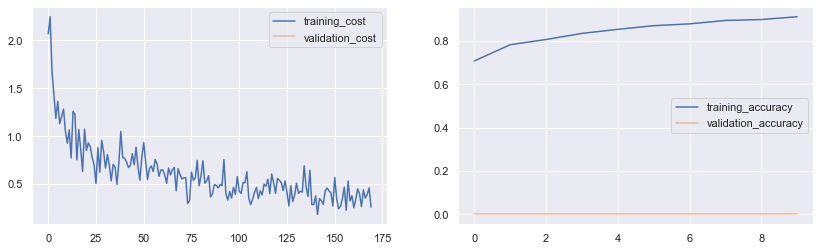

In [205]:
trials = 20
losses = []
for t in range(trials):
    nn_adam = NN_madam(size_h_layer=(X__.shape[1], 512,512, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.00005, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(0, (0,0.5,0.5)),
                              optimizer=('adam',{'beta1':0.9, 'beta2':0.999}),
                              plot_cost=False, print_=1, plots=1)
    nn_adam.train_nn(X__, y__, epochs= 10, batch_size=64, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_adam.tr_batch_cost)

In [206]:
adam_svhn = losses.copy()

In [227]:
adam = np.zeros((len(adam_svhn[0]), len(adam_svhn)))
for i in range(len(adam_cifar10)):
    adam[:,i] = adam_svhn[i]

### Results on SVHN

Text(0.5, 1.0, 'SVHN Dataset - Avg losses over 20 x 10 epochs trials (batch_size=64)')

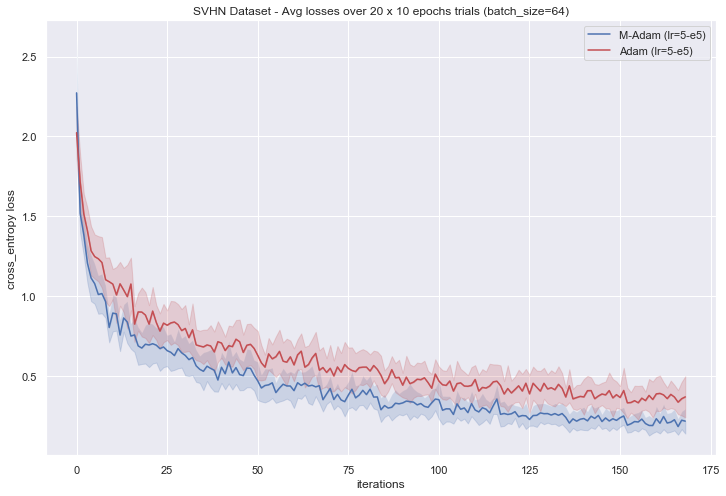

In [230]:
#adamax = adamax_cifar10
#adam = adam_cifar10
start = 1
plt.figure(figsize=(12,8))
plt.plot(madam.mean(axis=1)[start:], 'b')
plt.fill_between(np.arange(len(madam.mean(axis=1)[start:])), madam.mean(axis=1)[start:], madam.mean(axis=1)[start:] + madam.std(axis=1)[start:], alpha=0.2)
plt.fill_between(np.arange(len(madam.mean(axis=1)[start:])), madam.mean(axis=1)[start:], madam.mean(axis=1)[start:] - madam.std(axis=1)[start:], alpha=0.2,color='b')


#plt.plot(adamax_costs.mean(axis=1)[1:] + adamax_costs.std(axis=1)[1:], 'b', alpha=0.2)

plt.plot(adam.mean(axis=1)[start:], 'r')
plt.fill_between(np.arange(len(adam.mean(axis=1)[start:])), adam.mean(axis=1)[start:], adam.mean(axis=1)[start:] + adam.std(axis=1)[start:], alpha=0.2,color='r')
plt.fill_between(np.arange(len(adam.mean(axis=1)[start:])), adam.mean(axis=1)[start:], adam.mean(axis=1)[start:] - adam.std(axis=1)[start:], alpha=0.2,color='r')
plt.legend(['M-Adam (lr=5-e5)', 'Adam (lr=5-e5)'])
plt.xlabel('iterations')
plt.ylabel('cross_entropy loss')
plt.title('SVHN Dataset - Avg losses over 20 x 10 epochs trials (batch_size=64)')



## Conclusions

In summary, we have shown empirically that the M-Adam algorithm is quite effective and helps to speed up convergence substantially. The same principle could be applied to any optimization algorithm that uses momentum. We excluded dropout from the experiments to reduce noise and to have an objective comparison between the two optimization algorithms. Nonetheless, similar results have been obtained when dropout was added as we can see below for the MNIST dataset.



### Similar results are obtained when using Dropout

initial_cost:  3.0394  initial_acc:  0.1134
epoch_0  --> cost_train:  0.331089 train_acc:  0.9432  -- cost_val:  0  val_acc:  0  ==> grads:  0.01088
epoch_1  --> cost_train:  0.252761 train_acc:  0.9536  -- cost_val:  0  val_acc:  0  ==> grads:  0.00496
epoch_2  --> cost_train:  0.216032 train_acc:  0.9602  -- cost_val:  0  val_acc:  0  ==> grads:  0.00617
epoch_3  --> cost_train:  0.195971 train_acc:  0.9649  -- cost_val:  0  val_acc:  0  ==> grads:  0.00419
epoch_4  --> cost_train:  0.179653 train_acc:  0.9681  -- cost_val:  0  val_acc:  0  ==> grads:  0.00523


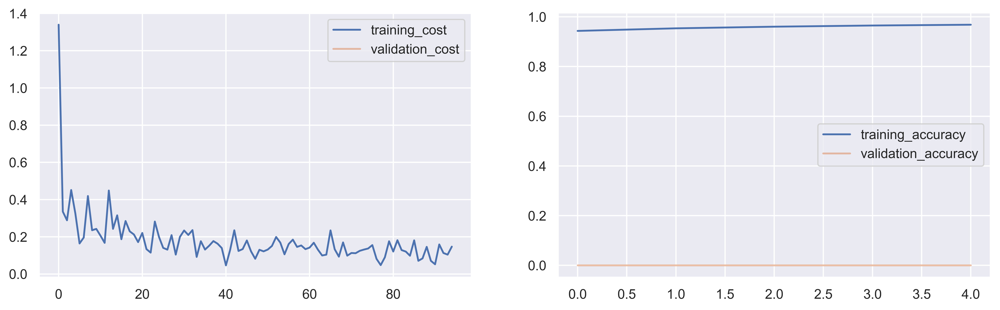

initial_cost:  2.9756  initial_acc:  0.1012
epoch_0  --> cost_train:  0.307995 train_acc:  0.9436  -- cost_val:  0  val_acc:  0  ==> grads:  0.00777
epoch_1  --> cost_train:  0.238697 train_acc:  0.9542  -- cost_val:  0  val_acc:  0  ==> grads:  0.00558
epoch_2  --> cost_train:  0.208318 train_acc:  0.9604  -- cost_val:  0  val_acc:  0  ==> grads:  0.00502
epoch_3  --> cost_train:  0.187316 train_acc:  0.965  -- cost_val:  0  val_acc:  0  ==> grads:  0.00502
epoch_4  --> cost_train:  0.170935 train_acc:  0.9675  -- cost_val:  0  val_acc:  0  ==> grads:  0.00439


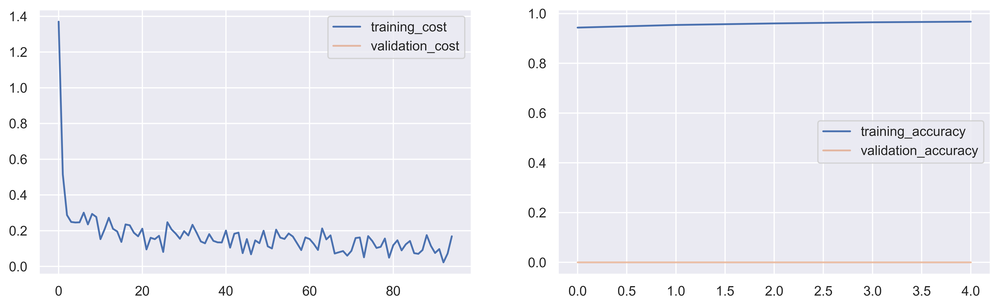

initial_cost:  3.1761  initial_acc:  0.096
epoch_0  --> cost_train:  0.273342 train_acc:  0.9434  -- cost_val:  0  val_acc:  0  ==> grads:  0.0073
epoch_1  --> cost_train:  0.215174 train_acc:  0.9549  -- cost_val:  0  val_acc:  0  ==> grads:  0.00606
epoch_2  --> cost_train:  0.188837 train_acc:  0.9605  -- cost_val:  0  val_acc:  0  ==> grads:  0.00578
epoch_3  --> cost_train:  0.175742 train_acc:  0.9647  -- cost_val:  0  val_acc:  0  ==> grads:  0.00502
epoch_4  --> cost_train:  0.167745 train_acc:  0.9675  -- cost_val:  0  val_acc:  0  ==> grads:  0.00325


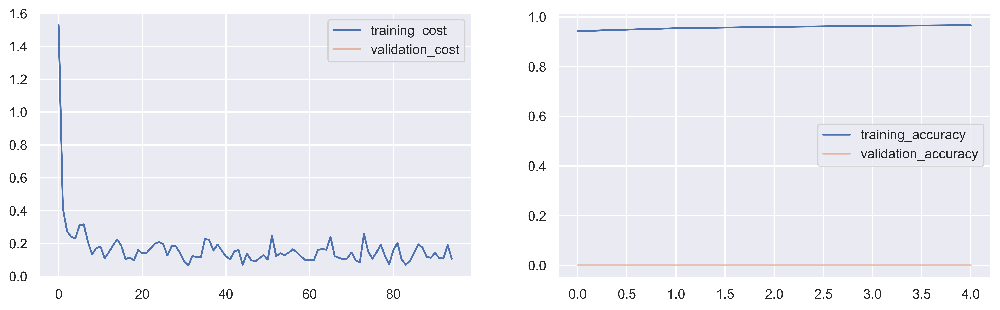

initial_cost:  3.1453  initial_acc:  0.0971
epoch_0  --> cost_train:  0.316521 train_acc:  0.9429  -- cost_val:  0  val_acc:  0  ==> grads:  0.00562
epoch_1  --> cost_train:  0.243479 train_acc:  0.9542  -- cost_val:  0  val_acc:  0  ==> grads:  0.00615
epoch_2  --> cost_train:  0.208282 train_acc:  0.9603  -- cost_val:  0  val_acc:  0  ==> grads:  0.0057
epoch_3  --> cost_train:  0.189147 train_acc:  0.9638  -- cost_val:  0  val_acc:  0  ==> grads:  0.00452
epoch_4  --> cost_train:  0.172676 train_acc:  0.9672  -- cost_val:  0  val_acc:  0  ==> grads:  0.0049


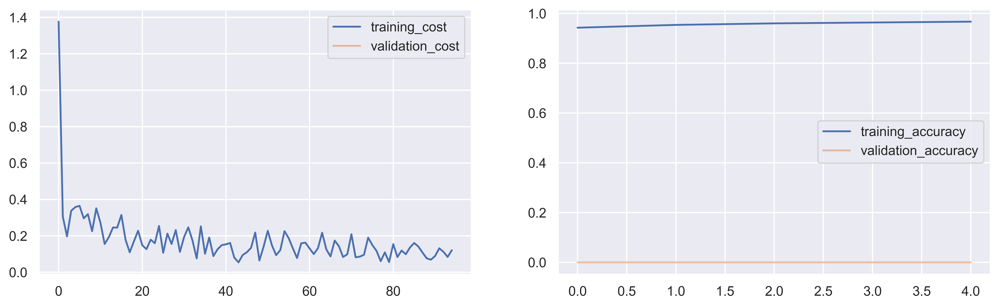

initial_cost:  3.2696  initial_acc:  0.0898
epoch_0  --> cost_train:  0.307574 train_acc:  0.9425  -- cost_val:  0  val_acc:  0  ==> grads:  0.01388
epoch_1  --> cost_train:  0.240132 train_acc:  0.9542  -- cost_val:  0  val_acc:  0  ==> grads:  0.00611
epoch_2  --> cost_train:  0.204332 train_acc:  0.9609  -- cost_val:  0  val_acc:  0  ==> grads:  0.00491
epoch_3  --> cost_train:  0.181083 train_acc:  0.9654  -- cost_val:  0  val_acc:  0  ==> grads:  0.0055
epoch_4  --> cost_train:  0.166603 train_acc:  0.9691  -- cost_val:  0  val_acc:  0  ==> grads:  0.00501


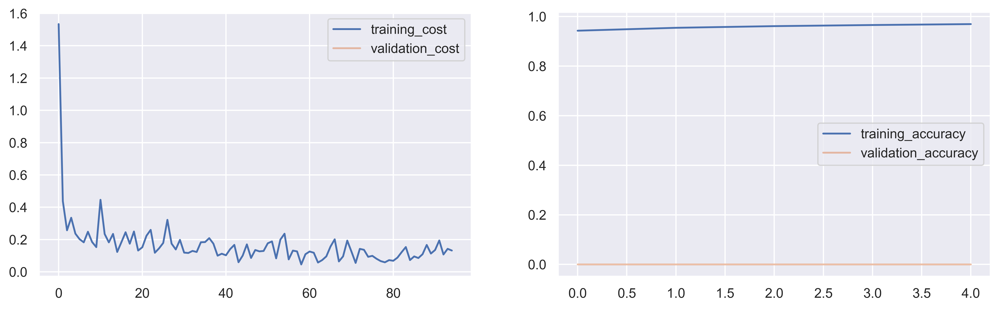

initial_cost:  3.3436  initial_acc:  0.0884
epoch_0  --> cost_train:  0.317789 train_acc:  0.9442  -- cost_val:  0  val_acc:  0  ==> grads:  0.00685
epoch_1  --> cost_train:  0.240297 train_acc:  0.9554  -- cost_val:  0  val_acc:  0  ==> grads:  0.00642
epoch_2  --> cost_train:  0.204382 train_acc:  0.9609  -- cost_val:  0  val_acc:  0  ==> grads:  0.0045
epoch_3  --> cost_train:  0.18427 train_acc:  0.9653  -- cost_val:  0  val_acc:  0  ==> grads:  0.0062
epoch_4  --> cost_train:  0.171833 train_acc:  0.9688  -- cost_val:  0  val_acc:  0  ==> grads:  0.00756


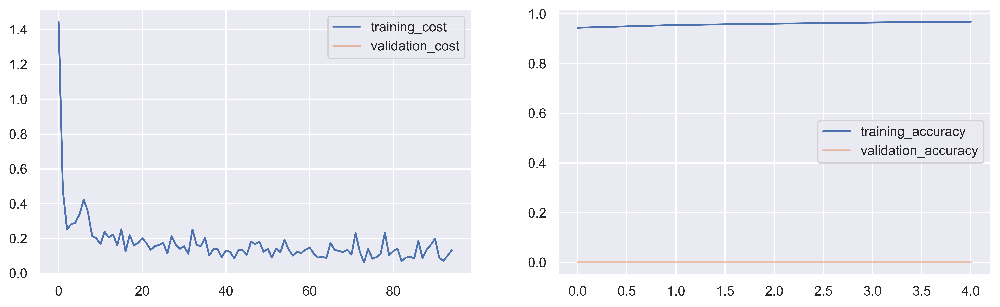

initial_cost:  3.1548  initial_acc:  0.1109
epoch_0  --> cost_train:  0.303837 train_acc:  0.943  -- cost_val:  0  val_acc:  0  ==> grads:  0.00634
epoch_1  --> cost_train:  0.240987 train_acc:  0.9538  -- cost_val:  0  val_acc:  0  ==> grads:  0.00557
epoch_2  --> cost_train:  0.207407 train_acc:  0.9597  -- cost_val:  0  val_acc:  0  ==> grads:  0.00285
epoch_3  --> cost_train:  0.190068 train_acc:  0.9642  -- cost_val:  0  val_acc:  0  ==> grads:  0.00681
epoch_4  --> cost_train:  0.174675 train_acc:  0.9674  -- cost_val:  0  val_acc:  0  ==> grads:  0.00485


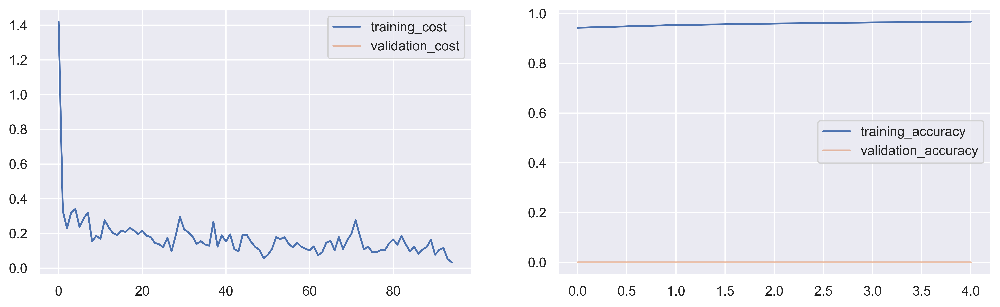

initial_cost:  3.1816  initial_acc:  0.1041
epoch_0  --> cost_train:  0.309289 train_acc:  0.9424  -- cost_val:  0  val_acc:  0  ==> grads:  0.0084
epoch_1  --> cost_train:  0.245453 train_acc:  0.9538  -- cost_val:  0  val_acc:  0  ==> grads:  0.00534
epoch_2  --> cost_train:  0.209405 train_acc:  0.9601  -- cost_val:  0  val_acc:  0  ==> grads:  0.00496
epoch_3  --> cost_train:  0.188911 train_acc:  0.9633  -- cost_val:  0  val_acc:  0  ==> grads:  0.00603
epoch_4  --> cost_train:  0.172552 train_acc:  0.9672  -- cost_val:  0  val_acc:  0  ==> grads:  0.00722


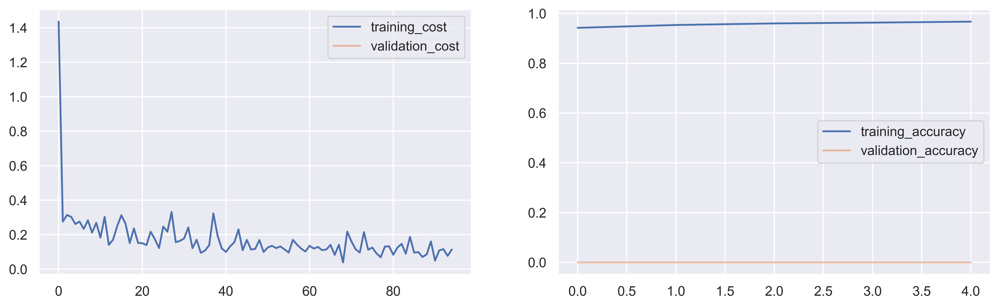

initial_cost:  3.2295  initial_acc:  0.0921
epoch_0  --> cost_train:  0.301853 train_acc:  0.943  -- cost_val:  0  val_acc:  0  ==> grads:  0.0074
epoch_1  --> cost_train:  0.238561 train_acc:  0.9547  -- cost_val:  0  val_acc:  0  ==> grads:  0.00622
epoch_2  --> cost_train:  0.20267 train_acc:  0.9609  -- cost_val:  0  val_acc:  0  ==> grads:  0.00538
epoch_3  --> cost_train:  0.182743 train_acc:  0.9649  -- cost_val:  0  val_acc:  0  ==> grads:  0.00416
epoch_4  --> cost_train:  0.171125 train_acc:  0.9684  -- cost_val:  0  val_acc:  0  ==> grads:  0.0054


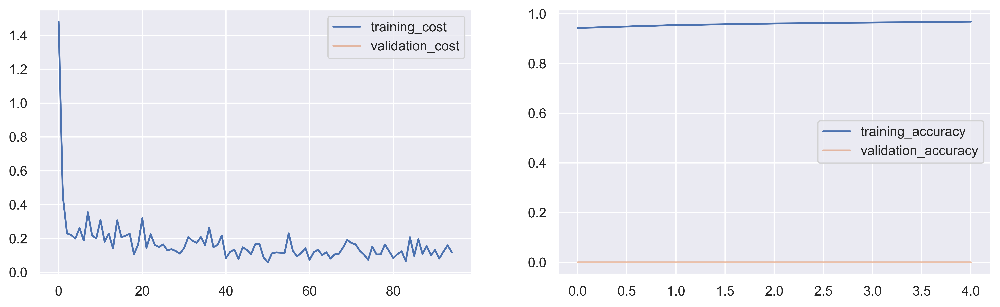

initial_cost:  3.193  initial_acc:  0.1
epoch_0  --> cost_train:  0.319358 train_acc:  0.9419  -- cost_val:  0  val_acc:  0  ==> grads:  0.00785
epoch_1  --> cost_train:  0.252887 train_acc:  0.9545  -- cost_val:  0  val_acc:  0  ==> grads:  0.00823
epoch_2  --> cost_train:  0.21694 train_acc:  0.9605  -- cost_val:  0  val_acc:  0  ==> grads:  0.00425
epoch_3  --> cost_train:  0.195676 train_acc:  0.9645  -- cost_val:  0  val_acc:  0  ==> grads:  0.00642
epoch_4  --> cost_train:  0.18052 train_acc:  0.9679  -- cost_val:  0  val_acc:  0  ==> grads:  0.00342


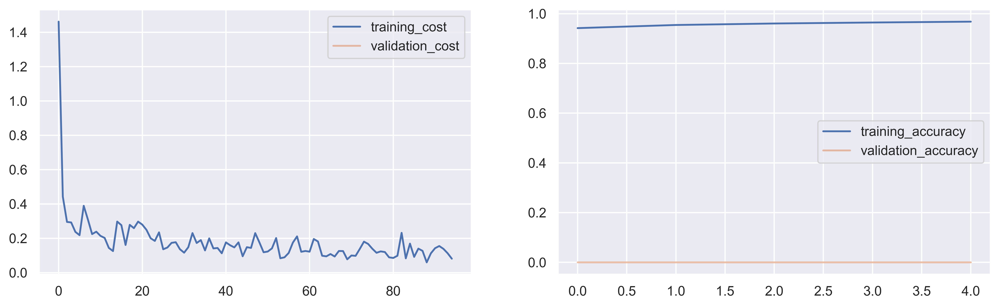

initial_cost:  3.0989  initial_acc:  0.0895
epoch_0  --> cost_train:  0.321358 train_acc:  0.943  -- cost_val:  0  val_acc:  0  ==> grads:  0.00713
epoch_1  --> cost_train:  0.244861 train_acc:  0.9553  -- cost_val:  0  val_acc:  0  ==> grads:  0.00803
epoch_2  --> cost_train:  0.210254 train_acc:  0.9611  -- cost_val:  0  val_acc:  0  ==> grads:  0.00806
epoch_3  --> cost_train:  0.188774 train_acc:  0.9654  -- cost_val:  0  val_acc:  0  ==> grads:  0.00481
epoch_4  --> cost_train:  0.17416 train_acc:  0.9684  -- cost_val:  0  val_acc:  0  ==> grads:  0.00528


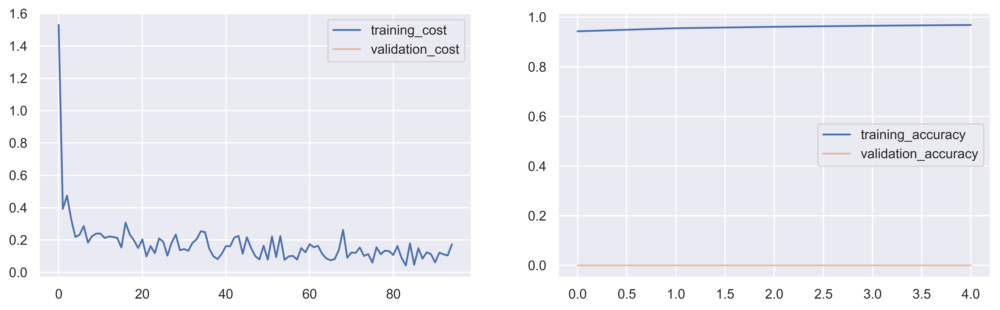

initial_cost:  3.0682  initial_acc:  0.1041
epoch_0  --> cost_train:  0.289374 train_acc:  0.9449  -- cost_val:  0  val_acc:  0  ==> grads:  0.00521
epoch_1  --> cost_train:  0.227 train_acc:  0.9555  -- cost_val:  0  val_acc:  0  ==> grads:  0.00699
epoch_2  --> cost_train:  0.194418 train_acc:  0.9616  -- cost_val:  0  val_acc:  0  ==> grads:  0.004
epoch_3  --> cost_train:  0.174042 train_acc:  0.966  -- cost_val:  0  val_acc:  0  ==> grads:  0.00694
epoch_4  --> cost_train:  0.161774 train_acc:  0.969  -- cost_val:  0  val_acc:  0  ==> grads:  0.00431


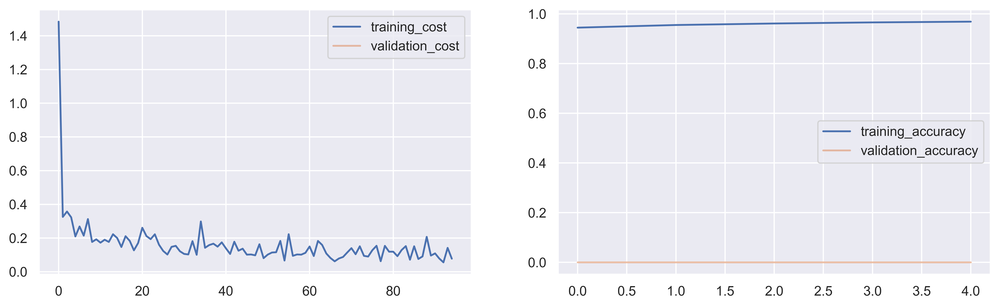

initial_cost:  3.1778  initial_acc:  0.1157
epoch_0  --> cost_train:  0.308321 train_acc:  0.9439  -- cost_val:  0  val_acc:  0  ==> grads:  0.00749
epoch_1  --> cost_train:  0.238455 train_acc:  0.9548  -- cost_val:  0  val_acc:  0  ==> grads:  0.00621
epoch_2  --> cost_train:  0.211377 train_acc:  0.9612  -- cost_val:  0  val_acc:  0  ==> grads:  0.00806
epoch_3  --> cost_train:  0.194591 train_acc:  0.9647  -- cost_val:  0  val_acc:  0  ==> grads:  0.00374
epoch_4  --> cost_train:  0.178083 train_acc:  0.9682  -- cost_val:  0  val_acc:  0  ==> grads:  0.00522


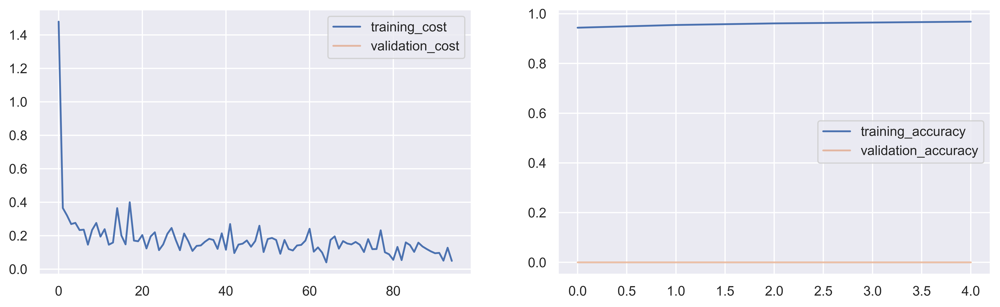

initial_cost:  3.2512  initial_acc:  0.0956
epoch_0  --> cost_train:  0.285811 train_acc:  0.9428  -- cost_val:  0  val_acc:  0  ==> grads:  0.00764
epoch_1  --> cost_train:  0.224616 train_acc:  0.9513  -- cost_val:  0  val_acc:  0  ==> grads:  0.00776
epoch_2  --> cost_train:  0.197118 train_acc:  0.9587  -- cost_val:  0  val_acc:  0  ==> grads:  0.00462
epoch_3  --> cost_train:  0.180557 train_acc:  0.9635  -- cost_val:  0  val_acc:  0  ==> grads:  0.00552
epoch_4  --> cost_train:  0.169594 train_acc:  0.9668  -- cost_val:  0  val_acc:  0  ==> grads:  0.00396


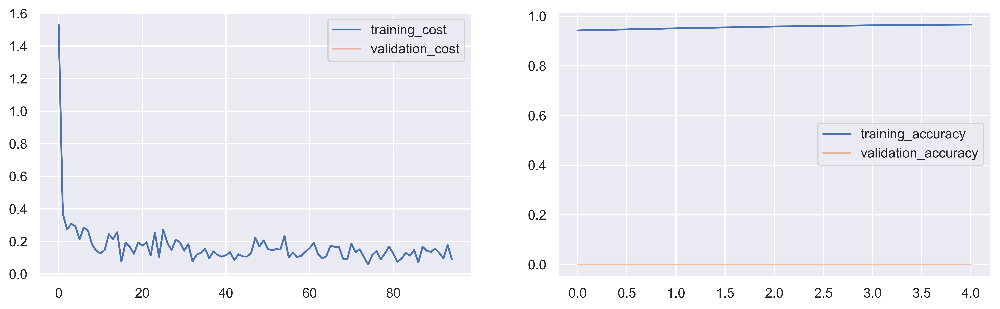

initial_cost:  3.0896  initial_acc:  0.1018
epoch_0  --> cost_train:  0.306658 train_acc:  0.9429  -- cost_val:  0  val_acc:  0  ==> grads:  0.00996
epoch_1  --> cost_train:  0.234224 train_acc:  0.9532  -- cost_val:  0  val_acc:  0  ==> grads:  0.0053
epoch_2  --> cost_train:  0.204212 train_acc:  0.9602  -- cost_val:  0  val_acc:  0  ==> grads:  0.00705
epoch_3  --> cost_train:  0.183926 train_acc:  0.9646  -- cost_val:  0  val_acc:  0  ==> grads:  0.00525
epoch_4  --> cost_train:  0.171031 train_acc:  0.967  -- cost_val:  0  val_acc:  0  ==> grads:  0.00615


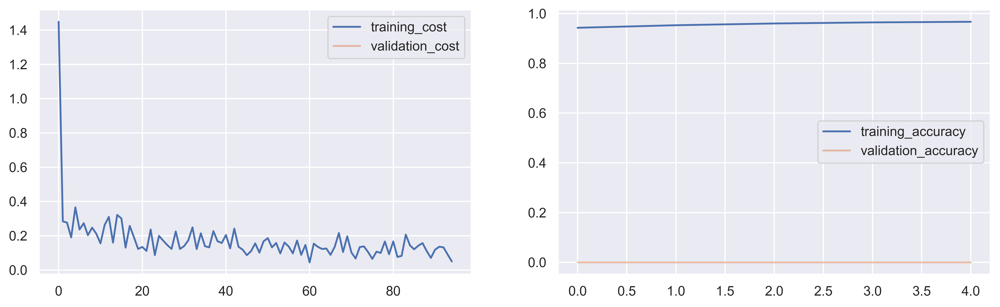

initial_cost:  3.3084  initial_acc:  0.0744
epoch_0  --> cost_train:  0.318105 train_acc:  0.9425  -- cost_val:  0  val_acc:  0  ==> grads:  0.00589
epoch_1  --> cost_train:  0.246353 train_acc:  0.9548  -- cost_val:  0  val_acc:  0  ==> grads:  0.00579
epoch_2  --> cost_train:  0.211777 train_acc:  0.9604  -- cost_val:  0  val_acc:  0  ==> grads:  0.00413
epoch_3  --> cost_train:  0.189199 train_acc:  0.9646  -- cost_val:  0  val_acc:  0  ==> grads:  0.00603
epoch_4  --> cost_train:  0.176368 train_acc:  0.9673  -- cost_val:  0  val_acc:  0  ==> grads:  0.00375


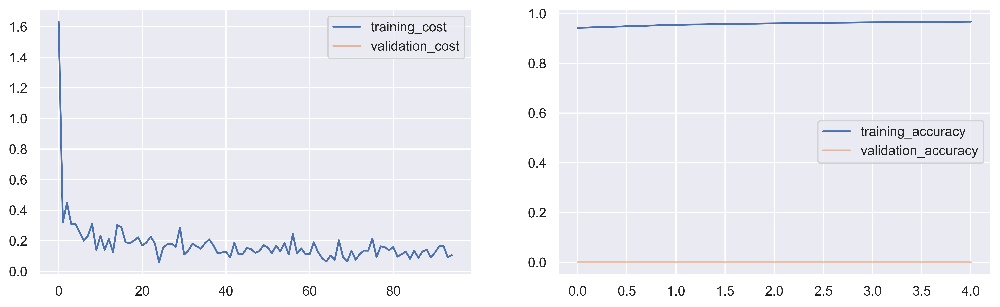

initial_cost:  3.0433  initial_acc:  0.0968
epoch_0  --> cost_train:  0.3148 train_acc:  0.9438  -- cost_val:  0  val_acc:  0  ==> grads:  0.00562
epoch_1  --> cost_train:  0.244934 train_acc:  0.9532  -- cost_val:  0  val_acc:  0  ==> grads:  0.00742
epoch_2  --> cost_train:  0.208244 train_acc:  0.9599  -- cost_val:  0  val_acc:  0  ==> grads:  0.00564
epoch_3  --> cost_train:  0.188791 train_acc:  0.9641  -- cost_val:  0  val_acc:  0  ==> grads:  0.00397
epoch_4  --> cost_train:  0.175777 train_acc:  0.9674  -- cost_val:  0  val_acc:  0  ==> grads:  0.00514


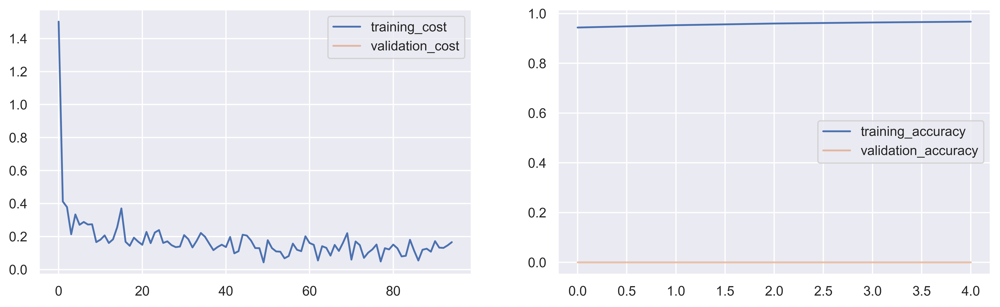

initial_cost:  3.1125  initial_acc:  0.0915
epoch_0  --> cost_train:  0.319805 train_acc:  0.941  -- cost_val:  0  val_acc:  0  ==> grads:  0.00614
epoch_1  --> cost_train:  0.246324 train_acc:  0.9522  -- cost_val:  0  val_acc:  0  ==> grads:  0.00545
epoch_2  --> cost_train:  0.213947 train_acc:  0.9588  -- cost_val:  0  val_acc:  0  ==> grads:  0.00641
epoch_3  --> cost_train:  0.194649 train_acc:  0.9629  -- cost_val:  0  val_acc:  0  ==> grads:  0.00661
epoch_4  --> cost_train:  0.179164 train_acc:  0.9664  -- cost_val:  0  val_acc:  0  ==> grads:  0.00646


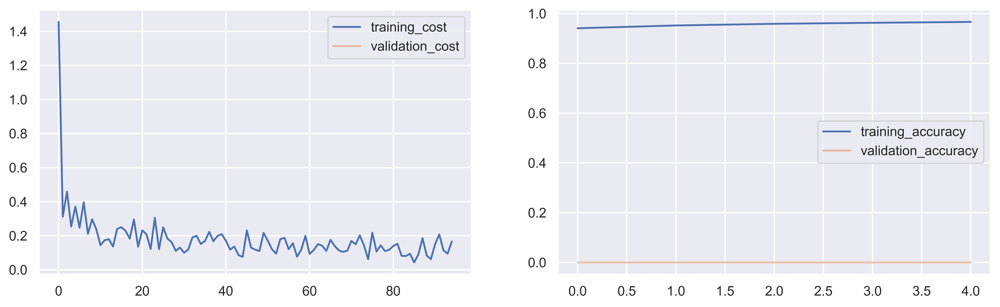

initial_cost:  3.234  initial_acc:  0.0966
epoch_0  --> cost_train:  0.319868 train_acc:  0.944  -- cost_val:  0  val_acc:  0  ==> grads:  0.00876
epoch_1  --> cost_train:  0.240334 train_acc:  0.9551  -- cost_val:  0  val_acc:  0  ==> grads:  0.00846
epoch_2  --> cost_train:  0.207665 train_acc:  0.961  -- cost_val:  0  val_acc:  0  ==> grads:  0.00584
epoch_3  --> cost_train:  0.186512 train_acc:  0.9659  -- cost_val:  0  val_acc:  0  ==> grads:  0.00572
epoch_4  --> cost_train:  0.170319 train_acc:  0.9685  -- cost_val:  0  val_acc:  0  ==> grads:  0.00487


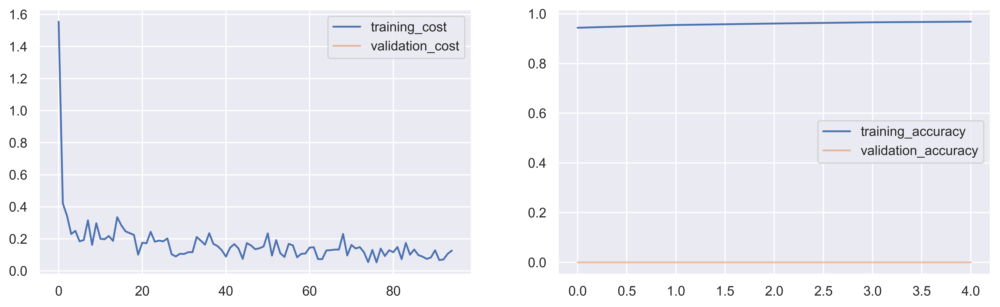

initial_cost:  3.2613  initial_acc:  0.1129
epoch_0  --> cost_train:  0.322432 train_acc:  0.9424  -- cost_val:  0  val_acc:  0  ==> grads:  0.00646
epoch_1  --> cost_train:  0.246782 train_acc:  0.9545  -- cost_val:  0  val_acc:  0  ==> grads:  0.00548
epoch_2  --> cost_train:  0.214463 train_acc:  0.9606  -- cost_val:  0  val_acc:  0  ==> grads:  0.00544
epoch_3  --> cost_train:  0.192111 train_acc:  0.965  -- cost_val:  0  val_acc:  0  ==> grads:  0.00524
epoch_4  --> cost_train:  0.176114 train_acc:  0.9682  -- cost_val:  0  val_acc:  0  ==> grads:  0.00477


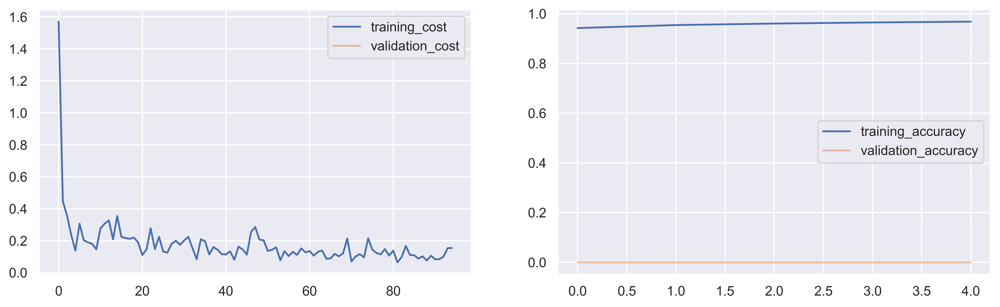

In [25]:
trials = 20
losses = []
for t in range(trials):
    nn_madam_drop = NN_madam(size_h_layer=(X__.shape[1], 256,256, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.0001, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(1, (0,0.5,0.5)),
                              optimizer=('madam',{'beta1':0.9, 'beta2':0.999}),
                              print_=1, plots=1)
    nn_madam_drop.train_nn(X__, y__, epochs= 5, batch_size=128, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_madam_drop.tr_batch_cost)

In [26]:
madam_mnist = losses.copy()

In [27]:
madam_costs = np.zeros((len(madam_mnist[0]), len(madam_mnist)))
for i in range(len(madam_mnist)):
    madam_costs[:,i] = madam_mnist[i]

### Adam testing on MNIST

initial_cost:  3.2014  initial_acc:  0.101
epoch_0  --> cost_train:  0.477505 train_acc:  0.9247  -- cost_val:  0  val_acc:  0  ==> grads:  0.01099
epoch_1  --> cost_train:  0.366679 train_acc:  0.9382  -- cost_val:  0  val_acc:  0  ==> grads:  0.00785
epoch_2  --> cost_train:  0.31056 train_acc:  0.9454  -- cost_val:  0  val_acc:  0  ==> grads:  0.00899
epoch_3  --> cost_train:  0.272183 train_acc:  0.9508  -- cost_val:  0  val_acc:  0  ==> grads:  0.00819
epoch_4  --> cost_train:  0.249409 train_acc:  0.9543  -- cost_val:  0  val_acc:  0  ==> grads:  0.00799


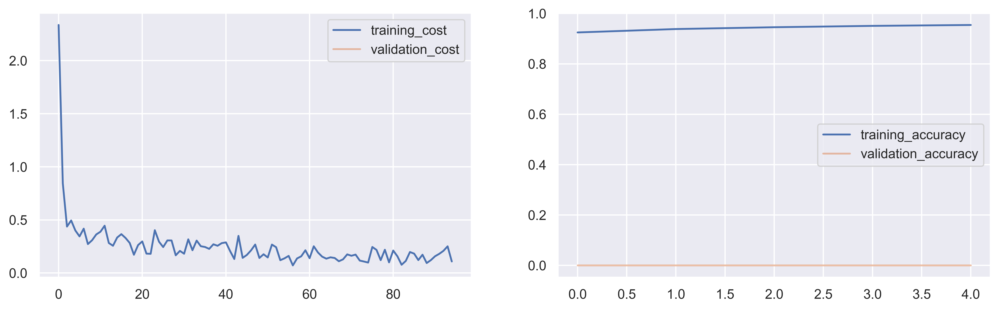

initial_cost:  3.1402  initial_acc:  0.1003
epoch_0  --> cost_train:  0.444995 train_acc:  0.9274  -- cost_val:  0  val_acc:  0  ==> grads:  0.01083
epoch_1  --> cost_train:  0.343268 train_acc:  0.94  -- cost_val:  0  val_acc:  0  ==> grads:  0.00794
epoch_2  --> cost_train:  0.296704 train_acc:  0.9462  -- cost_val:  0  val_acc:  0  ==> grads:  0.00801
epoch_3  --> cost_train:  0.269121 train_acc:  0.9512  -- cost_val:  0  val_acc:  0  ==> grads:  0.00496
epoch_4  --> cost_train:  0.246182 train_acc:  0.9551  -- cost_val:  0  val_acc:  0  ==> grads:  0.0065


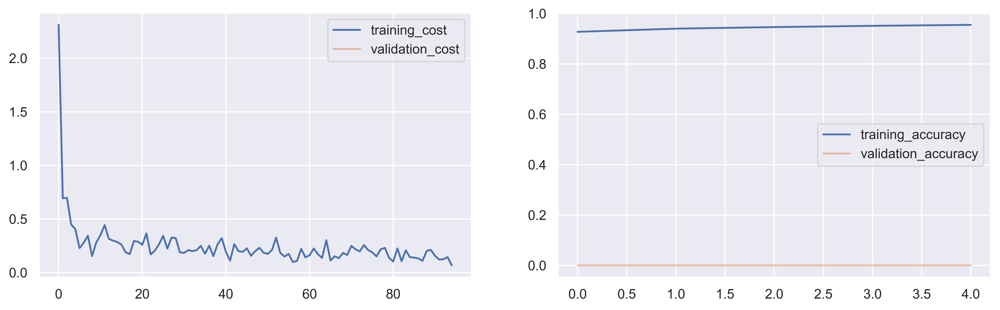

initial_cost:  3.2951  initial_acc:  0.0996
epoch_0  --> cost_train:  0.480332 train_acc:  0.9253  -- cost_val:  0  val_acc:  0  ==> grads:  0.00854
epoch_1  --> cost_train:  0.351611 train_acc:  0.9383  -- cost_val:  0  val_acc:  0  ==> grads:  0.00703
epoch_2  --> cost_train:  0.301305 train_acc:  0.9453  -- cost_val:  0  val_acc:  0  ==> grads:  0.00808
epoch_3  --> cost_train:  0.270068 train_acc:  0.9508  -- cost_val:  0  val_acc:  0  ==> grads:  0.00748
epoch_4  --> cost_train:  0.249285 train_acc:  0.9544  -- cost_val:  0  val_acc:  0  ==> grads:  0.00504


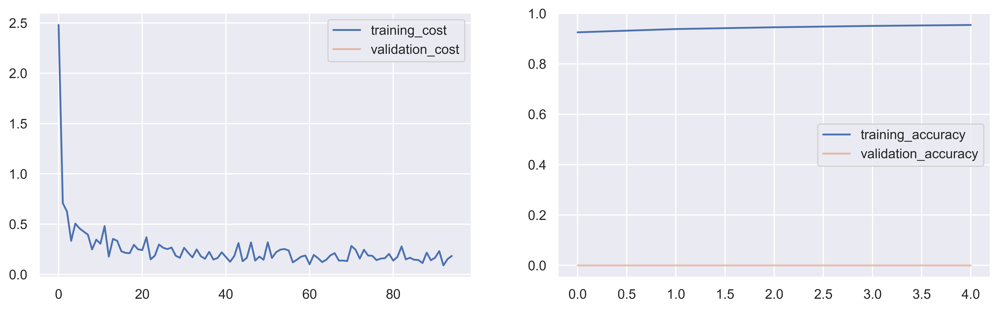

initial_cost:  3.0654  initial_acc:  0.1112
epoch_0  --> cost_train:  0.444974 train_acc:  0.9281  -- cost_val:  0  val_acc:  0  ==> grads:  0.00909
epoch_1  --> cost_train:  0.327587 train_acc:  0.9396  -- cost_val:  0  val_acc:  0  ==> grads:  0.00824
epoch_2  --> cost_train:  0.286798 train_acc:  0.9475  -- cost_val:  0  val_acc:  0  ==> grads:  0.00641
epoch_3  --> cost_train:  0.255213 train_acc:  0.9521  -- cost_val:  0  val_acc:  0  ==> grads:  0.00673
epoch_4  --> cost_train:  0.235315 train_acc:  0.9557  -- cost_val:  0  val_acc:  0  ==> grads:  0.00675


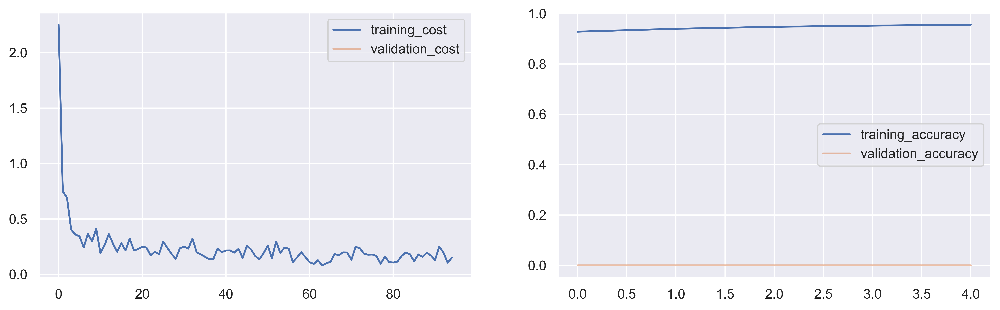

initial_cost:  3.2776  initial_acc:  0.0889
epoch_0  --> cost_train:  0.458921 train_acc:  0.9268  -- cost_val:  0  val_acc:  0  ==> grads:  0.00935
epoch_1  --> cost_train:  0.338432 train_acc:  0.9392  -- cost_val:  0  val_acc:  0  ==> grads:  0.00803
epoch_2  --> cost_train:  0.293775 train_acc:  0.9462  -- cost_val:  0  val_acc:  0  ==> grads:  0.00976
epoch_3  --> cost_train:  0.2638 train_acc:  0.9509  -- cost_val:  0  val_acc:  0  ==> grads:  0.00663
epoch_4  --> cost_train:  0.245374 train_acc:  0.9547  -- cost_val:  0  val_acc:  0  ==> grads:  0.00536


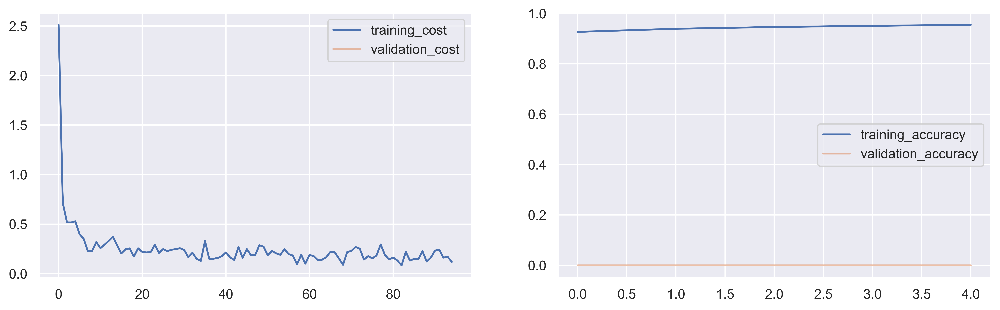

initial_cost:  3.3049  initial_acc:  0.0957
epoch_0  --> cost_train:  0.470332 train_acc:  0.9283  -- cost_val:  0  val_acc:  0  ==> grads:  0.00974
epoch_1  --> cost_train:  0.339032 train_acc:  0.9395  -- cost_val:  0  val_acc:  0  ==> grads:  0.00904
epoch_2  --> cost_train:  0.298419 train_acc:  0.9464  -- cost_val:  0  val_acc:  0  ==> grads:  0.00839
epoch_3  --> cost_train:  0.266805 train_acc:  0.9503  -- cost_val:  0  val_acc:  0  ==> grads:  0.00715
epoch_4  --> cost_train:  0.244204 train_acc:  0.9545  -- cost_val:  0  val_acc:  0  ==> grads:  0.00472


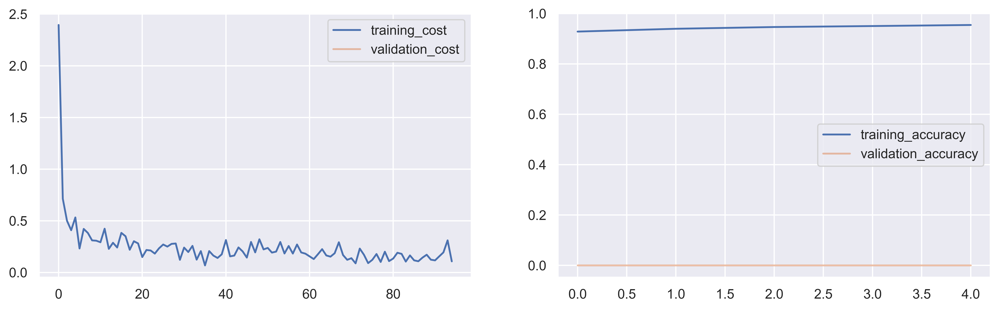

initial_cost:  3.2528  initial_acc:  0.1012
epoch_0  --> cost_train:  0.495137 train_acc:  0.9274  -- cost_val:  0  val_acc:  0  ==> grads:  0.009
epoch_1  --> cost_train:  0.361155 train_acc:  0.9388  -- cost_val:  0  val_acc:  0  ==> grads:  0.00823
epoch_2  --> cost_train:  0.303763 train_acc:  0.9467  -- cost_val:  0  val_acc:  0  ==> grads:  0.00899
epoch_3  --> cost_train:  0.266639 train_acc:  0.9516  -- cost_val:  0  val_acc:  0  ==> grads:  0.00688
epoch_4  --> cost_train:  0.247135 train_acc:  0.9552  -- cost_val:  0  val_acc:  0  ==> grads:  0.00758


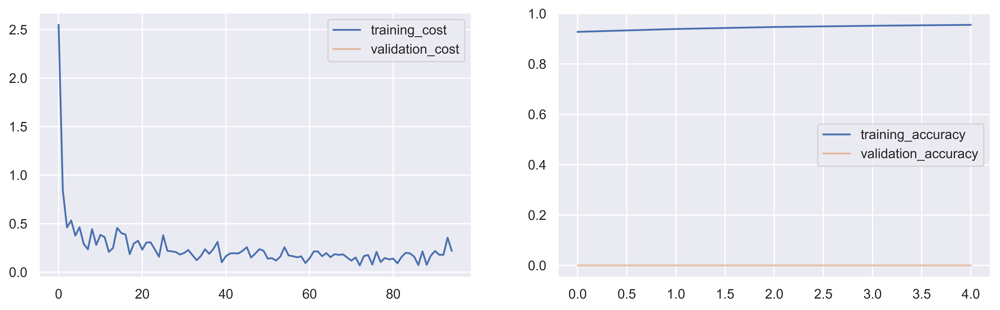

initial_cost:  3.1655  initial_acc:  0.0913
epoch_0  --> cost_train:  0.451142 train_acc:  0.9264  -- cost_val:  0  val_acc:  0  ==> grads:  0.01228
epoch_1  --> cost_train:  0.341105 train_acc:  0.9381  -- cost_val:  0  val_acc:  0  ==> grads:  0.00698
epoch_2  --> cost_train:  0.298163 train_acc:  0.9462  -- cost_val:  0  val_acc:  0  ==> grads:  0.00709
epoch_3  --> cost_train:  0.266091 train_acc:  0.9515  -- cost_val:  0  val_acc:  0  ==> grads:  0.0068
epoch_4  --> cost_train:  0.244354 train_acc:  0.9547  -- cost_val:  0  val_acc:  0  ==> grads:  0.0061


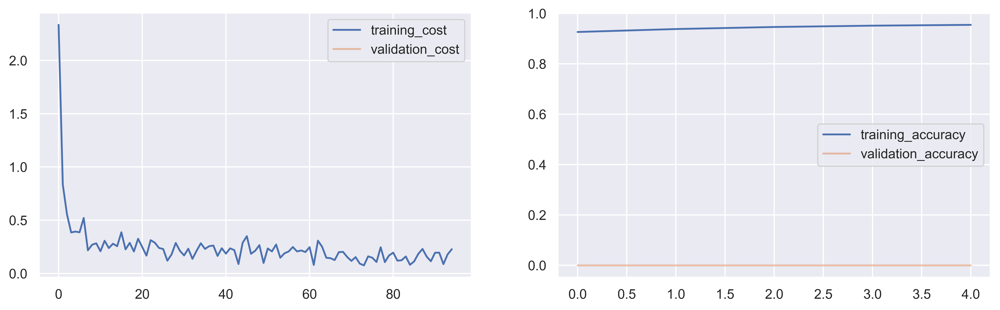

initial_cost:  3.1378  initial_acc:  0.1013
epoch_0  --> cost_train:  0.475126 train_acc:  0.9267  -- cost_val:  0  val_acc:  0  ==> grads:  0.00948
epoch_1  --> cost_train:  0.344537 train_acc:  0.9394  -- cost_val:  0  val_acc:  0  ==> grads:  0.00654
epoch_2  --> cost_train:  0.291205 train_acc:  0.9462  -- cost_val:  0  val_acc:  0  ==> grads:  0.00723
epoch_3  --> cost_train:  0.263828 train_acc:  0.9511  -- cost_val:  0  val_acc:  0  ==> grads:  0.00684
epoch_4  --> cost_train:  0.242999 train_acc:  0.955  -- cost_val:  0  val_acc:  0  ==> grads:  0.0034


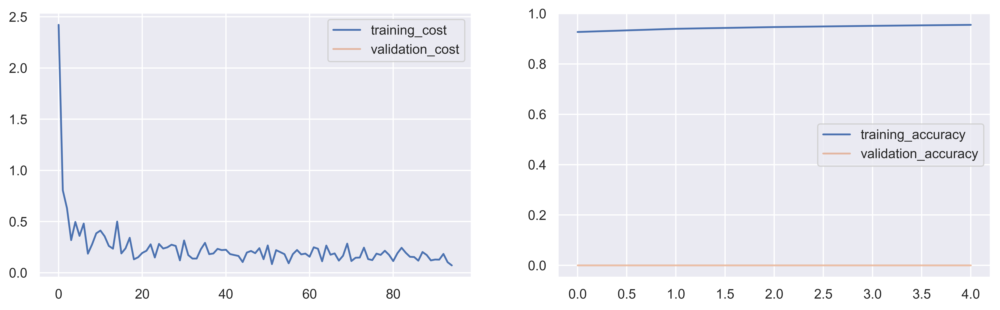

initial_cost:  3.0099  initial_acc:  0.1077
epoch_0  --> cost_train:  0.480768 train_acc:  0.9277  -- cost_val:  0  val_acc:  0  ==> grads:  0.0083
epoch_1  --> cost_train:  0.370079 train_acc:  0.9392  -- cost_val:  0  val_acc:  0  ==> grads:  0.0093
epoch_2  --> cost_train:  0.310519 train_acc:  0.9468  -- cost_val:  0  val_acc:  0  ==> grads:  0.01053
epoch_3  --> cost_train:  0.278034 train_acc:  0.9513  -- cost_val:  0  val_acc:  0  ==> grads:  0.00762
epoch_4  --> cost_train:  0.252544 train_acc:  0.9542  -- cost_val:  0  val_acc:  0  ==> grads:  0.00602


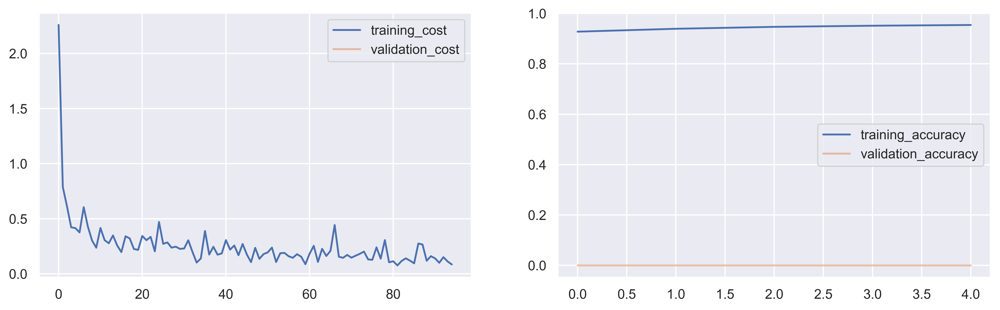

initial_cost:  3.079  initial_acc:  0.1009
epoch_0  --> cost_train:  0.456863 train_acc:  0.9264  -- cost_val:  0  val_acc:  0  ==> grads:  0.00929
epoch_1  --> cost_train:  0.342334 train_acc:  0.9389  -- cost_val:  0  val_acc:  0  ==> grads:  0.00789
epoch_2  --> cost_train:  0.29333 train_acc:  0.946  -- cost_val:  0  val_acc:  0  ==> grads:  0.00805
epoch_3  --> cost_train:  0.263701 train_acc:  0.9504  -- cost_val:  0  val_acc:  0  ==> grads:  0.00702
epoch_4  --> cost_train:  0.242953 train_acc:  0.9549  -- cost_val:  0  val_acc:  0  ==> grads:  0.00684


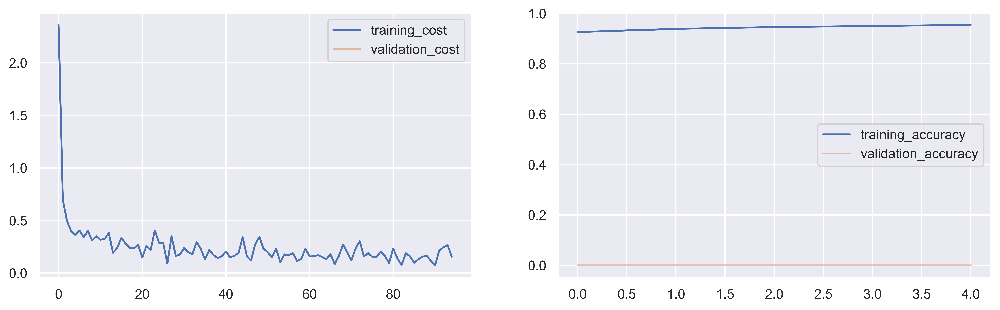

initial_cost:  3.0764  initial_acc:  0.1008
epoch_0  --> cost_train:  0.437758 train_acc:  0.927  -- cost_val:  0  val_acc:  0  ==> grads:  0.00821
epoch_1  --> cost_train:  0.330734 train_acc:  0.9399  -- cost_val:  0  val_acc:  0  ==> grads:  0.00694
epoch_2  --> cost_train:  0.278961 train_acc:  0.9466  -- cost_val:  0  val_acc:  0  ==> grads:  0.00633
epoch_3  --> cost_train:  0.252466 train_acc:  0.9516  -- cost_val:  0  val_acc:  0  ==> grads:  0.00985
epoch_4  --> cost_train:  0.230451 train_acc:  0.9548  -- cost_val:  0  val_acc:  0  ==> grads:  0.00742


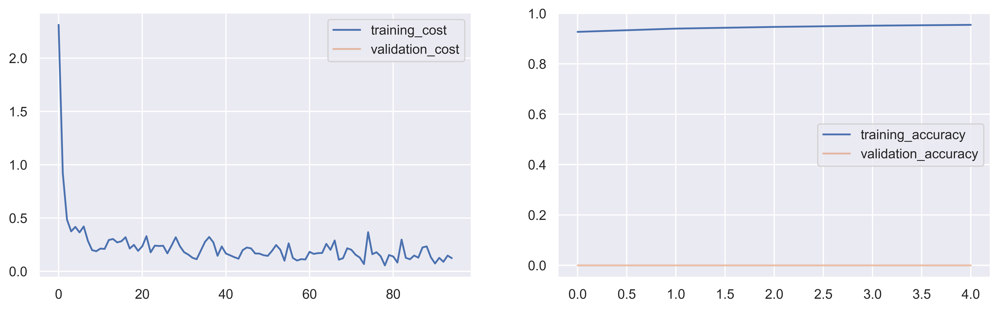

initial_cost:  3.2785  initial_acc:  0.0904
epoch_0  --> cost_train:  0.474921 train_acc:  0.9263  -- cost_val:  0  val_acc:  0  ==> grads:  0.01091
epoch_1  --> cost_train:  0.345942 train_acc:  0.9388  -- cost_val:  0  val_acc:  0  ==> grads:  0.00839
epoch_2  --> cost_train:  0.301623 train_acc:  0.9457  -- cost_val:  0  val_acc:  0  ==> grads:  0.00848
epoch_3  --> cost_train:  0.271196 train_acc:  0.9509  -- cost_val:  0  val_acc:  0  ==> grads:  0.00772
epoch_4  --> cost_train:  0.248409 train_acc:  0.954  -- cost_val:  0  val_acc:  0  ==> grads:  0.00654


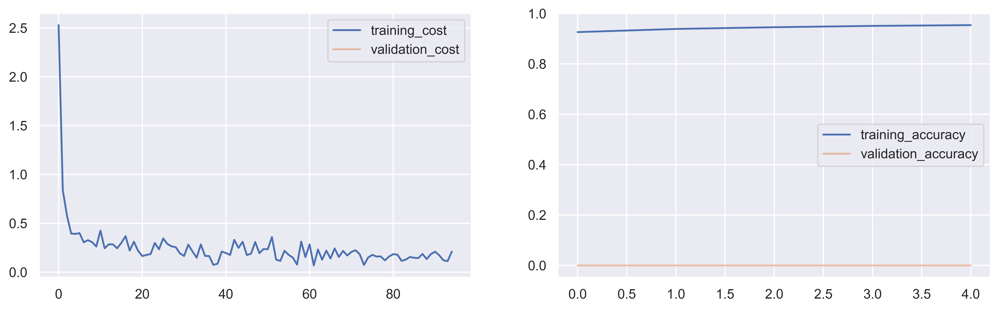

initial_cost:  3.1034  initial_acc:  0.0916
epoch_0  --> cost_train:  0.454047 train_acc:  0.926  -- cost_val:  0  val_acc:  0  ==> grads:  0.01155
epoch_1  --> cost_train:  0.344155 train_acc:  0.9386  -- cost_val:  0  val_acc:  0  ==> grads:  0.00998
epoch_2  --> cost_train:  0.293519 train_acc:  0.9459  -- cost_val:  0  val_acc:  0  ==> grads:  0.01517
epoch_3  --> cost_train:  0.267124 train_acc:  0.9504  -- cost_val:  0  val_acc:  0  ==> grads:  0.00579
epoch_4  --> cost_train:  0.244891 train_acc:  0.9538  -- cost_val:  0  val_acc:  0  ==> grads:  0.00652


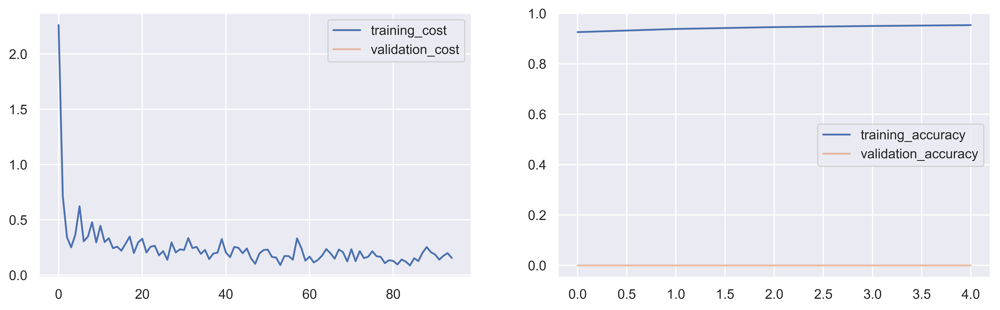

initial_cost:  3.1619  initial_acc:  0.1015
epoch_0  --> cost_train:  0.486016 train_acc:  0.9251  -- cost_val:  0  val_acc:  0  ==> grads:  0.01047
epoch_1  --> cost_train:  0.351374 train_acc:  0.9402  -- cost_val:  0  val_acc:  0  ==> grads:  0.00939
epoch_2  --> cost_train:  0.302309 train_acc:  0.9466  -- cost_val:  0  val_acc:  0  ==> grads:  0.00851
epoch_3  --> cost_train:  0.274033 train_acc:  0.9514  -- cost_val:  0  val_acc:  0  ==> grads:  0.00894
epoch_4  --> cost_train:  0.249455 train_acc:  0.9545  -- cost_val:  0  val_acc:  0  ==> grads:  0.00569


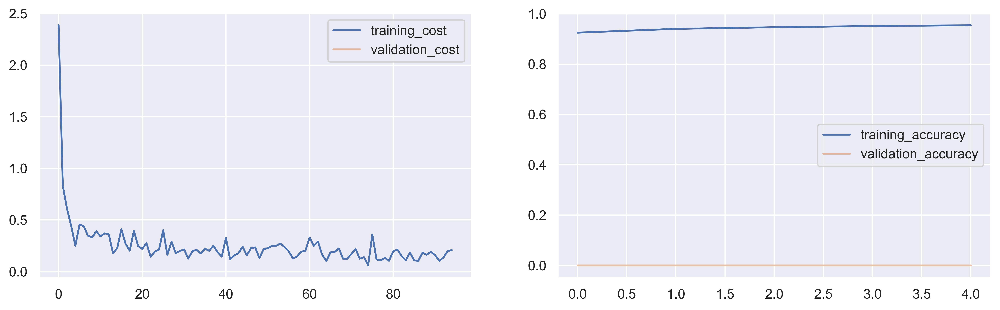

initial_cost:  3.1349  initial_acc:  0.0904
epoch_0  --> cost_train:  0.431179 train_acc:  0.9261  -- cost_val:  0  val_acc:  0  ==> grads:  0.01225
epoch_1  --> cost_train:  0.322521 train_acc:  0.9401  -- cost_val:  0  val_acc:  0  ==> grads:  0.00834
epoch_2  --> cost_train:  0.276282 train_acc:  0.9456  -- cost_val:  0  val_acc:  0  ==> grads:  0.006
epoch_3  --> cost_train:  0.246301 train_acc:  0.9507  -- cost_val:  0  val_acc:  0  ==> grads:  0.00999
epoch_4  --> cost_train:  0.228205 train_acc:  0.9551  -- cost_val:  0  val_acc:  0  ==> grads:  0.01063


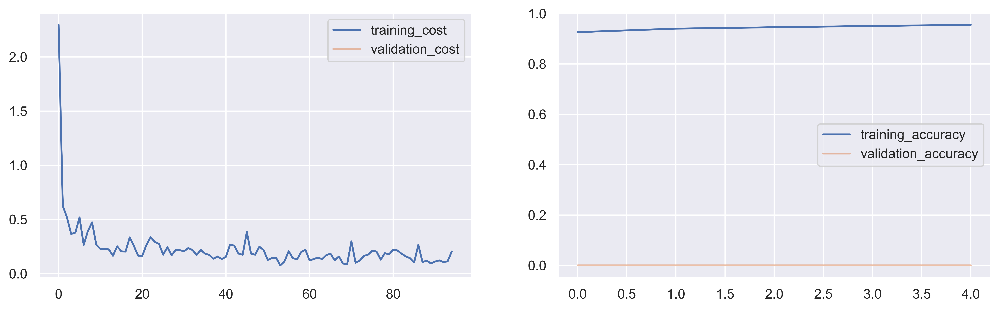

initial_cost:  3.1865  initial_acc:  0.1066
epoch_0  --> cost_train:  0.445416 train_acc:  0.9255  -- cost_val:  0  val_acc:  0  ==> grads:  0.00998
epoch_1  --> cost_train:  0.335911 train_acc:  0.938  -- cost_val:  0  val_acc:  0  ==> grads:  0.0098
epoch_2  --> cost_train:  0.292579 train_acc:  0.945  -- cost_val:  0  val_acc:  0  ==> grads:  0.00769
epoch_3  --> cost_train:  0.262022 train_acc:  0.9495  -- cost_val:  0  val_acc:  0  ==> grads:  0.00768
epoch_4  --> cost_train:  0.24194 train_acc:  0.9538  -- cost_val:  0  val_acc:  0  ==> grads:  0.00908


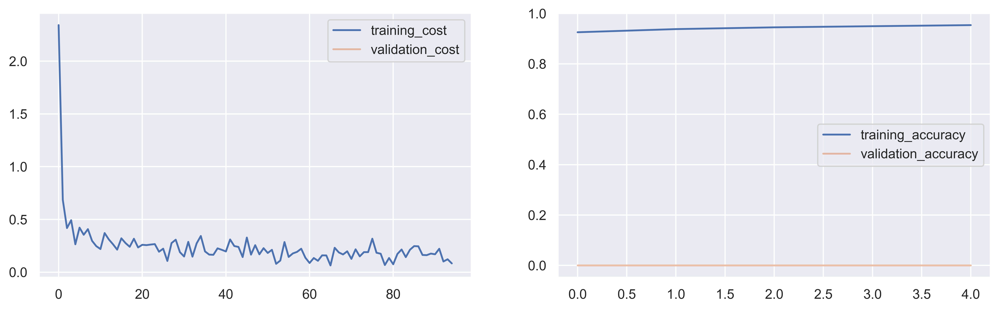

initial_cost:  3.3387  initial_acc:  0.0963
epoch_0  --> cost_train:  0.441437 train_acc:  0.9269  -- cost_val:  0  val_acc:  0  ==> grads:  0.00802
epoch_1  --> cost_train:  0.332987 train_acc:  0.939  -- cost_val:  0  val_acc:  0  ==> grads:  0.00822
epoch_2  --> cost_train:  0.286295 train_acc:  0.9469  -- cost_val:  0  val_acc:  0  ==> grads:  0.00827
epoch_3  --> cost_train:  0.256879 train_acc:  0.9519  -- cost_val:  0  val_acc:  0  ==> grads:  0.00676
epoch_4  --> cost_train:  0.238306 train_acc:  0.9551  -- cost_val:  0  val_acc:  0  ==> grads:  0.01117


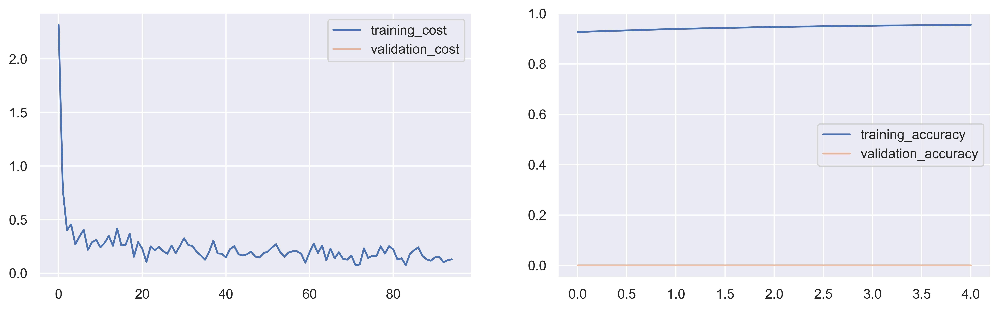

initial_cost:  3.2359  initial_acc:  0.0898
epoch_0  --> cost_train:  0.473858 train_acc:  0.9278  -- cost_val:  0  val_acc:  0  ==> grads:  0.00945
epoch_1  --> cost_train:  0.343797 train_acc:  0.9398  -- cost_val:  0  val_acc:  0  ==> grads:  0.0093
epoch_2  --> cost_train:  0.2865 train_acc:  0.9473  -- cost_val:  0  val_acc:  0  ==> grads:  0.01052
epoch_3  --> cost_train:  0.25465 train_acc:  0.9524  -- cost_val:  0  val_acc:  0  ==> grads:  0.0082
epoch_4  --> cost_train:  0.231638 train_acc:  0.9551  -- cost_val:  0  val_acc:  0  ==> grads:  0.01058


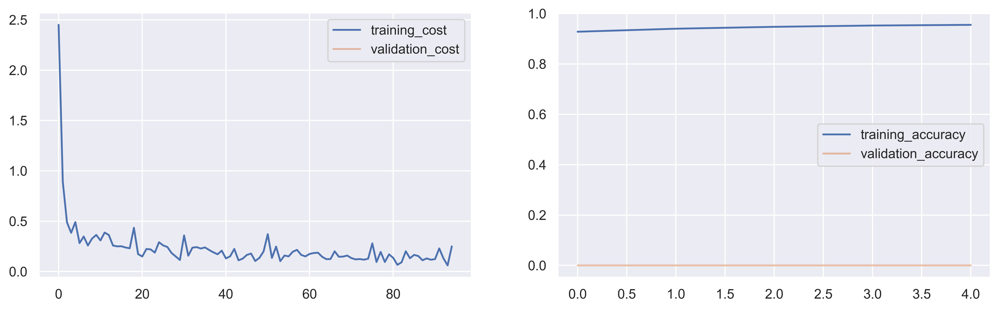

initial_cost:  3.2739  initial_acc:  0.1058
epoch_0  --> cost_train:  0.448205 train_acc:  0.927  -- cost_val:  0  val_acc:  0  ==> grads:  0.01035
epoch_1  --> cost_train:  0.344458 train_acc:  0.9392  -- cost_val:  0  val_acc:  0  ==> grads:  0.00732
epoch_2  --> cost_train:  0.302288 train_acc:  0.9463  -- cost_val:  0  val_acc:  0  ==> grads:  0.0056
epoch_3  --> cost_train:  0.266428 train_acc:  0.9508  -- cost_val:  0  val_acc:  0  ==> grads:  0.0083
epoch_4  --> cost_train:  0.246996 train_acc:  0.9546  -- cost_val:  0  val_acc:  0  ==> grads:  0.00735


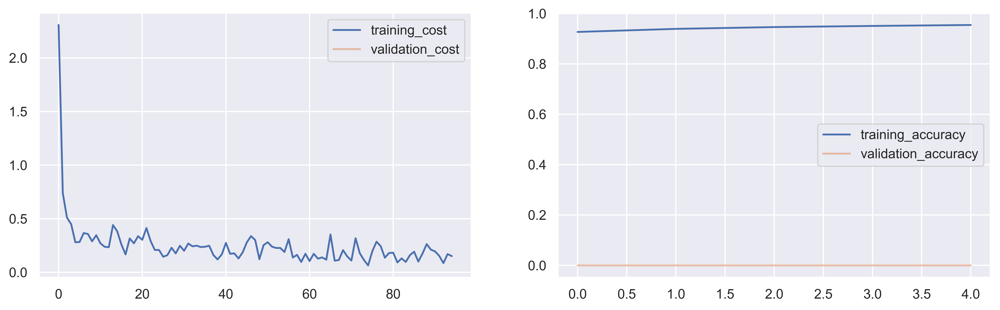

In [28]:
trials = 20
losses = []
for t in range(trials):
    nn_adam_drop = NN_madam(size_h_layer=(X__.shape[1], 256,256, len(np.unique(y__))), 
                              activation_h='ReLU', activation_o='softmax', initialization='truncnorm',
                              l_rate= 0.0001, l_decay=0.95, bias= 1 , l2_reg= 0.0, dropout=(1, (0,0.5,0.5)),
                              optimizer=('adam',{'beta1':0.9, 'beta2':0.999}),
                              print_=1, plots=1)
    nn_adam_drop.train_nn(X__, y__, epochs= 5, batch_size=128, nr_shuffles=1, cval=None, grads_stopping=True)
    losses.append(nn_adam_drop.tr_batch_cost)

In [29]:
adam_mnist = losses.copy()

In [30]:
adam_costs = np.zeros((len(adam_mnist[0]), len(adam_mnist)))
for i in range(len(adam_mnist)):
    adam_costs[:,i] = adam_mnist[i]

### Results on MNIST with Dropout

In [39]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 100

Text(0.5, 1.0, 'MNIST with Dropout - Avg losses over 20 x 5 epochs trials (batch=128)')

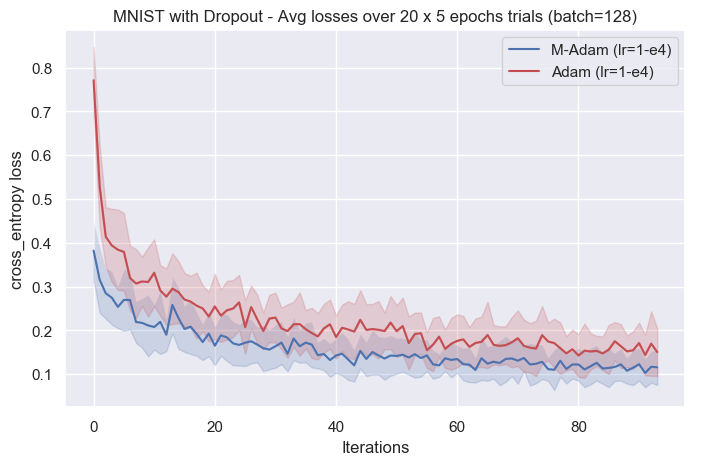

In [40]:
plt.figure(figsize=(8,5))
start = 1
plt.plot(madam_costs.mean(axis=1)[start:], 'b')
plt.fill_between(np.arange(len(madam_costs.mean(axis=1)[start:])), madam_costs.mean(axis=1)[start:], madam_costs.mean(axis=1)[start:] + madam_costs.std(axis=1)[start:], alpha=0.2)
plt.fill_between(np.arange(len(madam_costs.mean(axis=1)[start:])), madam_costs.mean(axis=1)[start:], madam_costs.mean(axis=1)[start:] - madam_costs.std(axis=1)[start:], alpha=0.2,color='b')


plt.plot(adam_costs.mean(axis=1)[1:], 'r')
plt.fill_between(np.arange(len(adam_costs.mean(axis=1)[start:])), adam_costs.mean(axis=1)[start:], adam_costs.mean(axis=1)[start:] + adam_costs.std(axis=1)[start:], alpha=0.2,color='r')
plt.fill_between(np.arange(len(adam_costs.mean(axis=1)[start:])), adam_costs.mean(axis=1)[start:], adam_costs.mean(axis=1)[start:] - adam_costs.std(axis=1)[start:], alpha=0.2,color='r')
plt.legend(['M-Adam (lr=1-e4)', 'Adam (lr=1-e4)'])
plt.xlabel('Iterations', size=12)
plt.ylabel('cross_entropy loss', size=12)
plt.title('MNIST with Dropout - Avg losses over 20 x 5 epochs trials (batch=128)', size=12)
